### Importing Basic Libraries

In [76]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')
import chardet

In [77]:
## Using chardet to know the what type of encoding present in data
with open('/content/Walmart DataSet.csv', 'rb') as file:
    result = chardet.detect(file.read())
    print(result)

{'encoding': 'ascii', 'confidence': 1.0, 'language': ''}


In [78]:
df = pd.read_csv('/content/Walmart DataSet.csv', encoding='ascii')
df.head()

,Store,Date,Weekly_Sales,Holiday_Flag,Temperature,Fuel_Price,CPI,Unemployment
0,1,05-02-2010,1643690.90,0,42.31,2.572,211.096358,8.106
1,1,12-02-2010,1641957.44,1,38.51,2.548,211.242170,8.106
2,1,19-02-2010,1611968.17,0,39.93,2.514,211.289143,8.106
3,1,26-02-2010,1409727.59,0,46.63,2.561,211.319643,8.106
4,1,05-03-2010,1554806.68,0,46.50,2.625,211.350143,8.106


In [79]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6435 entries, 0 to 6434
Data columns (total 8 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   Store         6435 non-null   int64  
 1   Date          6435 non-null   object 
 2   Weekly_Sales  6435 non-null   float64
 3   Holiday_Flag  6435 non-null   int64  
 4   Temperature   6435 non-null   float64
 5   Fuel_Price    6435 non-null   float64
 6   CPI           6435 non-null   float64
 7   Unemployment  6435 non-null   float64
dtypes: float64(5), int64(2), object(1)
memory usage: 402.3+ KB


###Information about data
* As per the data information there are no null values
* Need to change the dtype of date from object to datetime

### Checking sales per store

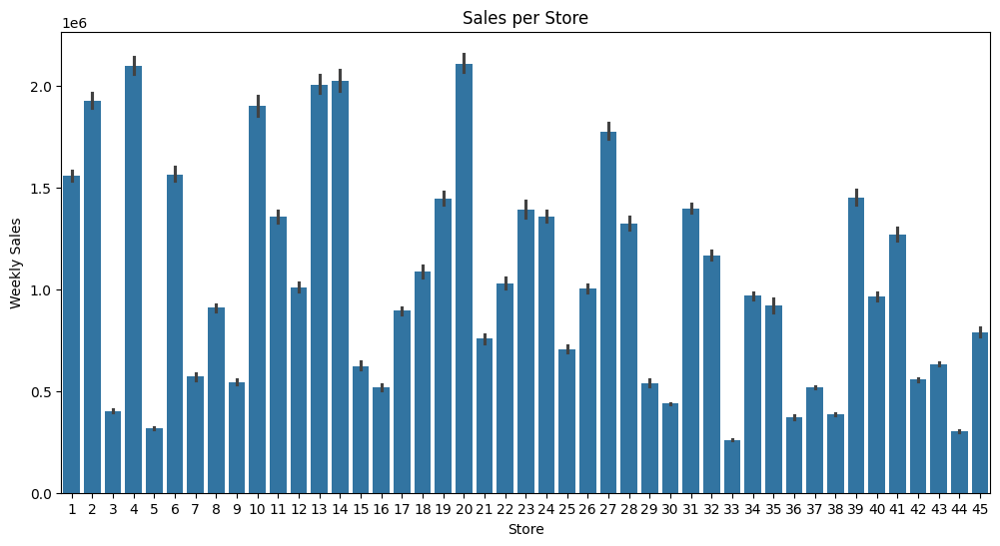

In [80]:
plt.figure(figsize=(12, 6))
sns.barplot(x='Store', y='Weekly_Sales', data=df)
plt.title('Sales per Store')
plt.xlabel('Store')
plt.ylabel('Weekly Sales')
plt.show()

* Here Store 4 and 20 performing very high comparing to other stores

In [81]:
df['Date'] = pd.to_datetime(df['Date'], dayfirst=True)


In [82]:
df['Date']

,Date
0,2010-02-05
1,2010-02-12
2,2010-02-19
3,2010-02-26
4,2010-03-05
...,...
6430,2012-09-28
6431,2012-10-05
6432,2012-10-12
6433,2012-10-19


In [83]:
store_id = int(input('Enter the Store id: '))
store_data = df[df['Store'] == store_id]
store_data.head()

Enter the Store id: 3


,Store,Date,Weekly_Sales,Holiday_Flag,Temperature,Fuel_Price,CPI,Unemployment
286,3,2010-02-05,461622.22,0,45.71,2.572,214.424881,7.368
287,3,2010-02-12,420728.96,1,47.93,2.548,214.574792,7.368
288,3,2010-02-19,421642.19,0,47.07,2.514,214.619887,7.368
289,3,2010-02-26,407204.86,0,52.05,2.561,214.647513,7.368
290,3,2010-03-05,415202.04,0,53.04,2.625,214.675139,7.368


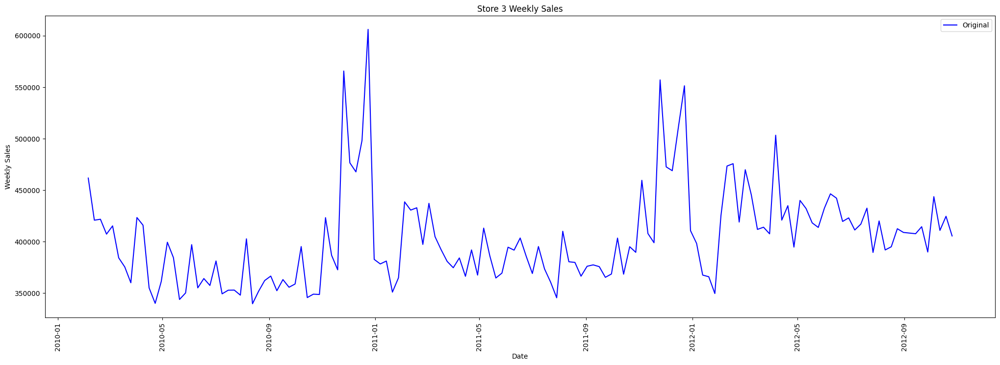

In [84]:
plt.figure(figsize=(25, 8))
plt.plot(store_data['Date'], store_data['Weekly_Sales'], label = 'Original', color='blue')
# filled_mean = store_data['Weekly_Sales'].fillna(store_data['Weekly_Sales'].mean())
# plt.plot(store_data['Date'], filled_mean, label='Filled with Mean', color='red', linestyle='--')
# filled_median = store_data['Weekly_Sales'].fillna(store_data['Weekly_Sales'].median())
# plt.plot(store_data['Date'], filled_median, label='Filled with Median', color='green', linestyle='--')
# filled_interpole = store_data['Weekly_Sales'].interpolate()
# plt.plot(store_data['Date'], filled_interpole, label='Filled with Interpolate', color='orange', linestyle='--')
plt.legend()
plt.title(f'Store {store_id} Weekly Sales')
plt.xlabel('Date')
plt.ylabel('Weekly Sales')
plt.xticks(rotation=90)
plt.show()

In [85]:
df = df.sort_values(['Store','Date'])

In [86]:
range = pd.date_range(start = df['Date'].min(), end=df['Date'].max(), freq='W-FRI')
store_ids = df['Store'].unique()
full_index = pd.MultiIndex.from_product([store_ids, range], names=['Store', 'Date'])
missing = range.difference(df['Date'])
print(missing)
df1 = df.set_index(['Store', 'Date'])
df1 = df1.reindex(full_index)
# df['Weekly_Sales'] = df['Weekly_Sales'].interpolate()
# df = df.reset_index()

DatetimeIndex([], dtype='datetime64[ns]', freq='W-FRI')


In [87]:
df1

Weekly_Sales  Holiday_Flag  Temperature  Fuel_Price  \
Store Date                                                              
1     2010-02-05    1643690.90             0        42.31       2.572   
      2010-02-12    1641957.44             1        38.51       2.548   
      2010-02-19    1611968.17             0        39.93       2.514   
      2010-02-26    1409727.59             0        46.63       2.561   
      2010-03-05    1554806.68             0        46.50       2.625   
...                        ...           ...          ...         ...   
45    2012-09-28     713173.95             0        64.88       3.997   
      2012-10-05     733455.07             0        64.89       3.985   
      2012-10-12     734464.36             0        54.47       4.000   
      2012-10-19     718125.53             0        56.47       3.969   
      2012-10-26     760281.43             0        58.85       3.882   

                         CPI  Unemployment  
Store Date                                  
1     2010-02-05  211.096358         8.106  
      2010-02-12  211.242170         8.106  
      2010-02-19  211.289143         8.106  
      2010-02-26  211.319643         8.106  
      2010-03-05  211.350143         8.106  
...                      ...           ...  
45    2012-09-28  192.013558         8.684  
      2012-10-05  192.170412         8.667  
      2012-10-12  192.327265         8.667  
      2012-10-19  192.330854         8.667  
      2012-10-26  192.308899         8.667  

[6435 rows x 6 columns]

In [88]:
df1.isnull().sum()

,0
Weekly_Sales,0
Holiday_Flag,0
Temperature,0
Fuel_Price,0
CPI,0
Unemployment,0


* Here there is no any missing weekly dates

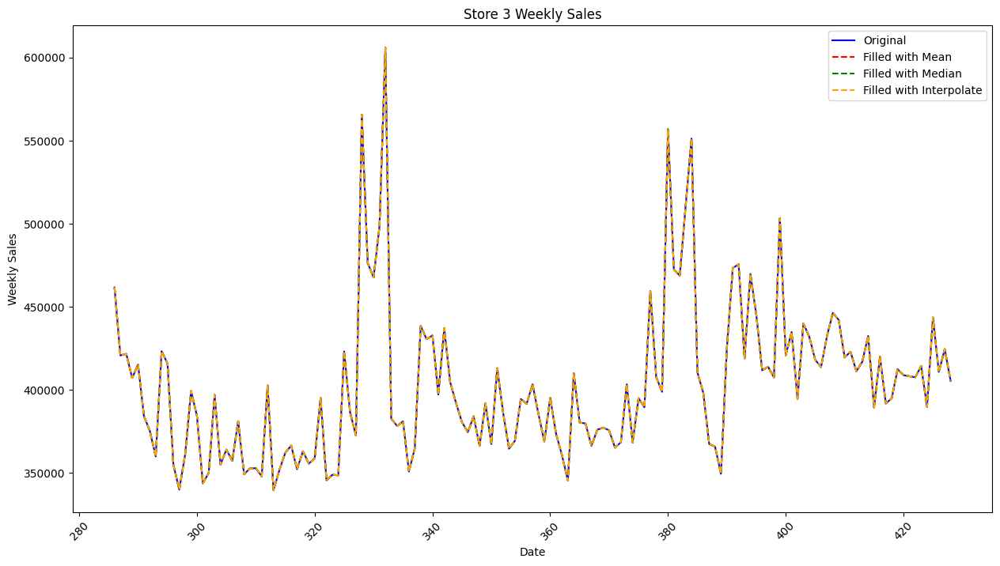

In [89]:
## If there are null dates it helps what immilation need to perform

plt.figure(figsize=(15, 8))
plt.plot(store_data['Weekly_Sales'], label = 'Original', color='blue')
filled_mean = store_data['Weekly_Sales'].fillna(store_data['Weekly_Sales'].mean())
plt.plot(filled_mean, label='Filled with Mean', color='red', linestyle='--')
filled_median = store_data['Weekly_Sales'].fillna(store_data['Weekly_Sales'].median())
plt.plot(filled_median, label='Filled with Median', color='green', linestyle='--')
filled_interpole = store_data['Weekly_Sales'].interpolate()
plt.plot(filled_interpole, label='Filled with Interpolate', color='orange', linestyle='--')
plt.legend()
plt.title(f'Store {store_id} Weekly Sales')
plt.xlabel('Date')
plt.ylabel('Weekly Sales')
plt.xticks(rotation=45)
plt.show()

In [90]:
df.describe()

,Store,Date,Weekly_Sales,Holiday_Flag,Temperature,Fuel_Price,CPI,Unemployment
count,6435.000000,6435,6.435000e+03,6435.000000,6435.000000,6435.000000,6435.000000,6435.000000
mean,23.000000,2011-06-17 00:00:00,1.046965e+06,0.069930,60.663782,3.358607,171.578394,7.999151
min,1.000000,2010-02-05 00:00:00,2.099862e+05,0.000000,-2.060000,2.472000,126.064000,3.879000
25%,12.000000,2010-10-08 00:00:00,5.533501e+05,0.000000,47.460000,2.933000,131.735000,6.891000
50%,23.000000,2011-06-17 00:00:00,9.607460e+05,0.000000,62.670000,3.445000,182.616521,7.874000
75%,34.000000,2012-02-24 00:00:00,1.420159e+06,0.000000,74.940000,3.735000,212.743293,8.622000
max,45.000000,2012-10-26 00:00:00,3.818686e+06,1.000000,100.140000,4.468000,227.232807,14.313000
std,12.988182,NaN,5.643666e+05,0.255049,18.444933,0.459020,39.356712,1.875885


### EDA Process

In [91]:
df.isnull().sum()

,0
Store,0
Date,0
Weekly_Sales,0
Holiday_Flag,0
Temperature,0
Fuel_Price,0
CPI,0
Unemployment,0


In [92]:
df.duplicated().sum()

np.int64(0)

In [93]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6435 entries, 0 to 6434
Data columns (total 8 columns):
 #   Column        Non-Null Count  Dtype         
---  ------        --------------  -----         
 0   Store         6435 non-null   int64         
 1   Date          6435 non-null   datetime64[ns]
 2   Weekly_Sales  6435 non-null   float64       
 3   Holiday_Flag  6435 non-null   int64         
 4   Temperature   6435 non-null   float64       
 5   Fuel_Price    6435 non-null   float64       
 6   CPI           6435 non-null   float64       
 7   Unemployment  6435 non-null   float64       
dtypes: datetime64[ns](1), float64(5), int64(2)
memory usage: 402.3 KB


###Checking for outliers

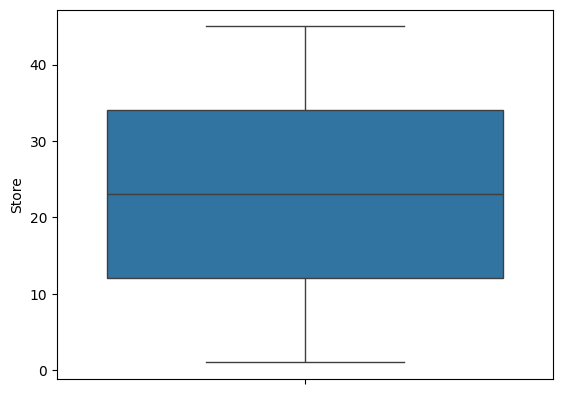

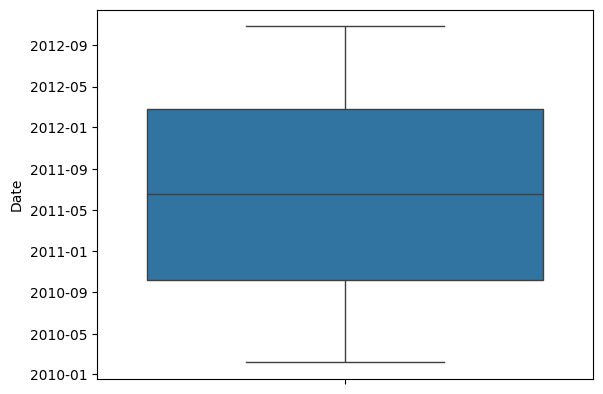

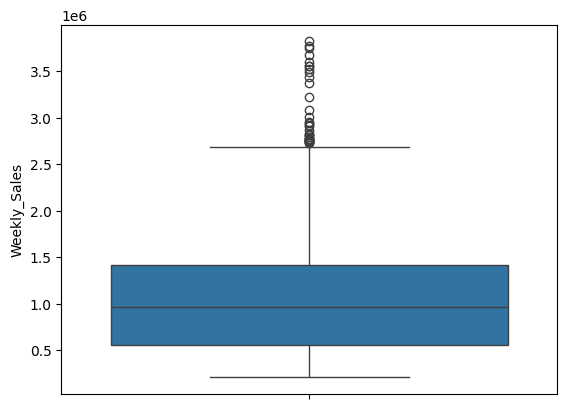

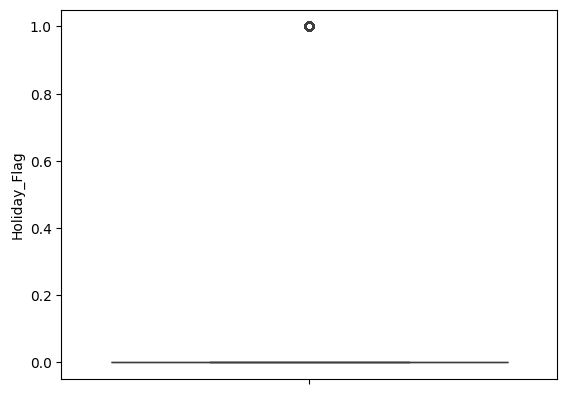

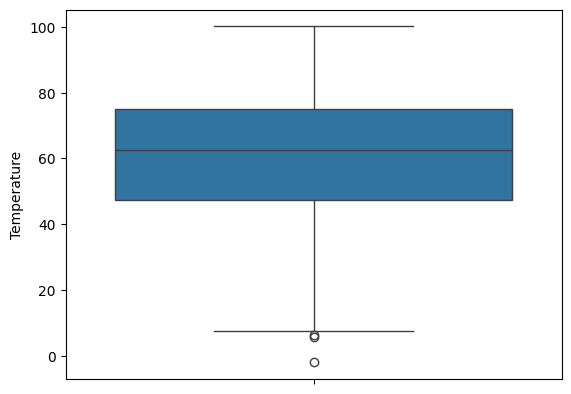

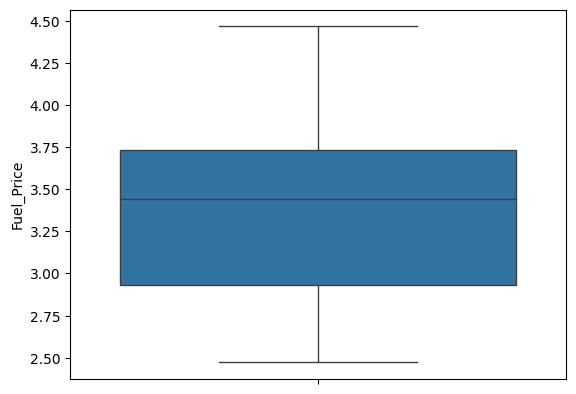

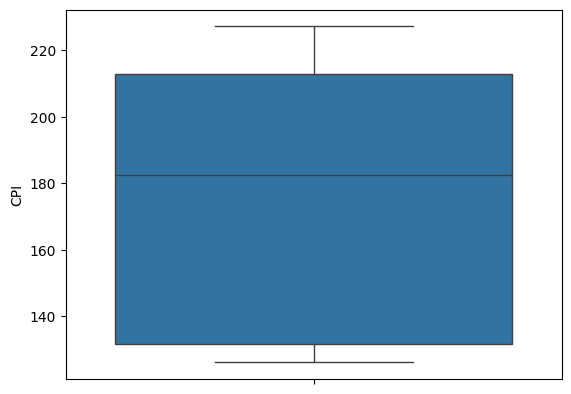

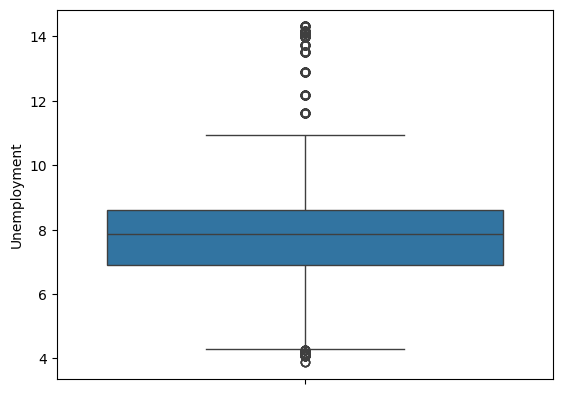

In [94]:
for i in df.columns:
  if df[i].dtype != 'datetime[ns]':
    sns.boxplot(df[i])
    plt.show()

### If the weekly sales are affected by the unemployment rate, if yes - which stores are suffering the most?

In [95]:
correlation = df['Weekly_Sales'].corr(df['Unemployment'])
correlation

np.float64(-0.10617608965795429)

In [96]:
store_data.dtypes

,0
Store,int64
Date,datetime64[ns]
Weekly_Sales,float64
Holiday_Flag,int64
Temperature,float64
Fuel_Price,float64
CPI,float64
Unemployment,float64


<Axes: >

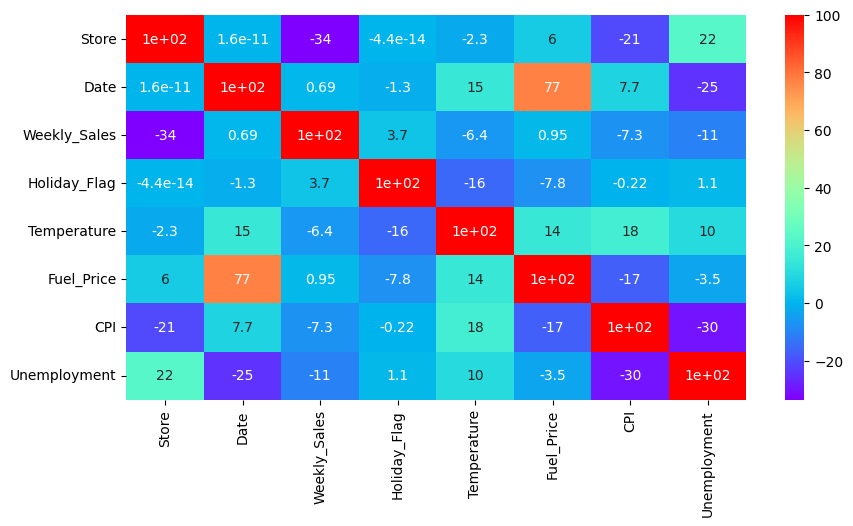

In [97]:
plt.figure(figsize=(10, 5))
sns.heatmap(df.corr()*100, annot = True, cmap='rainbow')

* Here in the corelation, As we see in the relationship between Weekly_sales and Unemployeement is -11, which is negative means there is no correlation between two, So we can that weekly sales are independent to Unployment

Store 1 Correlation: -0.0979553947295795


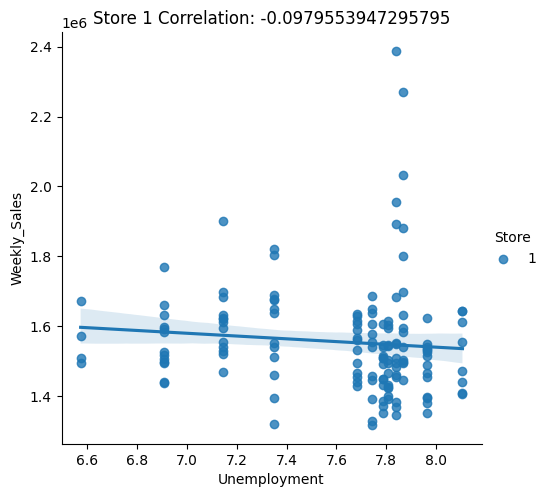

Store 2 Correlation: 0.06632485967770846


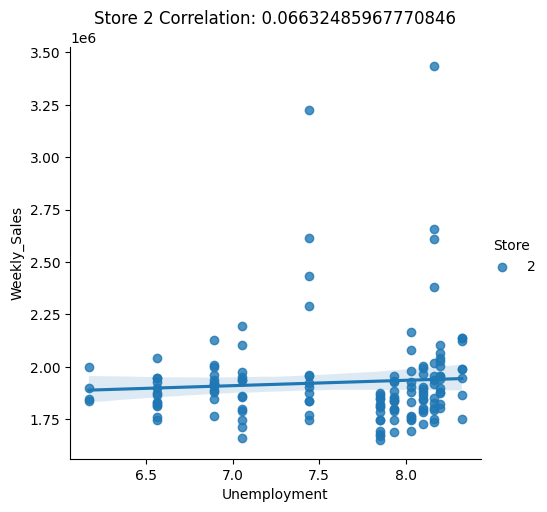

Store 3 Correlation: -0.2304130134863526


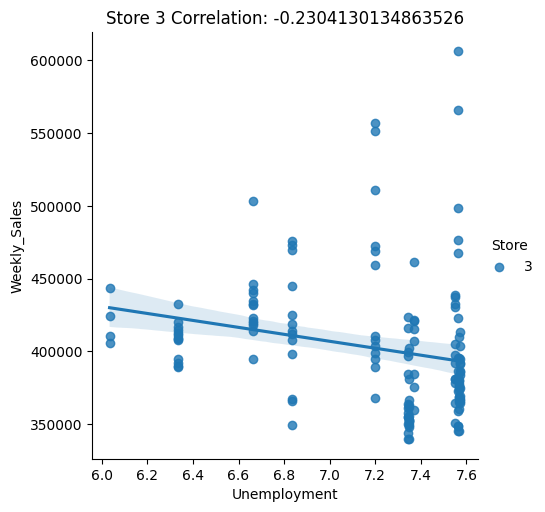

Store 4 Correlation: -0.3370151956445587


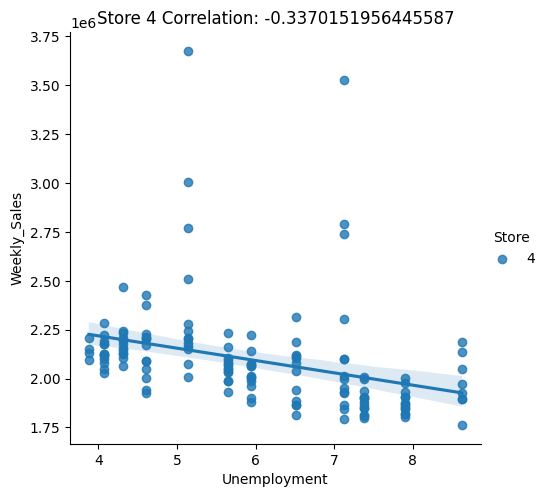

Store 5 Correlation: -0.20704271031605842


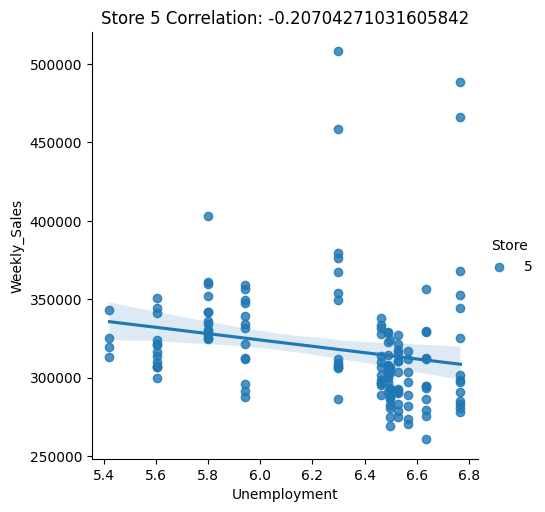

Store 6 Correlation: 0.044250821015624046


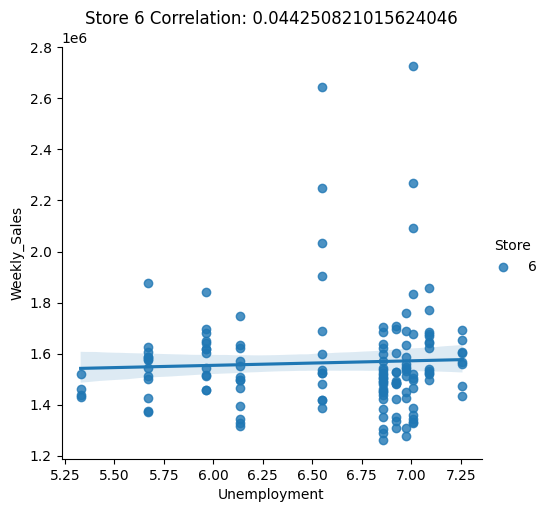

Store 7 Correlation: -0.16538168270129636


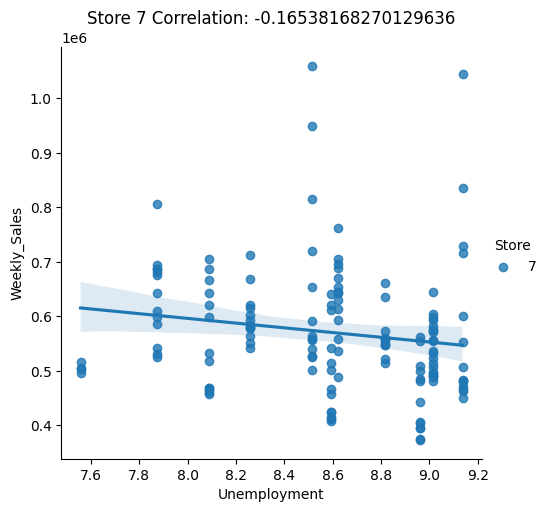

Store 8 Correlation: -0.05257964619712677


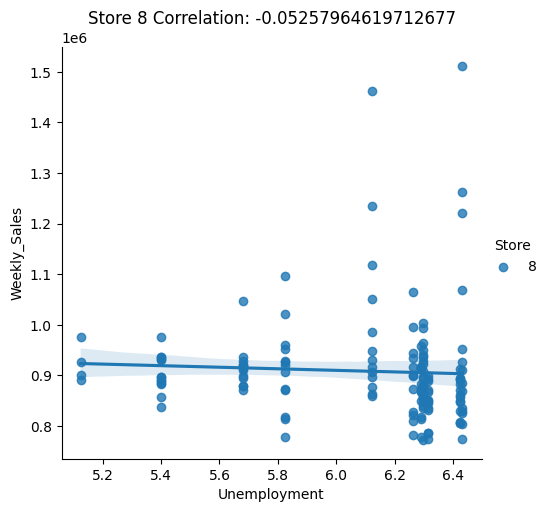

Store 9 Correlation: -0.1915343637022839


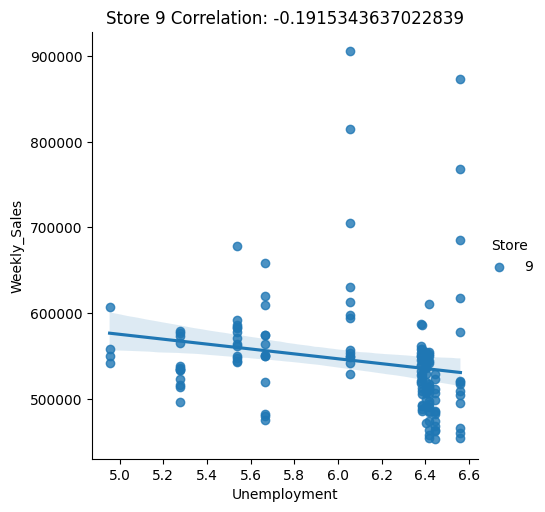

Store 10 Correlation: 0.13190762207746096


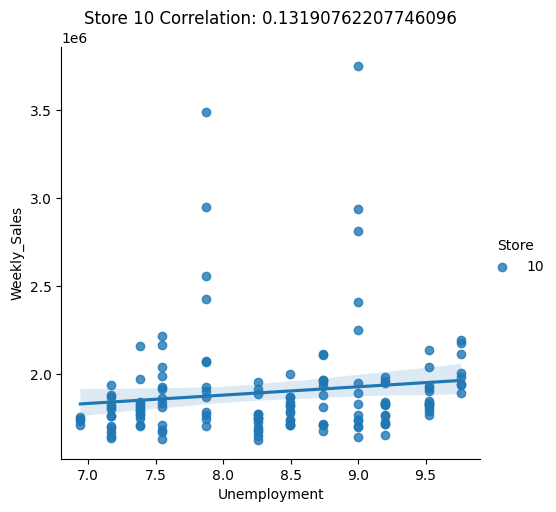

Store 11 Correlation: -0.020338971133082306


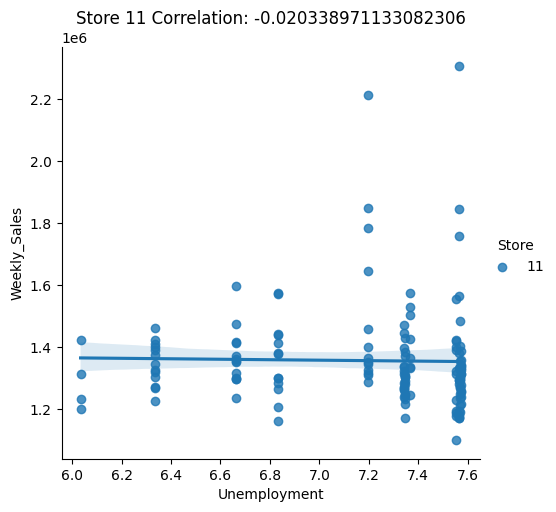

Store 12 Correlation: -0.009286099902746538


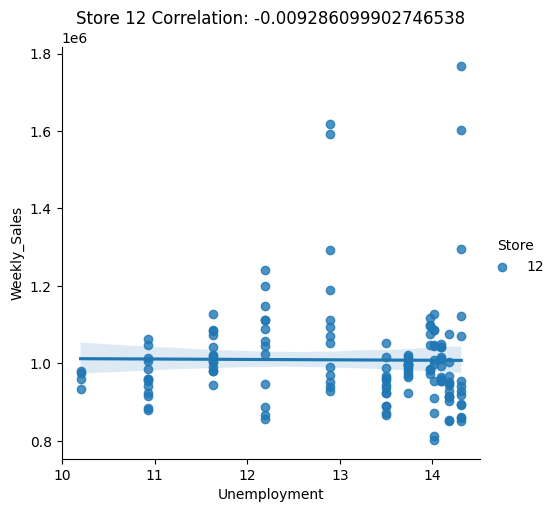

Store 13 Correlation: -0.1716328688963503


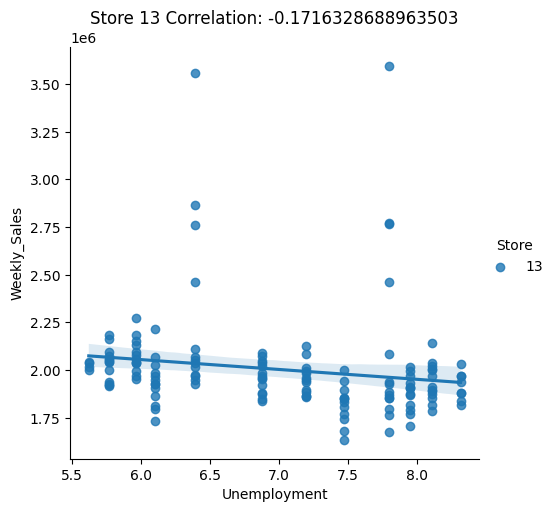

Store 14 Correlation: 0.2107864829459358


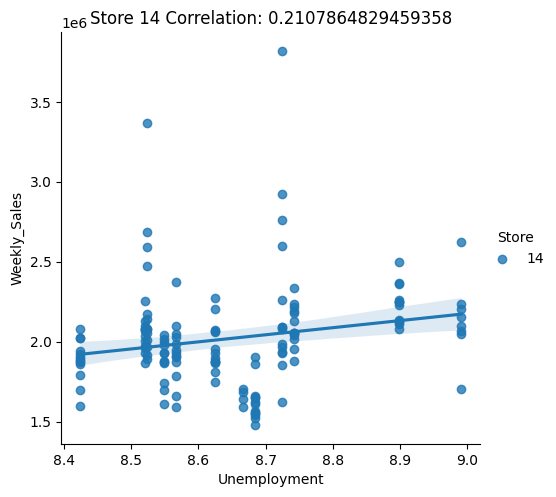

Store 15 Correlation: 0.0789053686051426


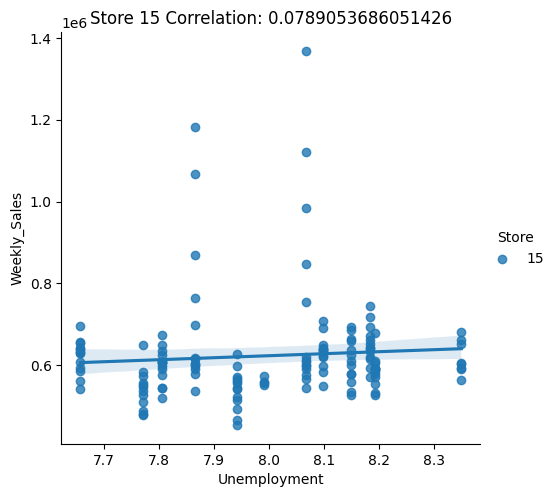

Store 16 Correlation: -0.07086358405192238


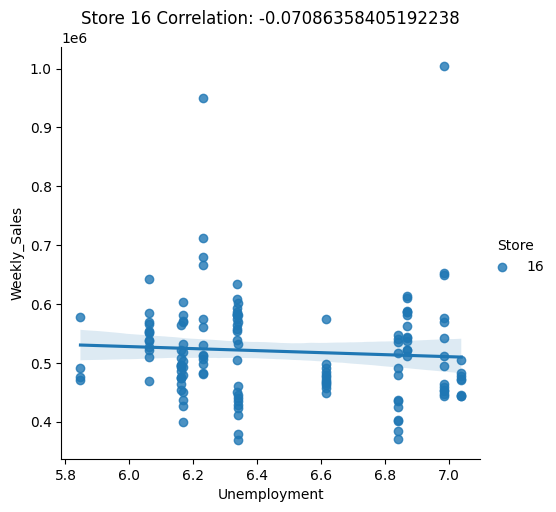

Store 17 Correlation: -0.26359968183073906


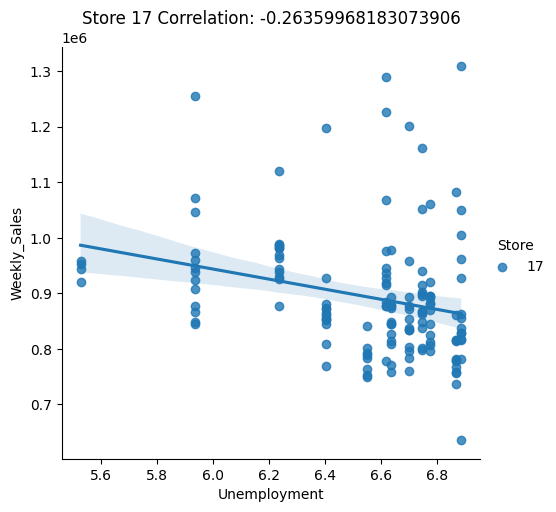

Store 18 Correlation: 0.13917900226669452


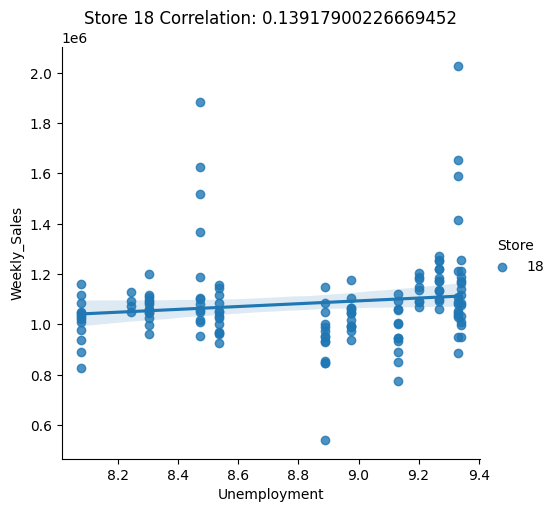

Store 19 Correlation: 0.10146392090273439


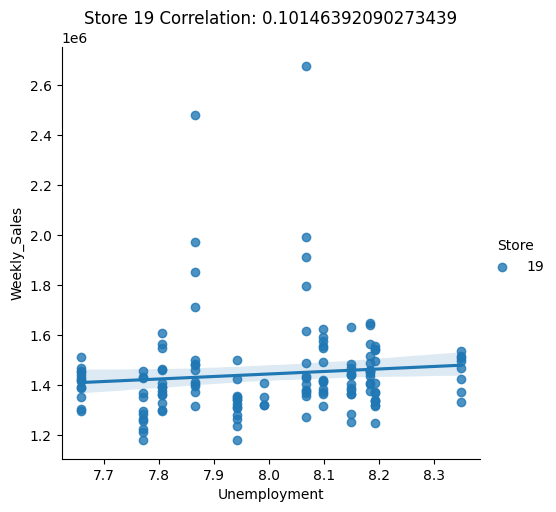

Store 20 Correlation: -0.09534134450284637


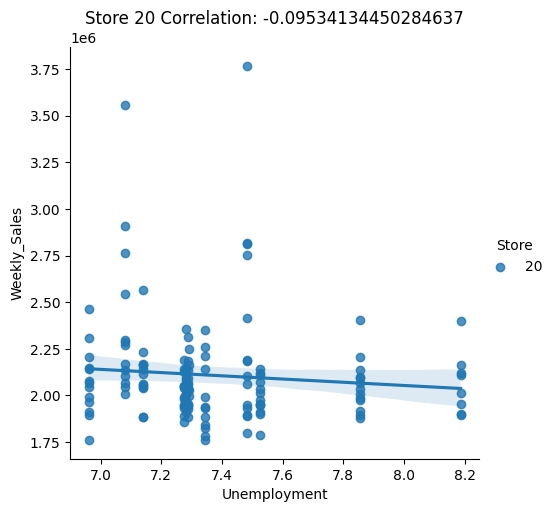

Store 21 Correlation: 0.21836733305703376


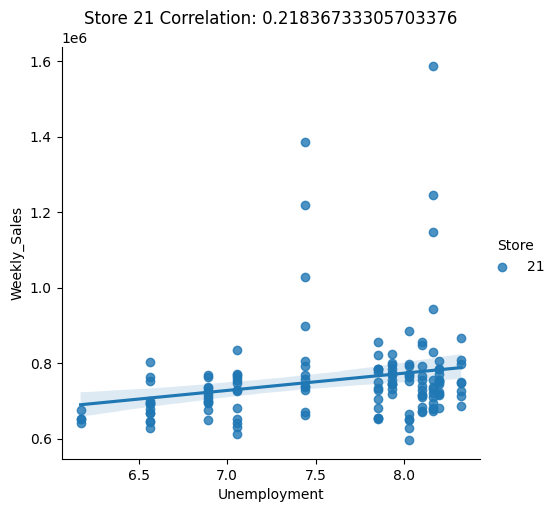

Store 22 Correlation: 0.039042867355347455


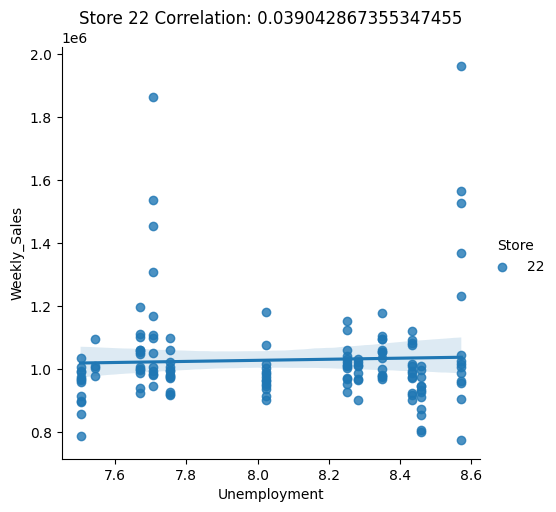

Store 23 Correlation: -0.07716899559088829


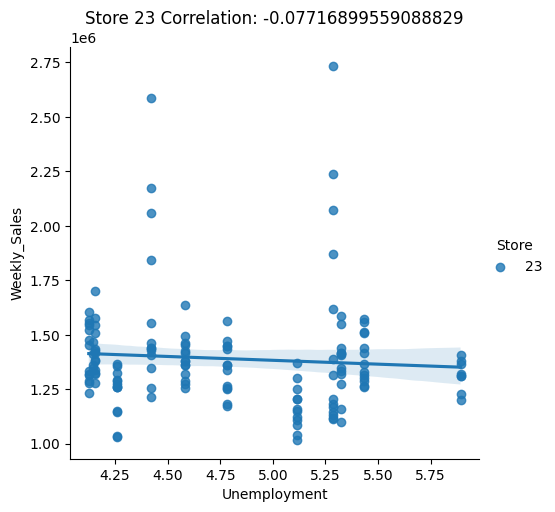

Store 24 Correlation: -0.012260801238922888


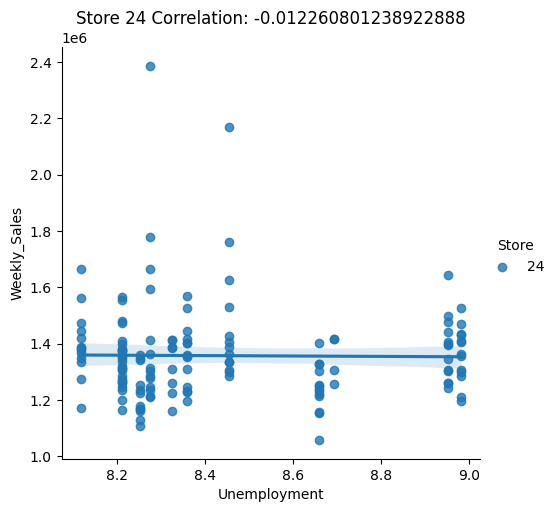

Store 25 Correlation: -0.004957651760361549


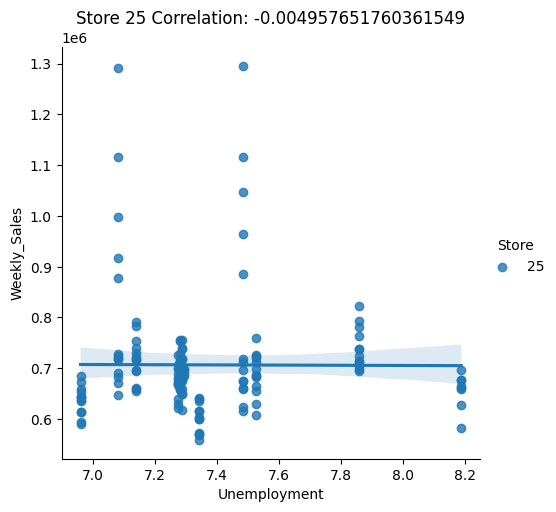

Store 26 Correlation: -0.06689910263473302


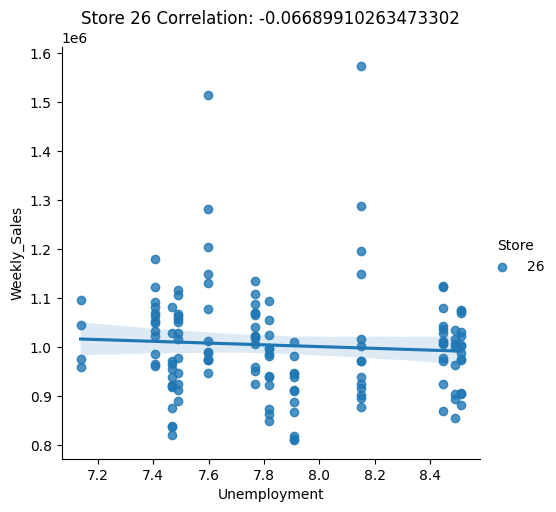

Store 27 Correlation: -0.0142750519412613


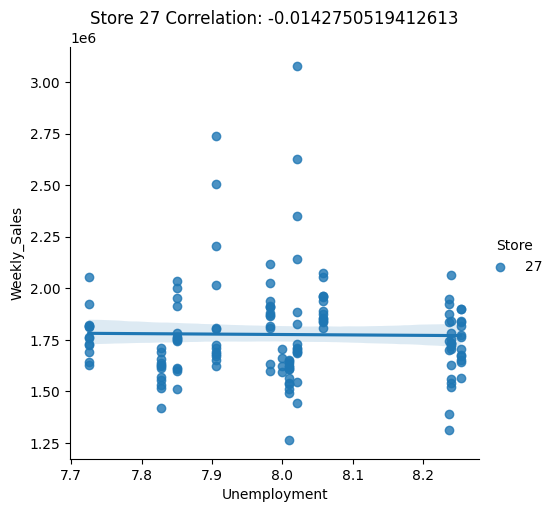

Store 28 Correlation: 0.1366706817794531


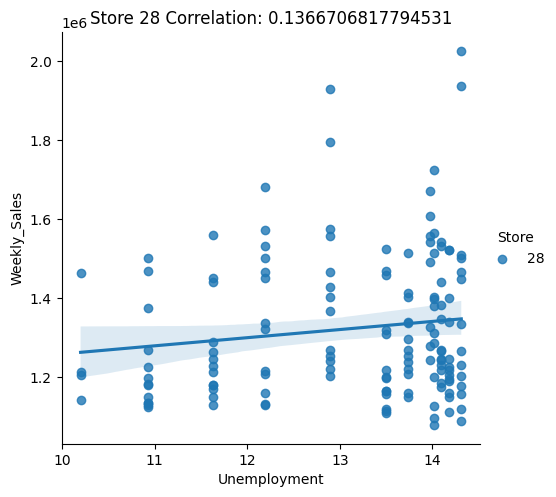

Store 29 Correlation: 0.08468168200648409


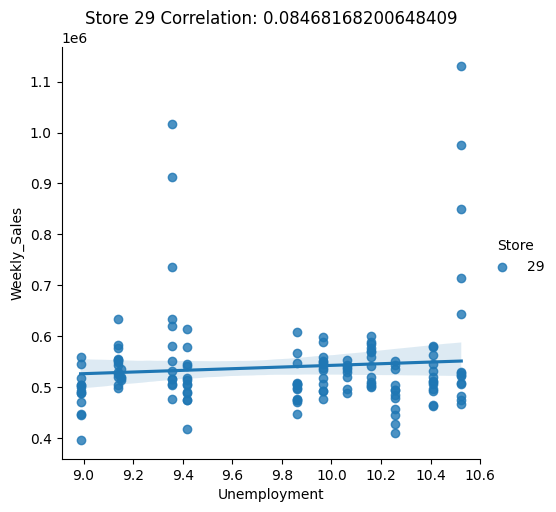

Store 30 Correlation: 0.20186223641523895


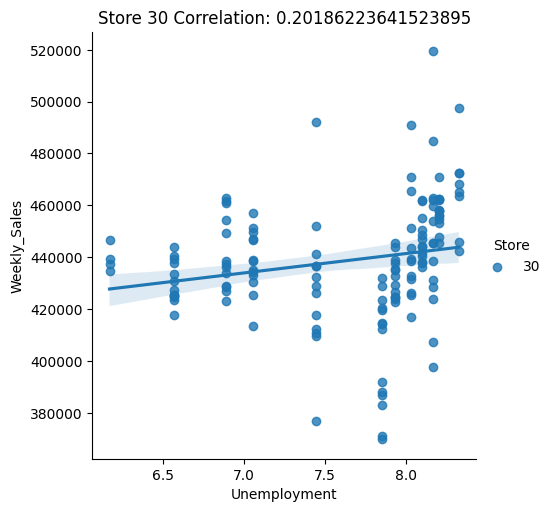

Store 31 Correlation: -0.06473780907548937


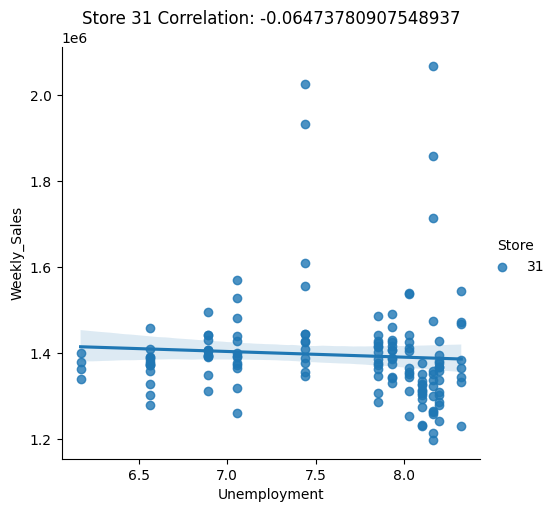

Store 32 Correlation: -0.09945467124759011


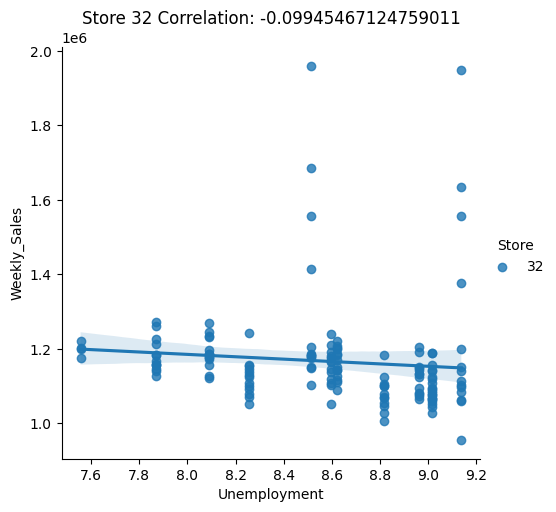

Store 33 Correlation: 0.10117473193757327


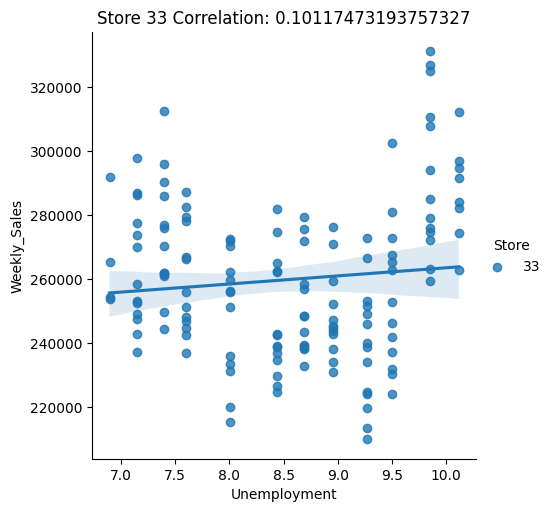

Store 34 Correlation: 0.01701025065278913


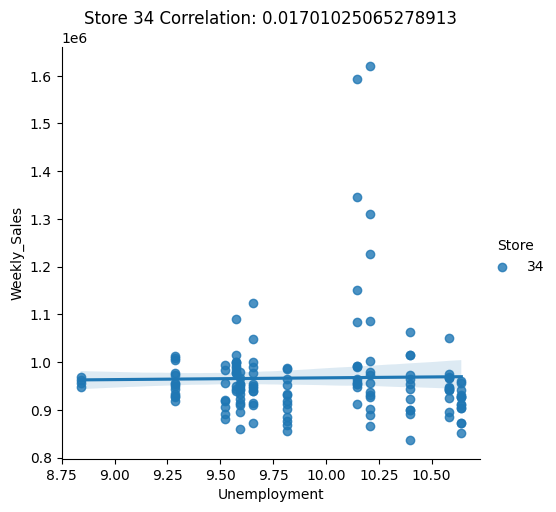

Store 35 Correlation: 0.4838654198192479


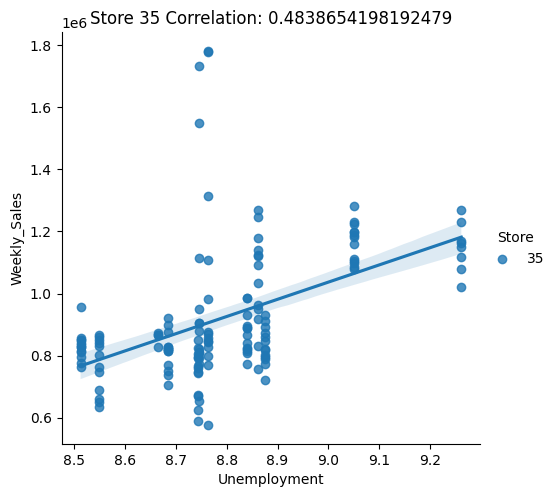

Store 36 Correlation: 0.8337336178415085


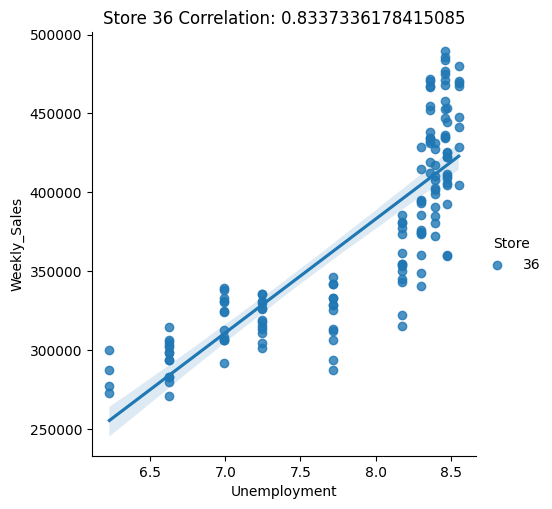

Store 37 Correlation: -0.22128669565468617


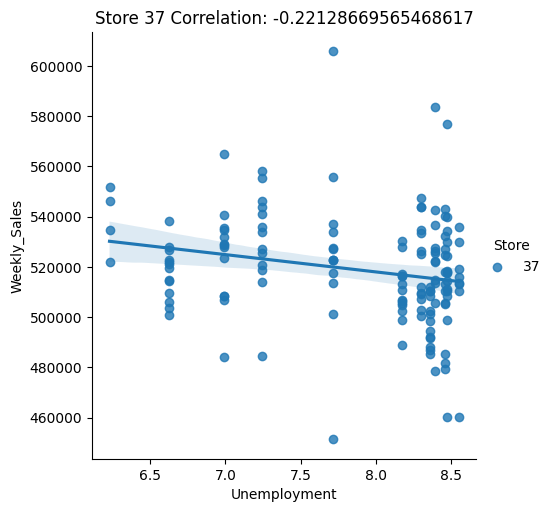

Store 38 Correlation: -0.7852902748572028


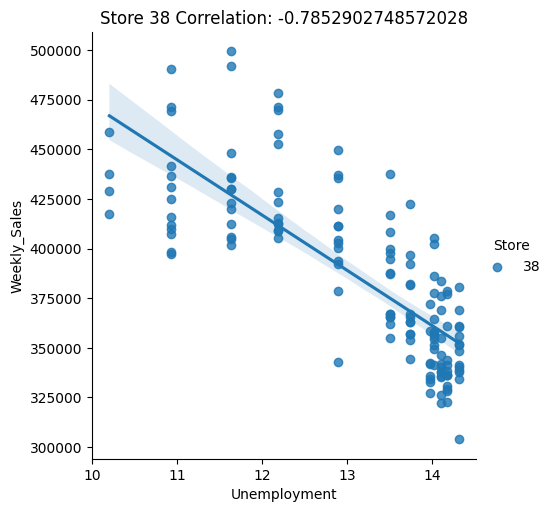

Store 39 Correlation: -0.38468135708616064


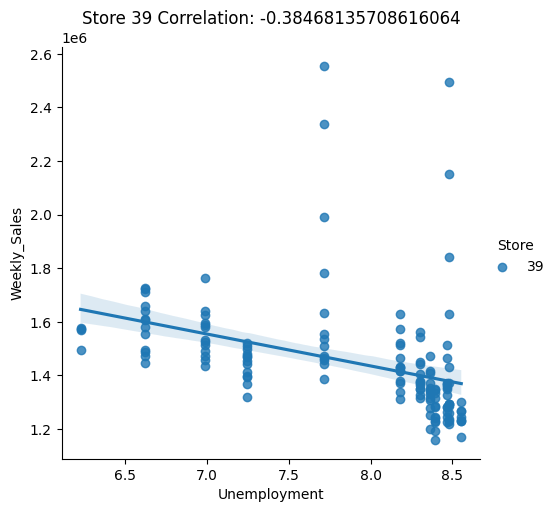

Store 40 Correlation: -0.11252795058812329


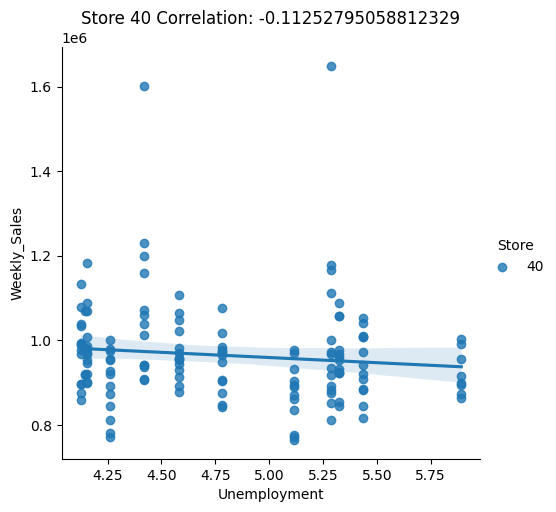

Store 41 Correlation: -0.3506296095634573


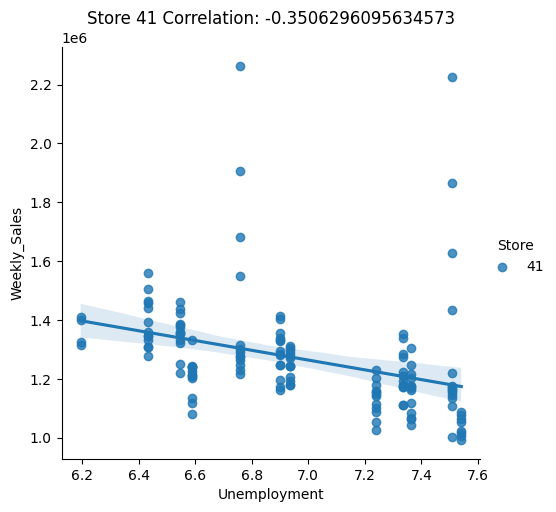

Store 42 Correlation: -0.3563546441574805


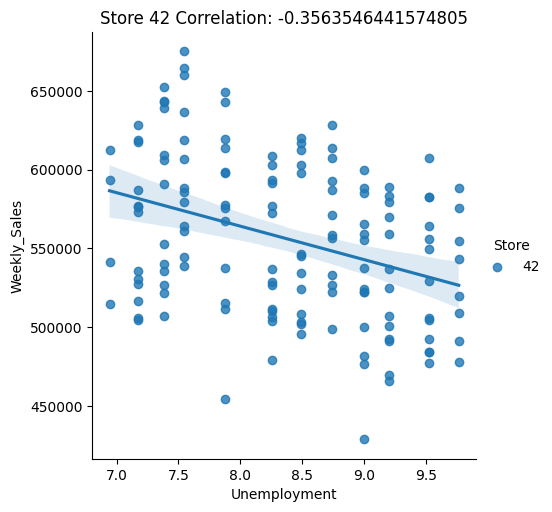

Store 43 Correlation: -0.20195435737205705


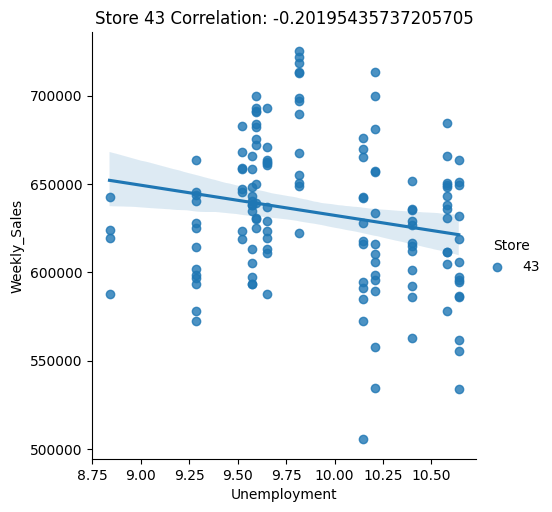

Store 44 Correlation: -0.7800764432910237


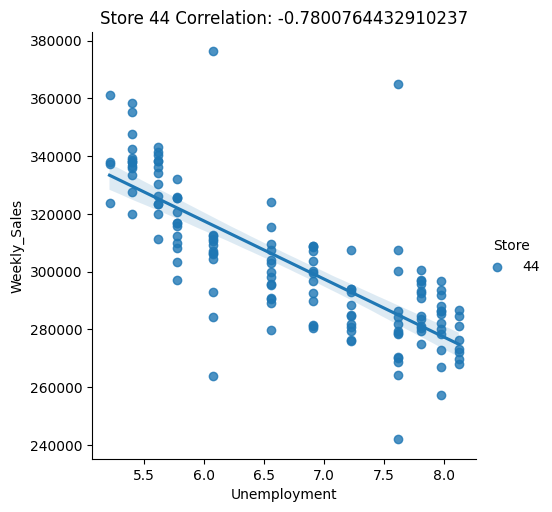

Store 45 Correlation: -0.004041028359856243


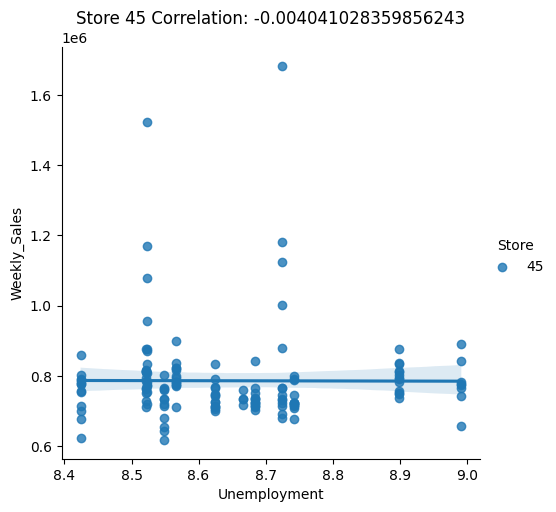

In [98]:
for i in df['Store'].unique():
  store_data = df[df['Store'] == i]
  correlation = store_data['Weekly_Sales'].corr(store_data['Unemployment'])
  print(f'Store {i} Correlation: {correlation}')
  sns.lmplot(x='Unemployment', y= 'Weekly_Sales', hue='Store', data=store_data)
  plt.title(f'Store {i} Correlation: {correlation}')
  plt.show()

* Here as per the visualization we can say that most of the stores performing well w.r.t Unemployment but **`store 38 and store 44`** gradually going downwards trend and its also have more negative Correlation.

* We can't say exactly its just because of unemployment, We can say that as per insights Sales are affecting by Unemployment

In [99]:
from sklearn.linear_model import LinearRegression

x = df['Unemployment'].values.reshape(-1, 1)
y = df['Weekly_Sales']

model = LinearRegression()
model.fit(x, y)
r2 = model.score(x, y)
print("R² Score:", r2)
print("Slope (m):", model.coef_[0])
print("Intercept (c):", model.intercept_)

R² Score: 0.011273362015053912
Slope (m): -31943.45497255217
Intercept (c): 1302485.3989125828


* After Checking all posibilities here i'm concluding here there is no relationship between Weekly Sale and Unemployment
* Here sales never droped even when unemployment increases and having only very slight changes which doesn't give any evidence of their reationship
* Low R2 Score and high slope is showing that there is no relationship between Weekly Sales and Unemployment

R2 is close to 0 which indicates no fit

### If the weekly sales show a seasonal trend, when and what could be the reason?

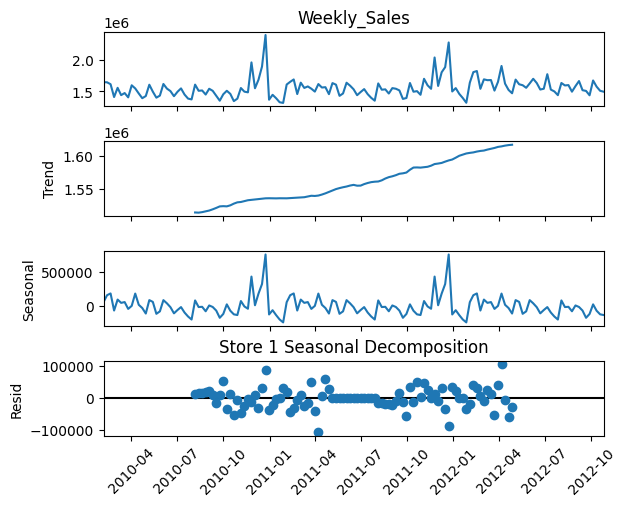

Store 1 Seasonal Strength: 0.9562524716614684


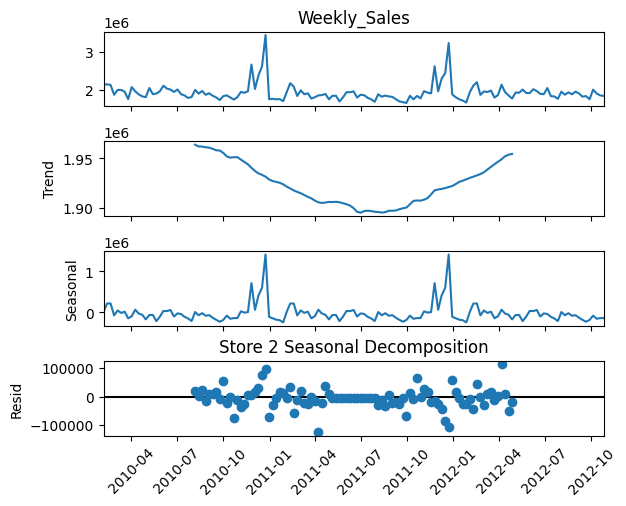

Store 2 Seasonal Strength: 0.9768357467451793


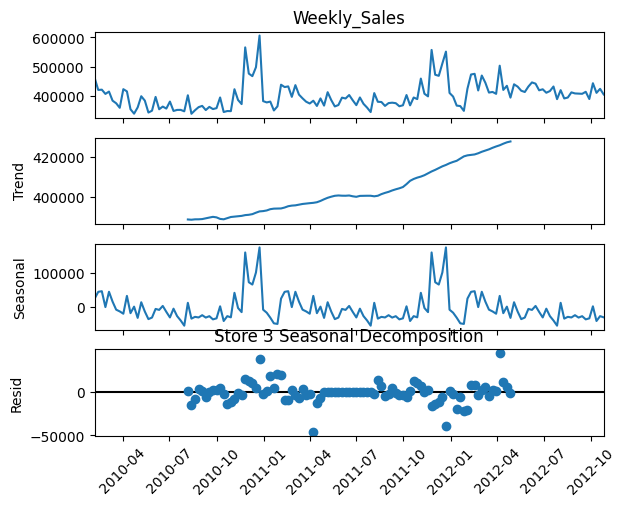

Store 3 Seasonal Strength: 0.932963080840924


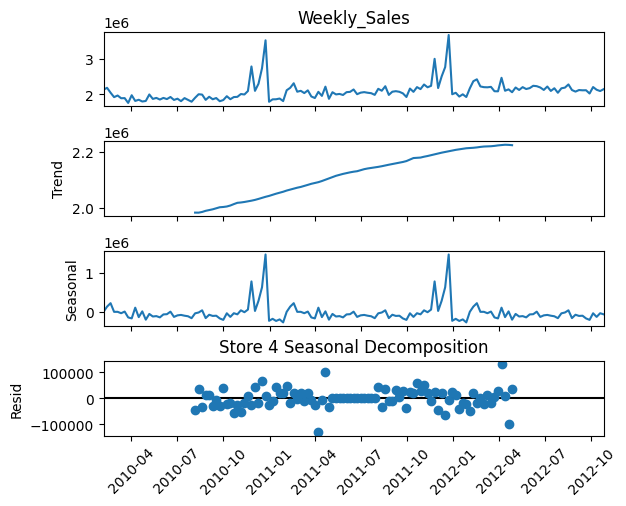

Store 4 Seasonal Strength: 0.9812348679134585


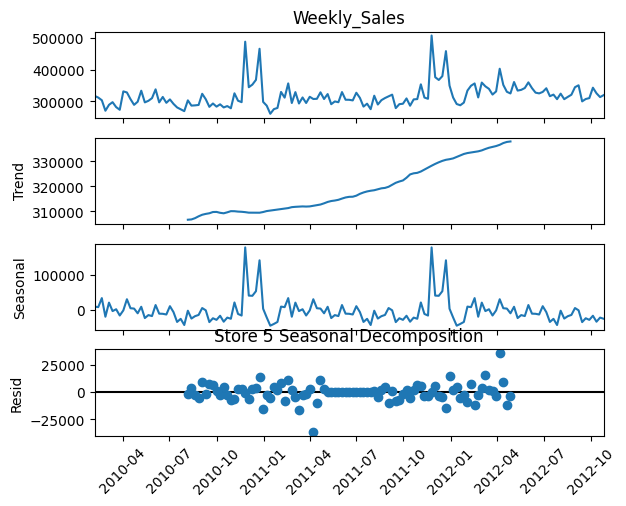

Store 5 Seasonal Strength: 0.9528739483091573


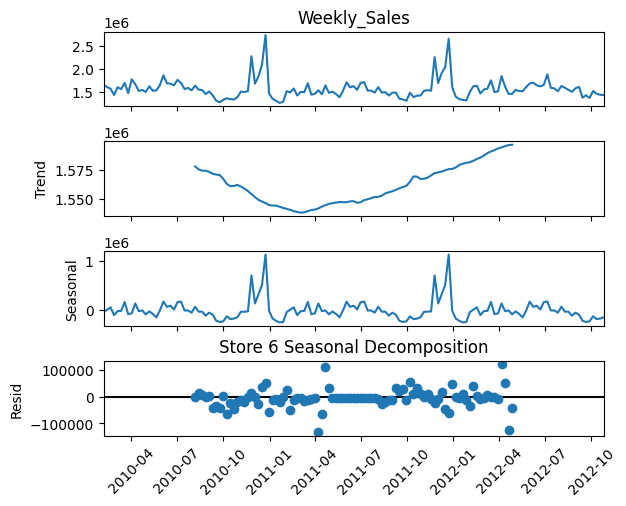

Store 6 Seasonal Strength: 0.972443700942267


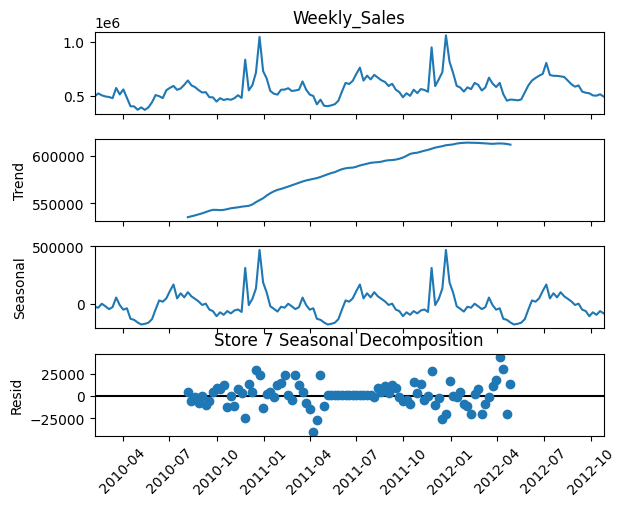

Store 7 Seasonal Strength: 0.9856512107654513


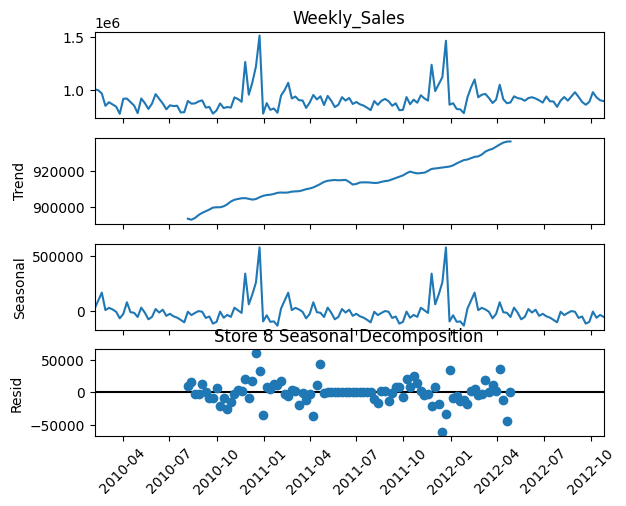

Store 8 Seasonal Strength: 0.9734745499112183


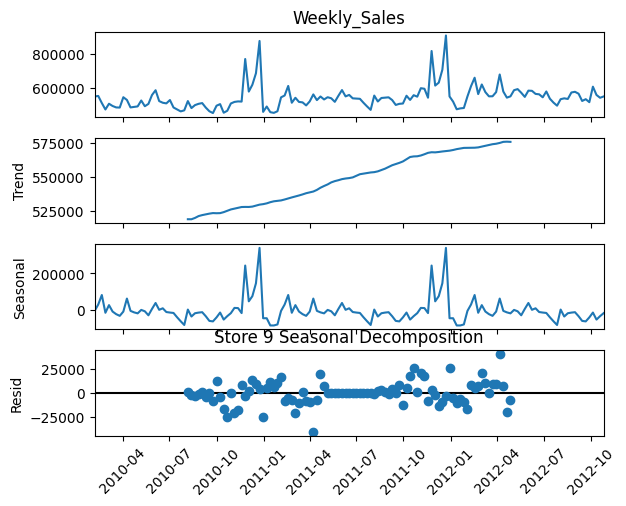

Store 9 Seasonal Strength: 0.9696319974368452


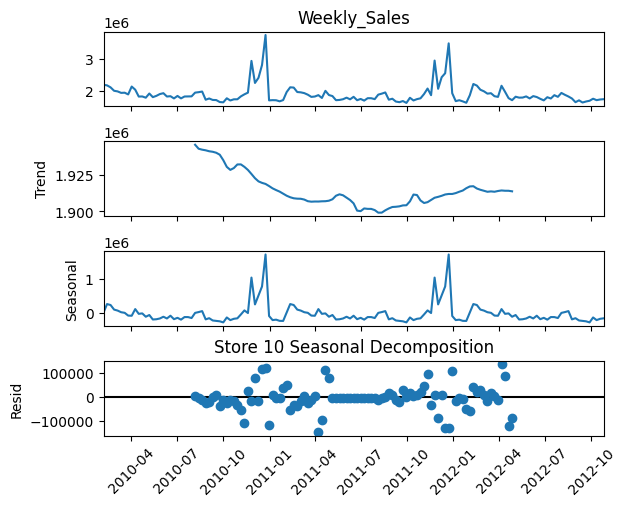

Store 10 Seasonal Strength: 0.9686917751967103


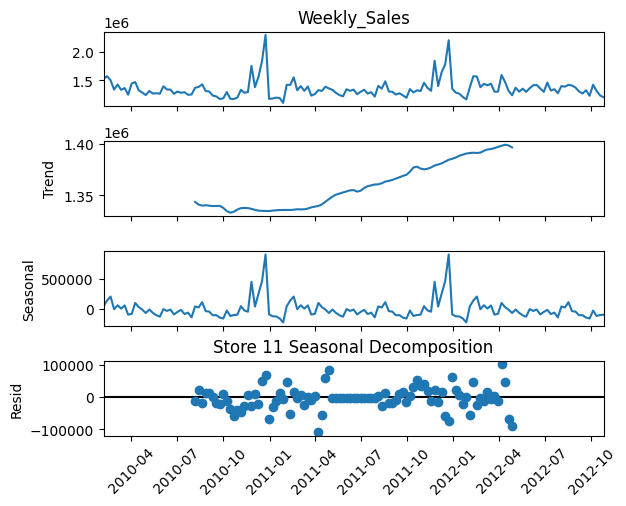

Store 11 Seasonal Strength: 0.9550324560927937


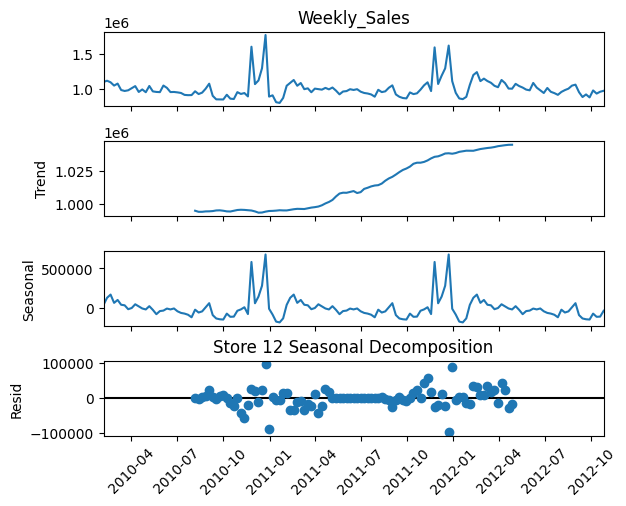

Store 12 Seasonal Strength: 0.9605408346118113


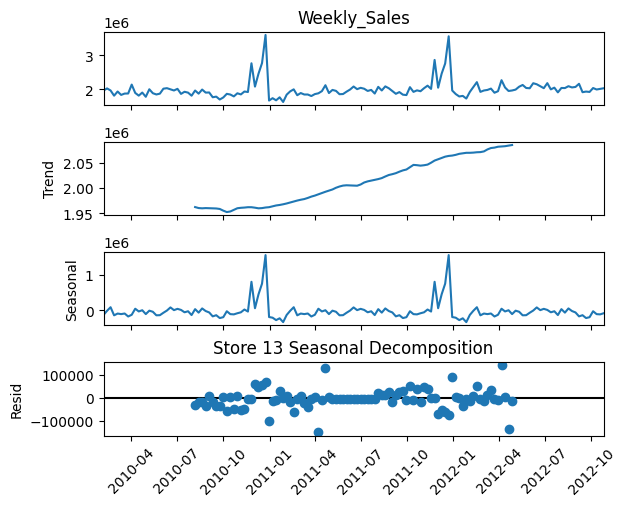

Store 13 Seasonal Strength: 0.9743326288503842


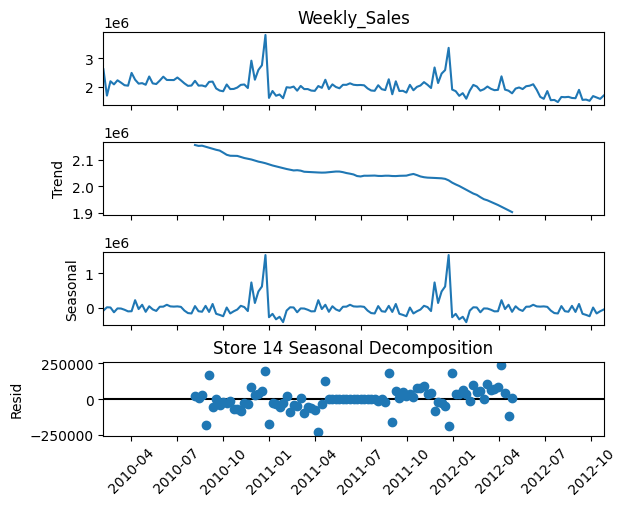

Store 14 Seasonal Strength: 0.9379417183065388


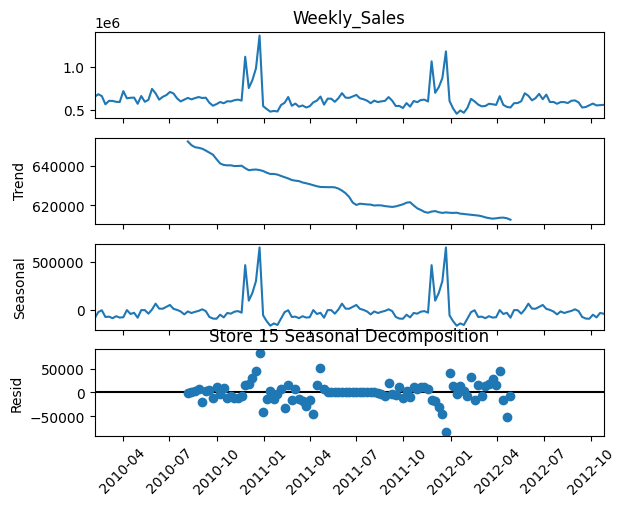

Store 15 Seasonal Strength: 0.9665346232122034


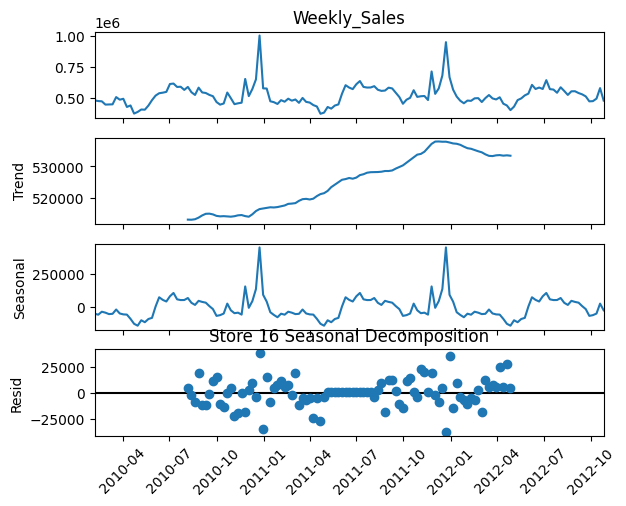

Store 16 Seasonal Strength: 0.9758746146747842


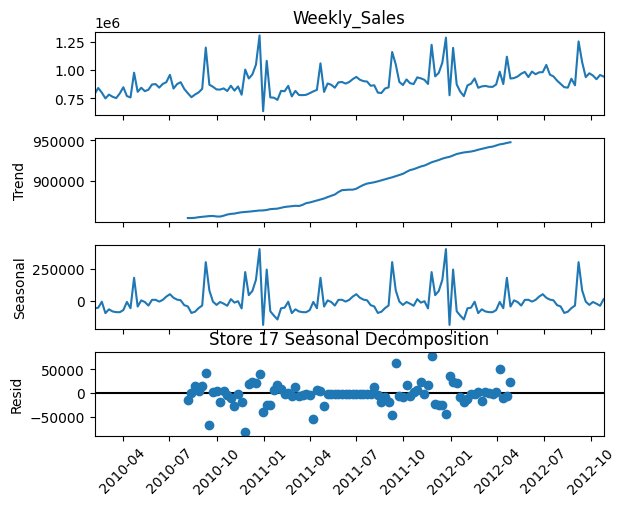

Store 17 Seasonal Strength: 0.9560700682622991


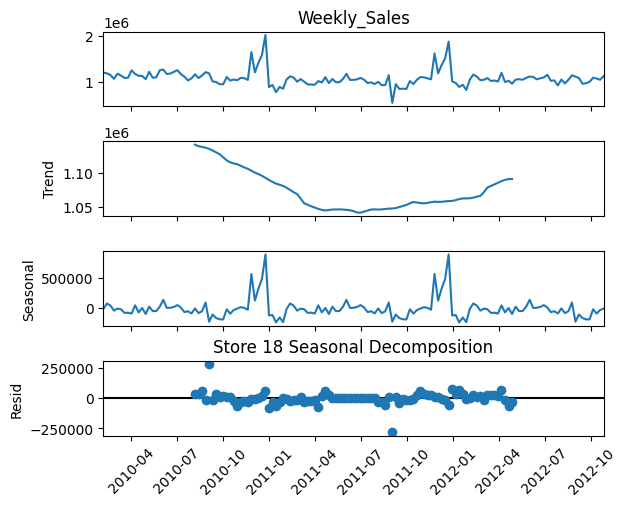

Store 18 Seasonal Strength: 0.9124388268424224


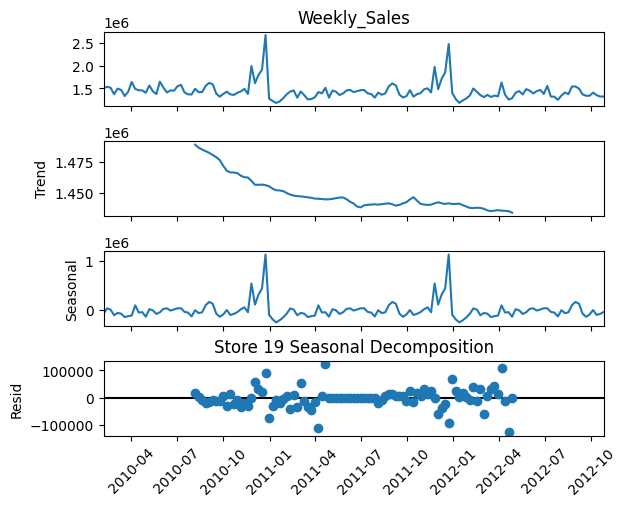

Store 19 Seasonal Strength: 0.9626219503056438


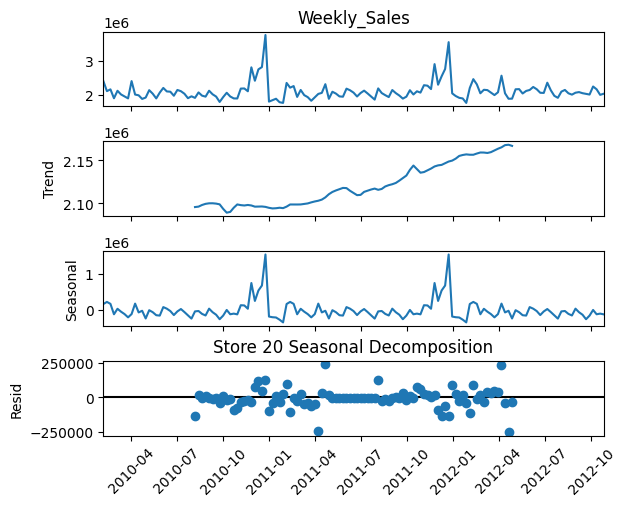

Store 20 Seasonal Strength: 0.9313159199776984


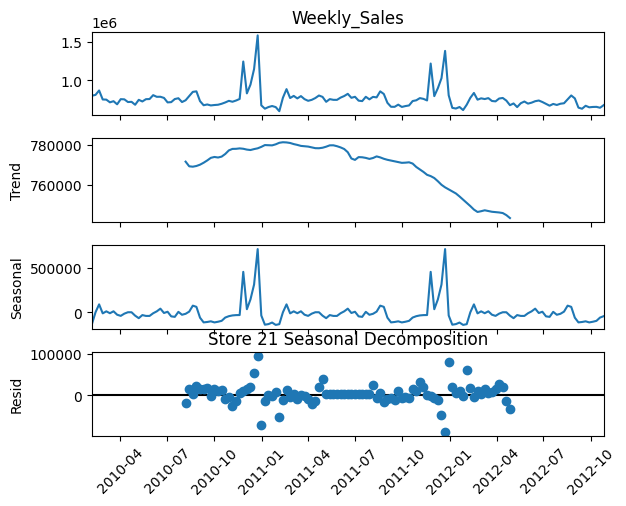

Store 21 Seasonal Strength: 0.9638271361877752


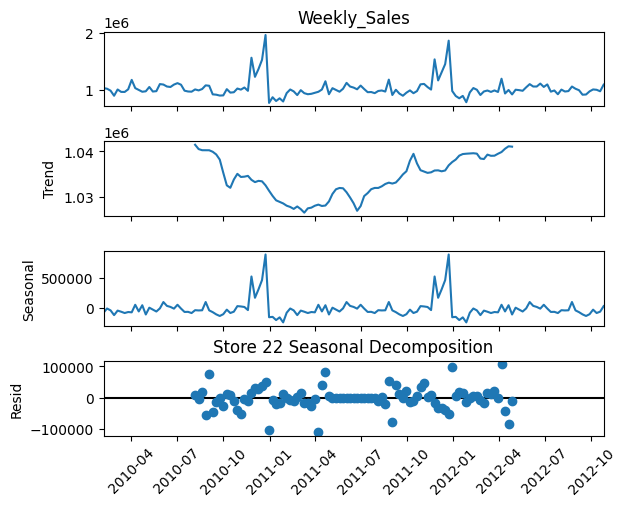

Store 22 Seasonal Strength: 0.9529380050933927


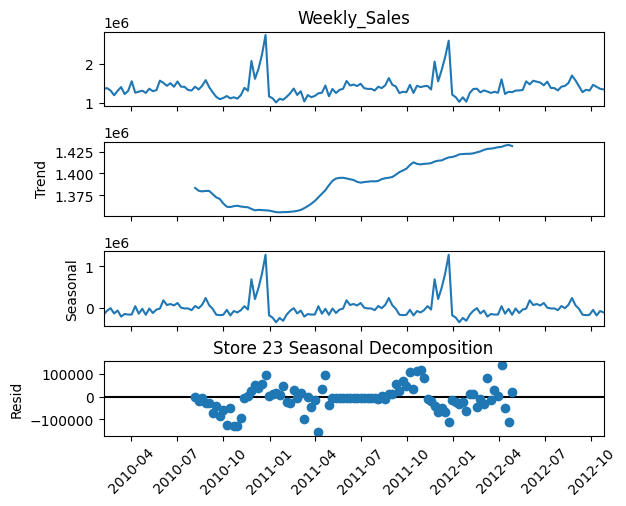

Store 23 Seasonal Strength: 0.9490970957096776


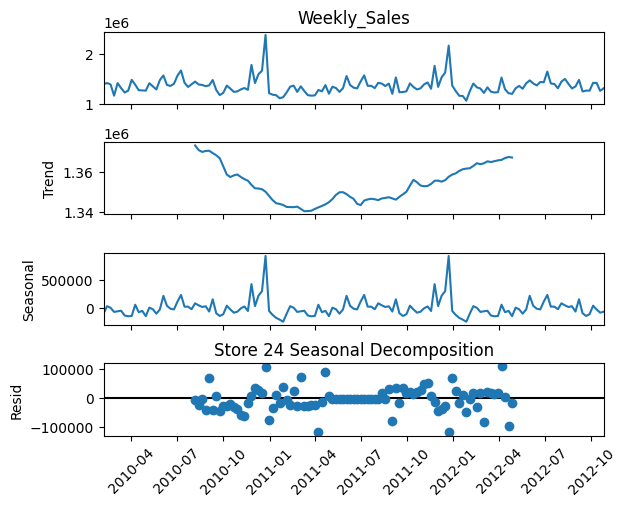

Store 24 Seasonal Strength: 0.9401930950548145


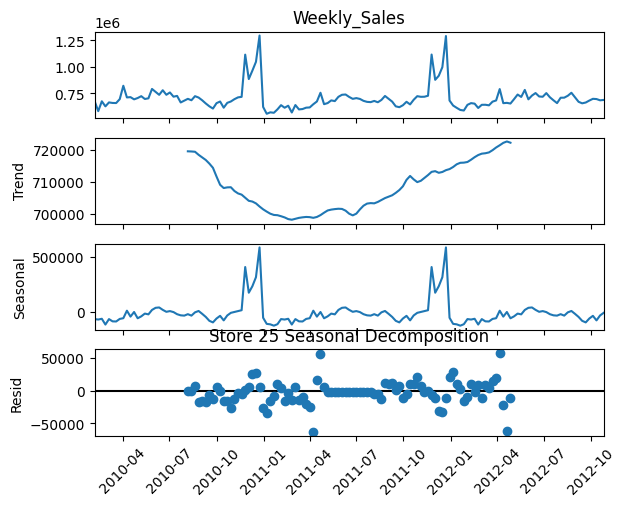

Store 25 Seasonal Strength: 0.9744725509997972


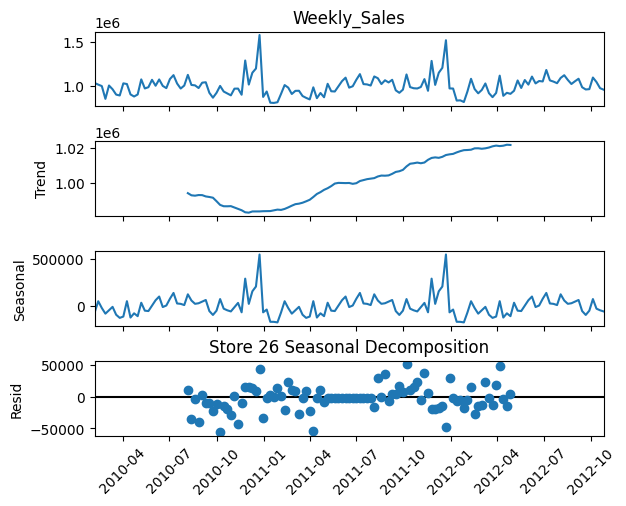

Store 26 Seasonal Strength: 0.966272226211632


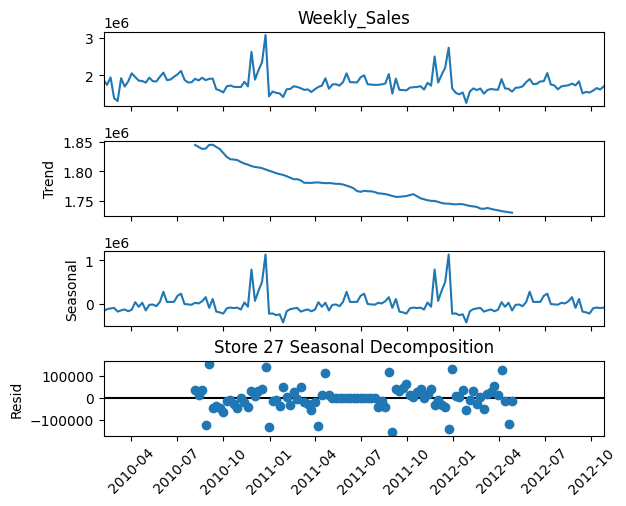

Store 27 Seasonal Strength: 0.9457322758897119


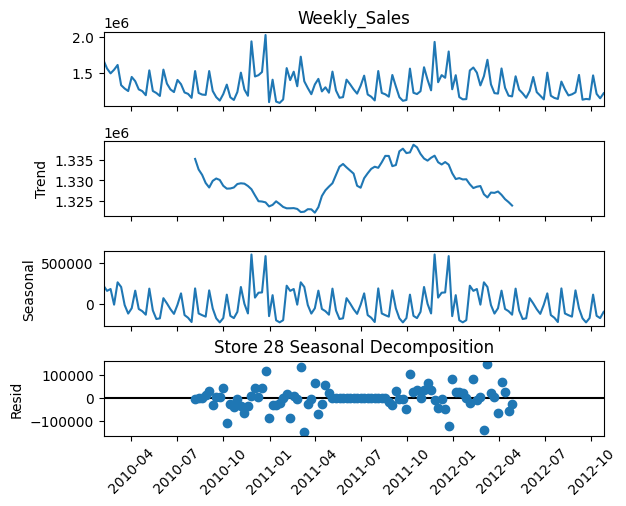

Store 28 Seasonal Strength: 0.9227721841236749


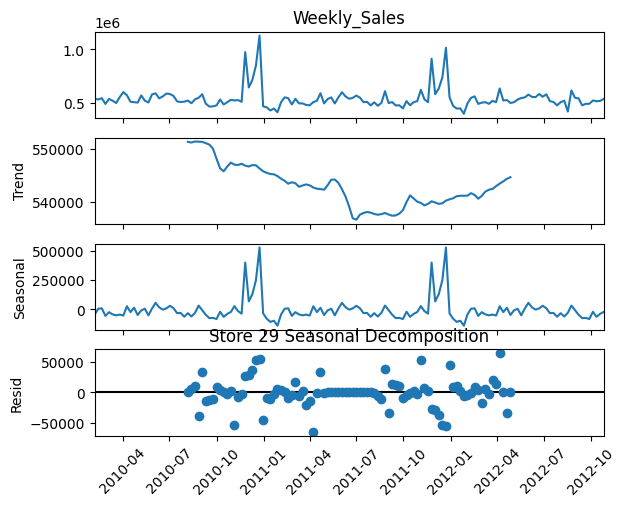

Store 29 Seasonal Strength: 0.9472148412257791


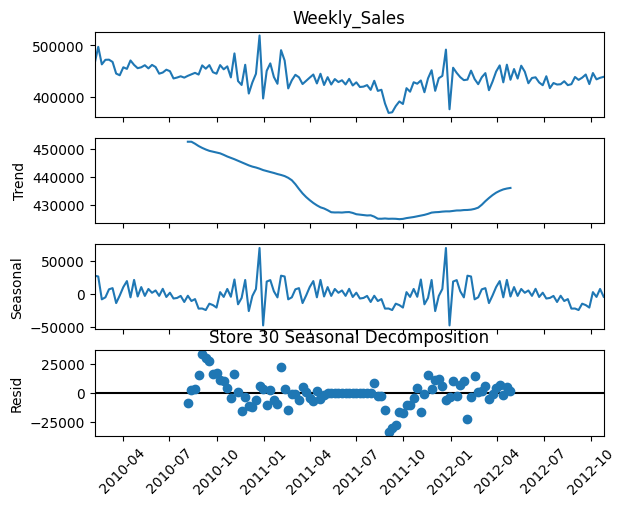

Store 30 Seasonal Strength: 0.7490828992313445


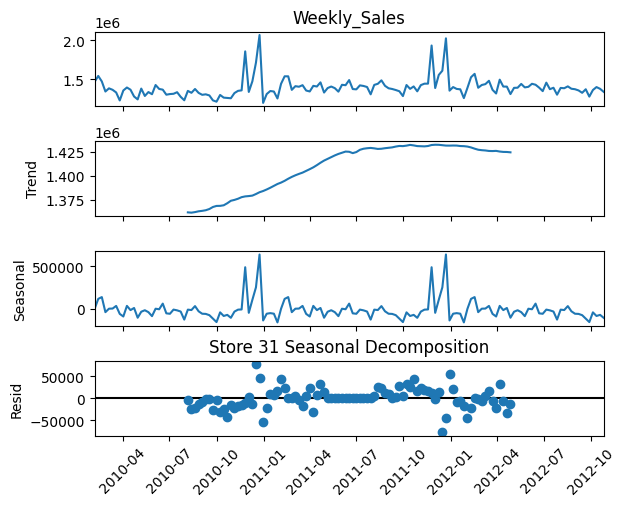

Store 31 Seasonal Strength: 0.9650529960304086


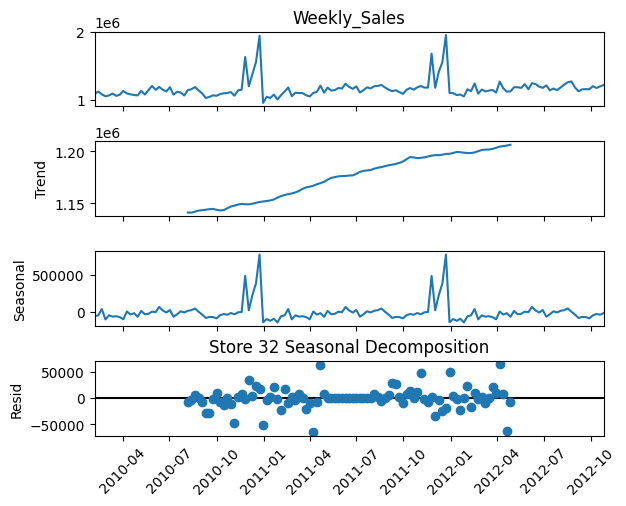

Store 32 Seasonal Strength: 0.9774252818091549


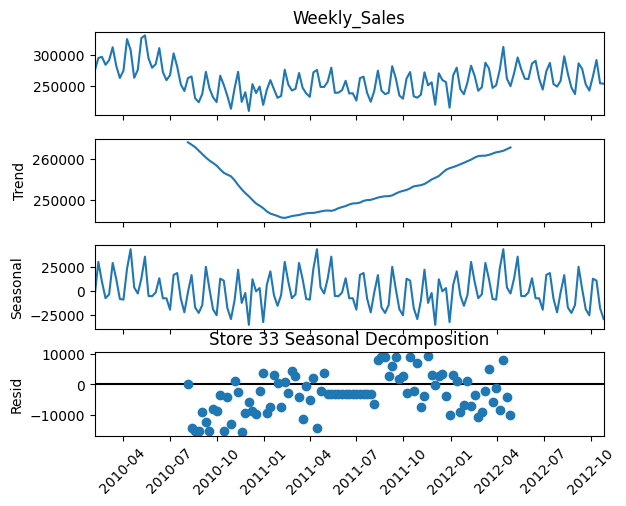

Store 33 Seasonal Strength: 0.9293705401258183


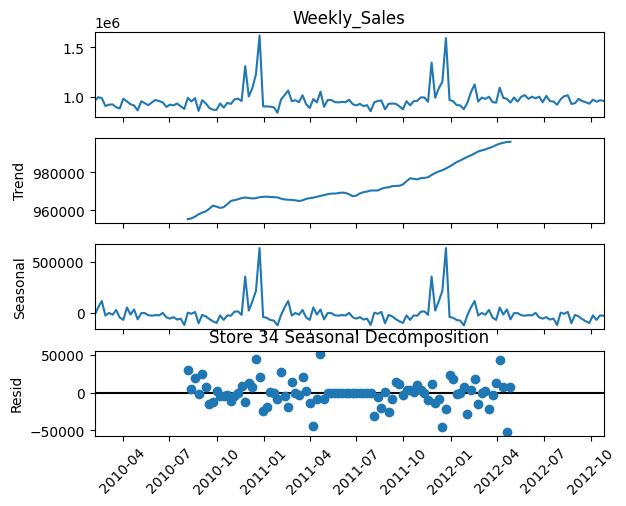

Store 34 Seasonal Strength: 0.9734883497749577


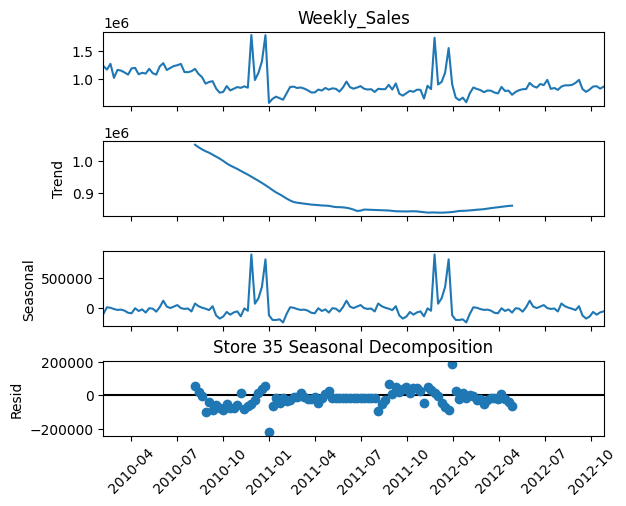

Store 35 Seasonal Strength: 0.9479406449260275


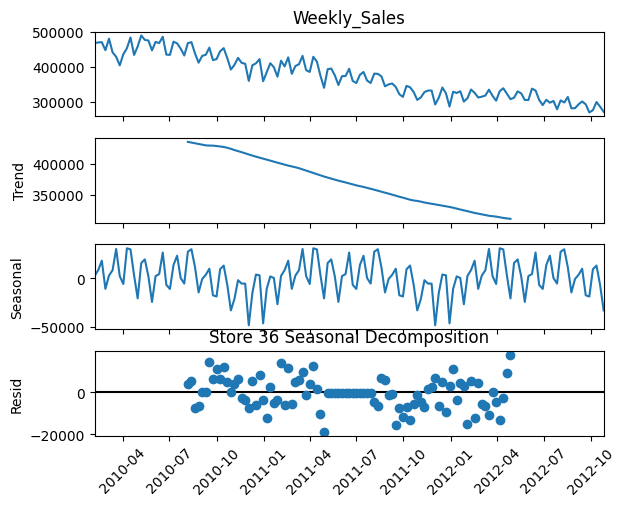

Store 36 Seasonal Strength: 0.9853799899921358


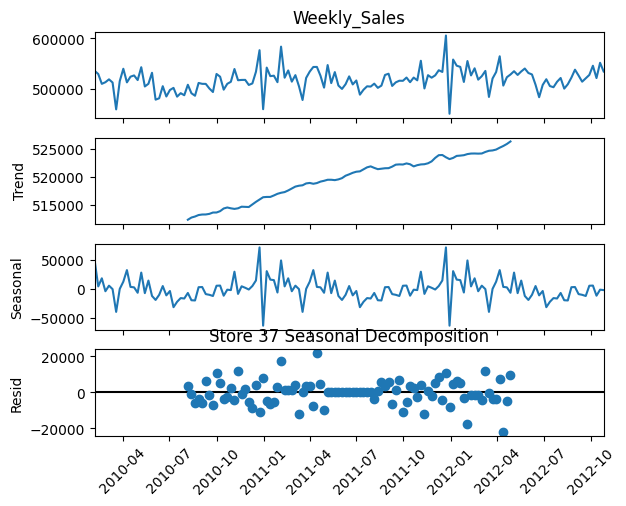

Store 37 Seasonal Strength: 0.9043925939355076


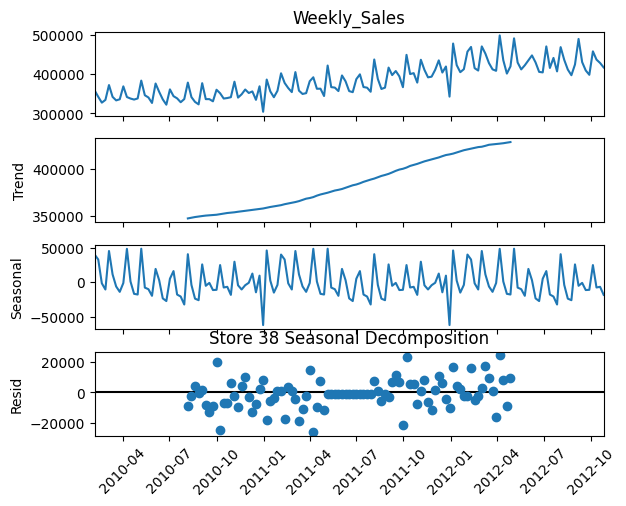

Store 38 Seasonal Strength: 0.9481439694532693


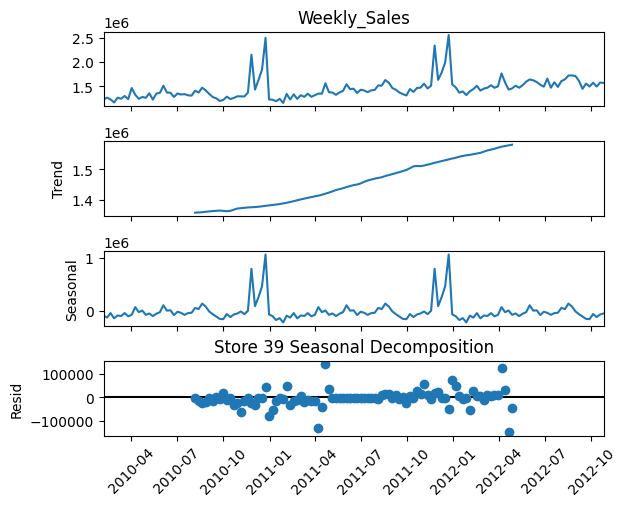

Store 39 Seasonal Strength: 0.9705409852650659


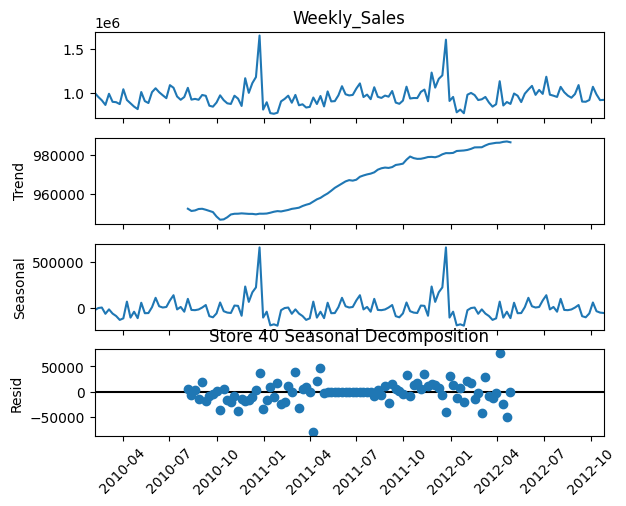

Store 40 Seasonal Strength: 0.9674577584113038


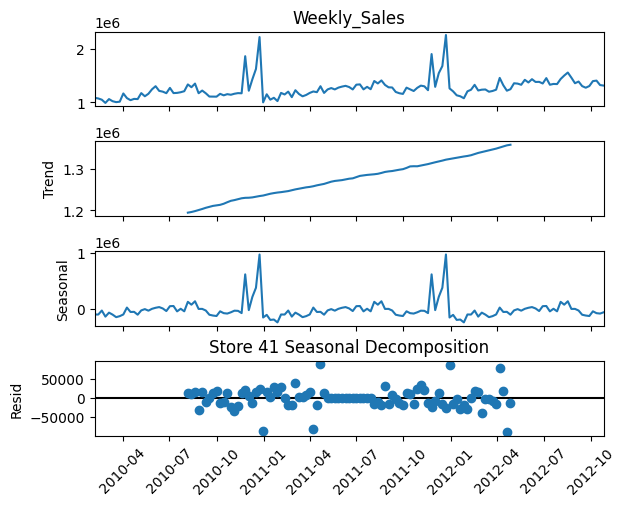

Store 41 Seasonal Strength: 0.9785803983599082


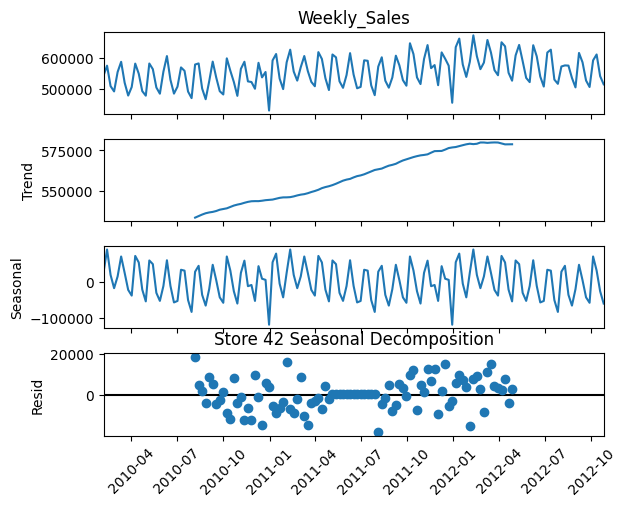

Store 42 Seasonal Strength: 0.9773499426687579


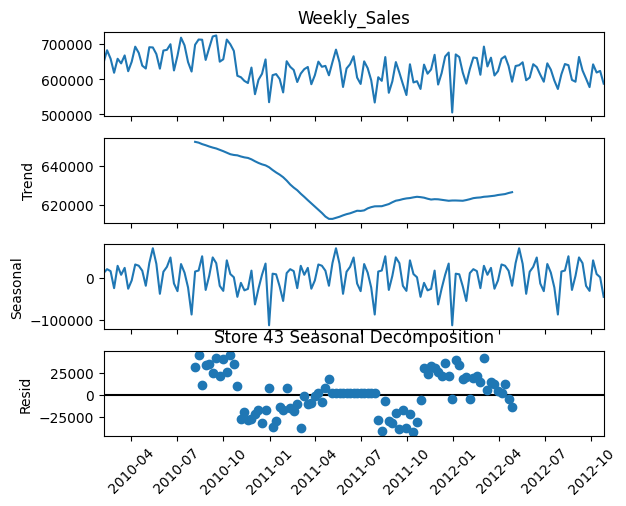

Store 43 Seasonal Strength: 0.6792794309746756


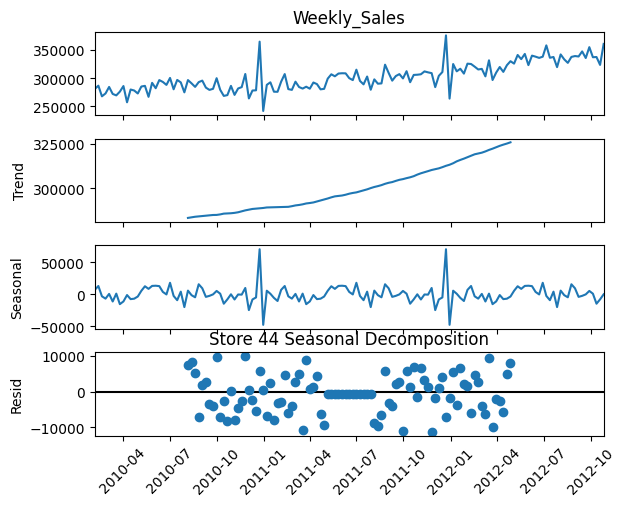

Store 44 Seasonal Strength: 0.9547972973385248


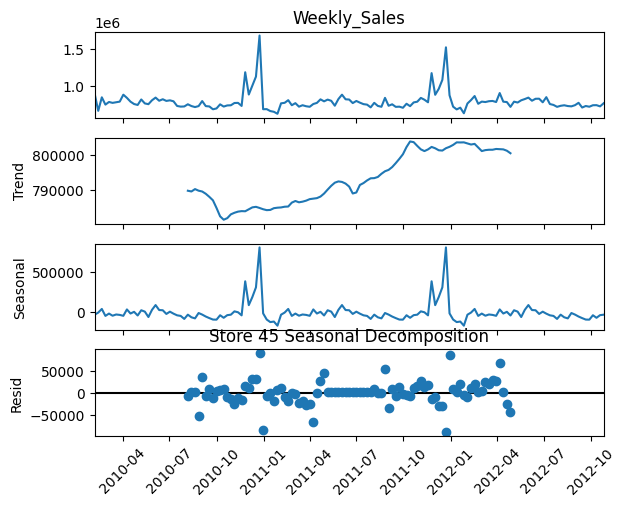

Store 45 Seasonal Strength: 0.9555999438877274


In [100]:
from statsmodels.tsa.seasonal import seasonal_decompose
## Checking Seasonality for every store
for id in df1.index.get_level_values('Store').unique():
  storeData = df1.loc[id]
  decompose = seasonal_decompose(storeData['Weekly_Sales'], model='additive', period=52)
  decompose.plot()
  plt.title(f'Store {id} Seasonal Decomposition')
  plt.xticks(rotation=45)
  plt.show()
  seasonal_strength = 1 - (np.var(decompose.resid) / np.var(decompose.observed))
  print(f'Store {id} Seasonal Strength: {seasonal_strength}')

* Yes there was seasonality at every end of the year

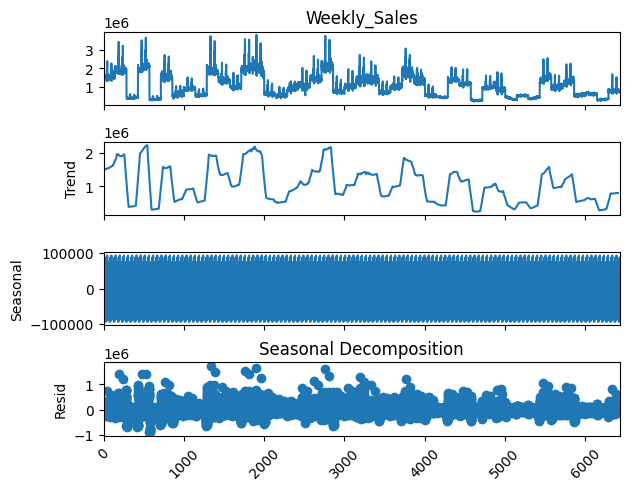

Seasonal Strength: 0.8795570120923571


In [101]:
decompose1 = seasonal_decompose(df['Weekly_Sales'], model='additive', period=52)
decompose1.plot()
plt.title('Seasonal Decomposition')
plt.xticks(rotation=45)
plt.show()
seasonal_strength1 = 1 - (np.var(decompose1.resid)/ np.var(decompose1.observed))
print(f'Seasonal Strength: {seasonal_strength1}')

In [102]:
# seasonal_strength = decompose.seasonal.std()
# seasonal_strength = 1 - (np.var(decompose.resid) / np.var(decompose.observed))
# seasonal_strength

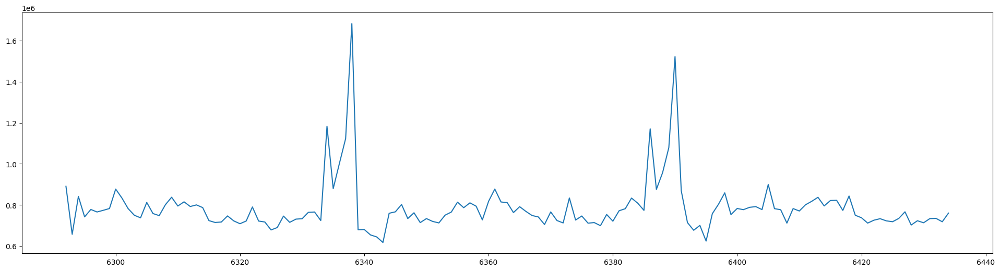

In [103]:
plt.figure(figsize=(24, 6))
plt.plot(store_data['Weekly_Sales'])
plt.show()

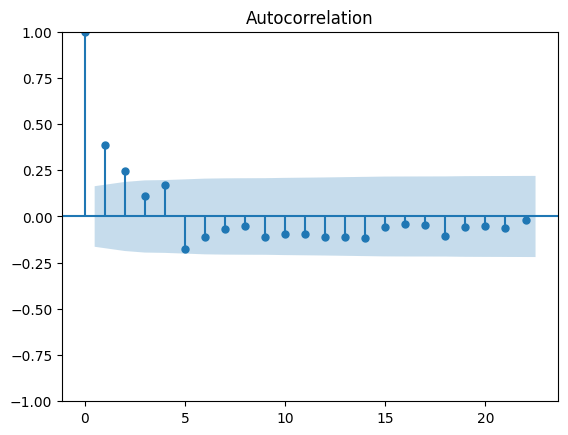

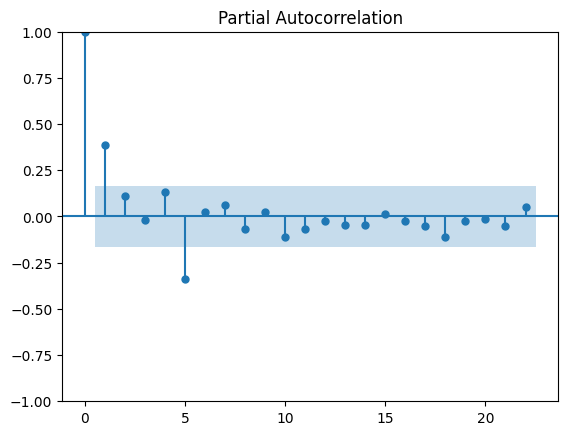

In [104]:
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
plot_acf(store_data['Weekly_Sales'])
plot_pacf(store_data['Weekly_Sales'])
plt.show()

* Yes there was a seationality in the data

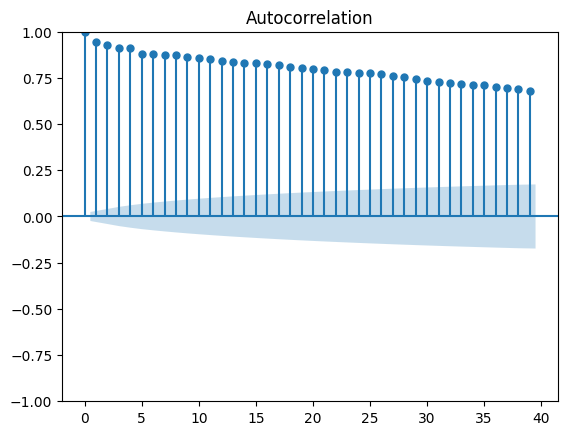

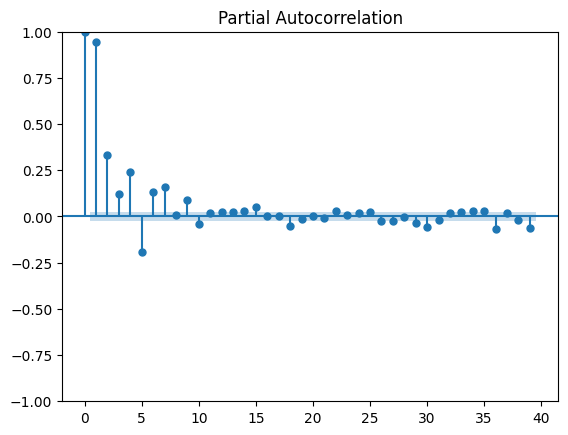

In [105]:
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
plot_acf(df['Weekly_Sales'], )
plot_pacf(df['Weekly_Sales'])
plt.show()

* Here We can take `Q = 4` because it is gradually decreasing upto 4
* Here We can take `P = 3` because it is gradually decrease upto 3

In [106]:
# !pip uninstall -y numpy pmdarima
# !pip install numpy==1.23.5 pmdarima==2.0.4

In [107]:
# from pmdarima import auto_arima

# # Make sure your series is datetime indexed
# df = df.set_index('Date')

# # Select 1 store (if using global model, remove filtering)
# store_data1 = df['Weekly_Sales']

# # Run auto_arima
# model = auto_arima(store_data1,
#                    start_p=0, max_p=5,
#                    start_q=0, max_q=5,
#                    d=None,              # Let it find optimal 'd'
#                    seasonal=False,      # Set to True if you expect seasonality
#                    trace=True,          # Shows progress
#                    error_action='ignore',
#                    suppress_warnings=True,
#                    stepwise=True,       # Faster search
#                    information_criterion='aic')  # You can also use 'bic'

# print(model.summary())


### Does temperature affect the weekly sales in any manner?

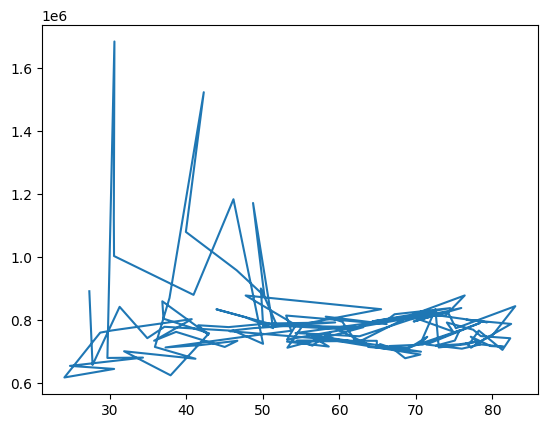

In [108]:
plt.plot(store_data['Temperature'], store_data['Weekly_Sales'])
plt.show()

Here there is no any identification of Relationship between Temperature and Weekly sales

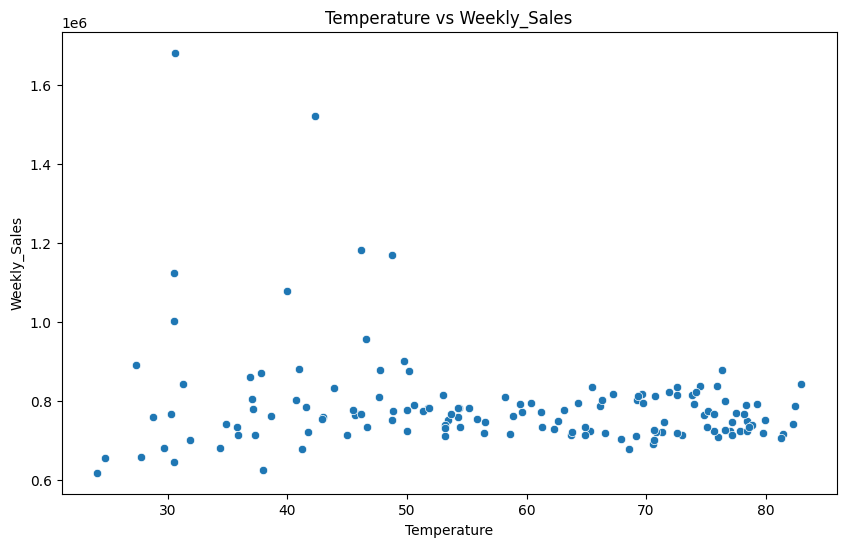

In [109]:
plt.figure(figsize=(10, 6))
sns.scatterplot(x='Temperature', y= 'Weekly_Sales', data=store_data)
plt.title('Temperature vs Weekly_Sales')
plt.xlabel('Temperature')
plt.ylabel('Weekly_Sales')
plt.show()

* Here the data is spreaded and there is no sign of trend between temprature and weekly sales

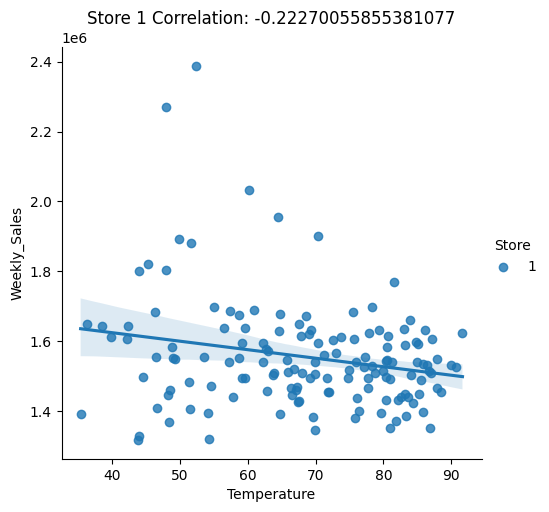

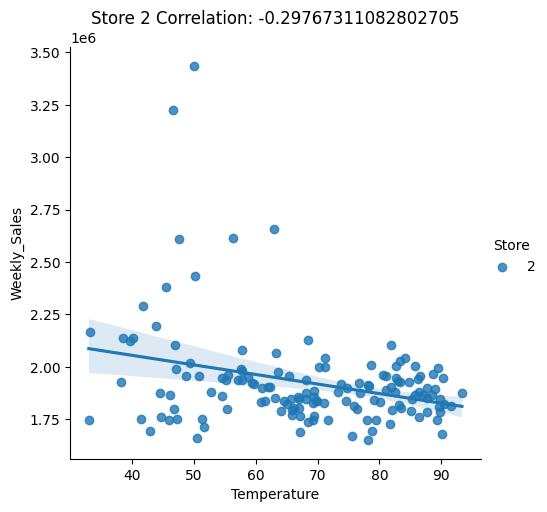

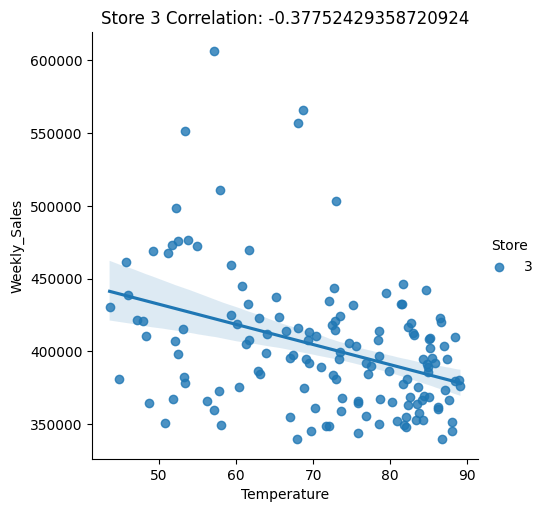

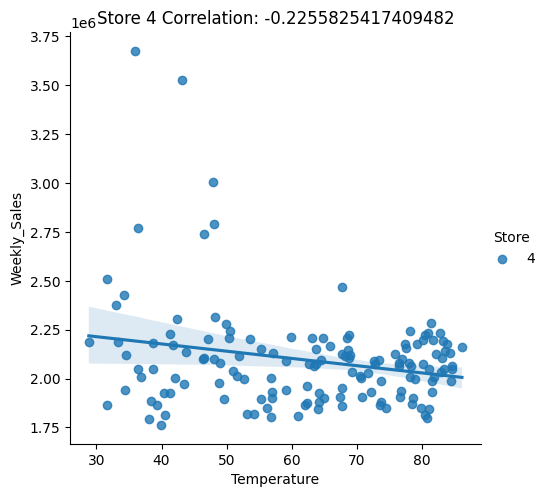

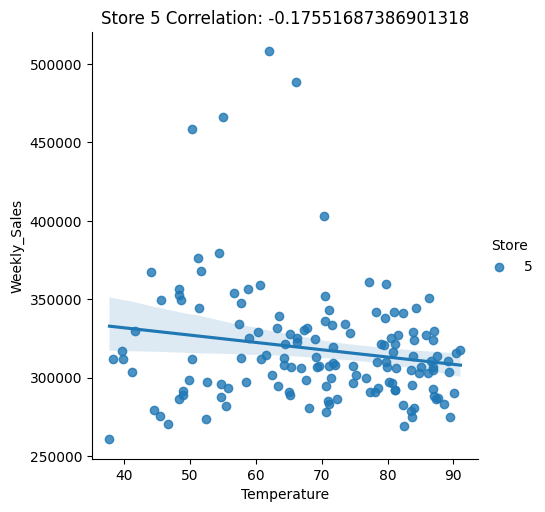

...

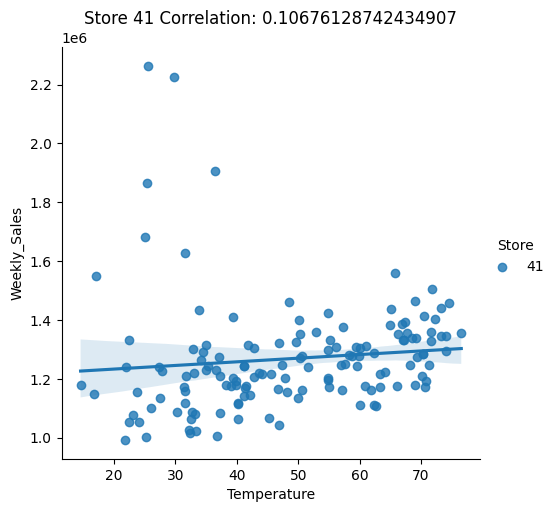

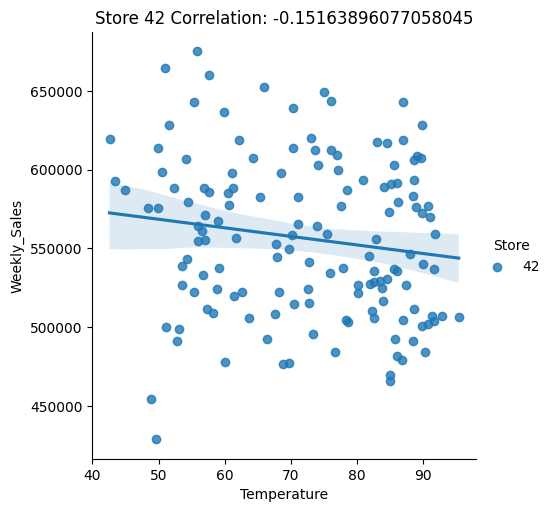

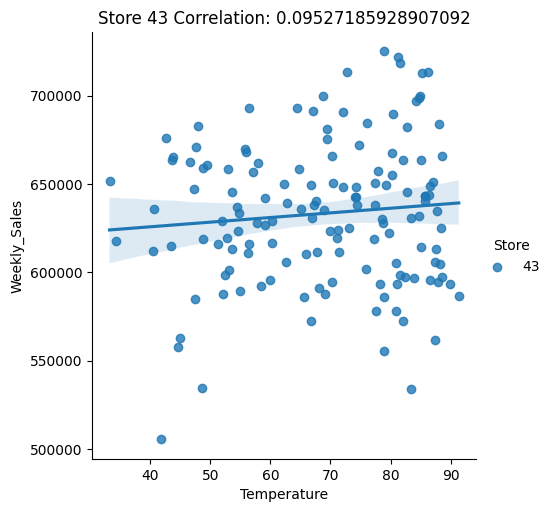

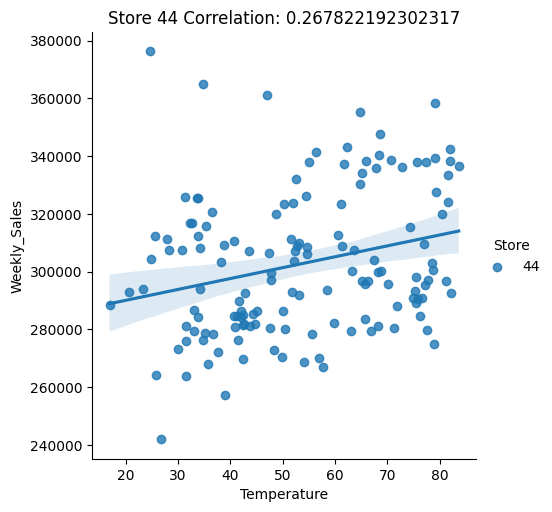

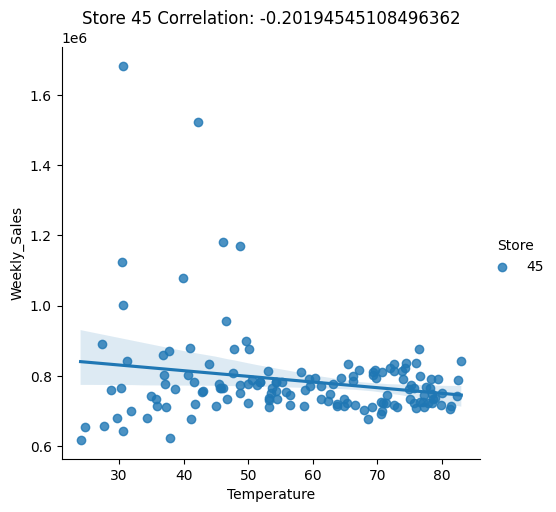

In [110]:
for i in df['Store'].unique():
  store_data = df[df['Store'] == i]
  correlation = store_data['Weekly_Sales'].corr(store_data['Temperature'])
  sns.lmplot(x='Temperature', y= 'Weekly_Sales', hue='Store', data=store_data)
  plt.title(f'Store {i} Correlation: {correlation}')
  plt.show()

In [111]:
from sklearn.linear_model import LinearRegression

x = df['Temperature'].values.reshape(-1, 1)
y = df['Weekly_Sales']

model = LinearRegression()
model.fit(x, y)
r2 = model.score(x, y)  # R-squared value
print("R² Score:", r2)
print("Slope (m):", model.coef_[0])
print("Intercept (c):", model.intercept_)

R² Score: 0.004071717781964135
Slope (m): -1952.4192272081975
Intercept (c): 1165406.0127923777


* Here also low R2 Score and high slope means there is no fit or relationship between Temperature and Weekly Sales

### How is the Consumer Price index affecting the weekly sales of various stores?

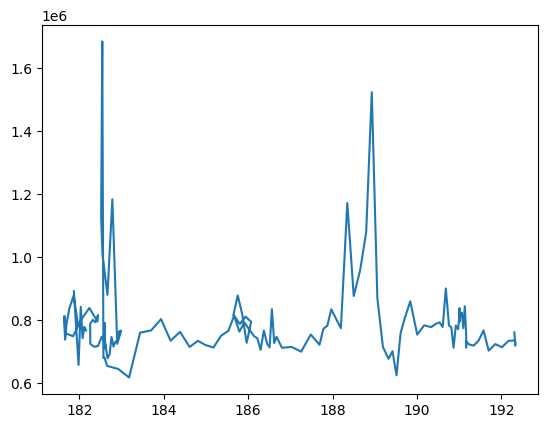

In [112]:
plt.plot(store_data['CPI'], store_data['Weekly_Sales'])
plt.show()

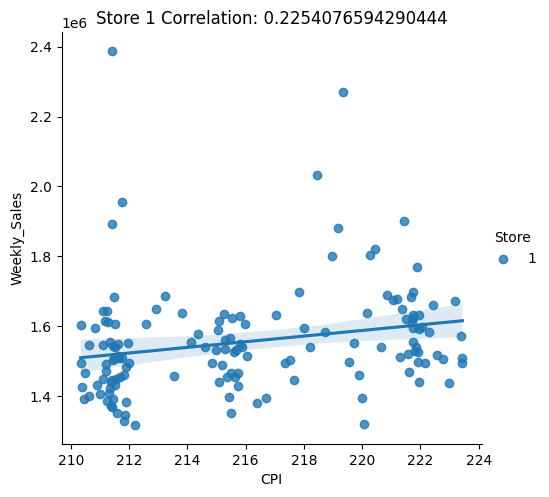

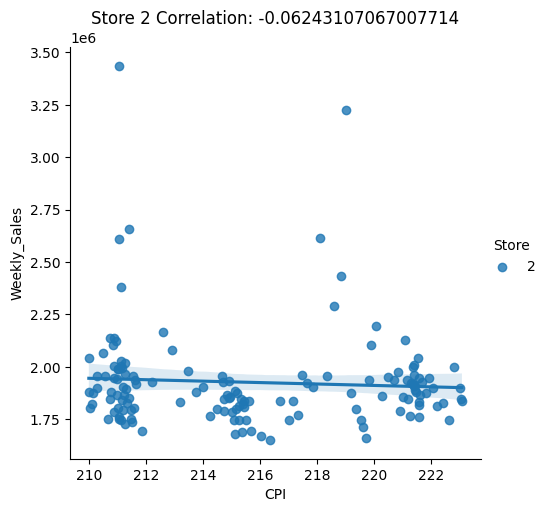

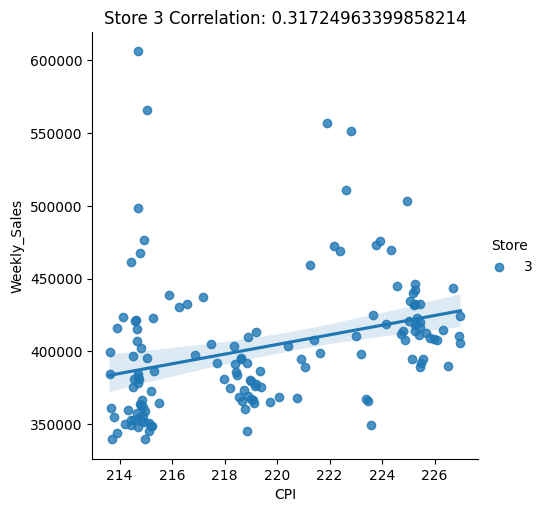

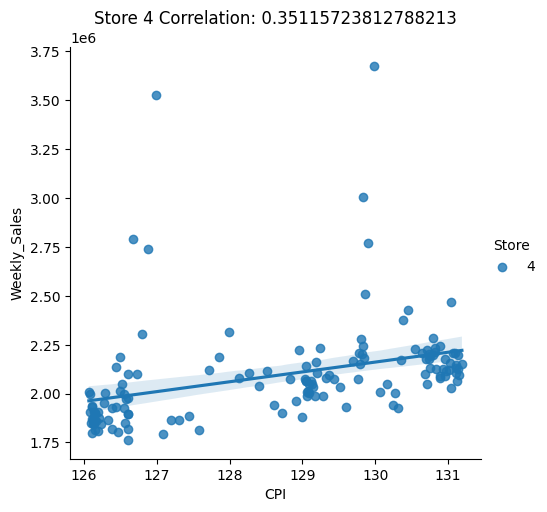

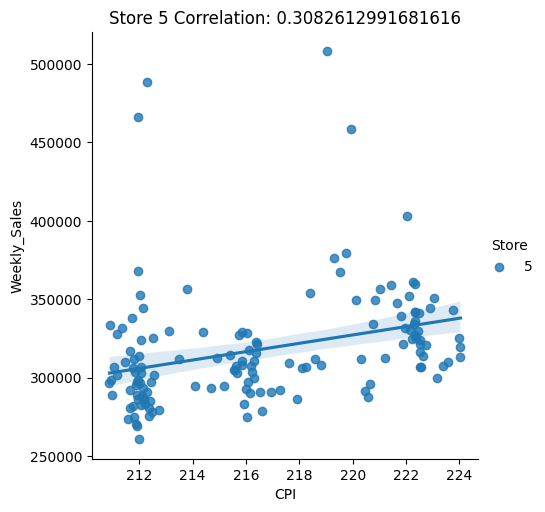

...

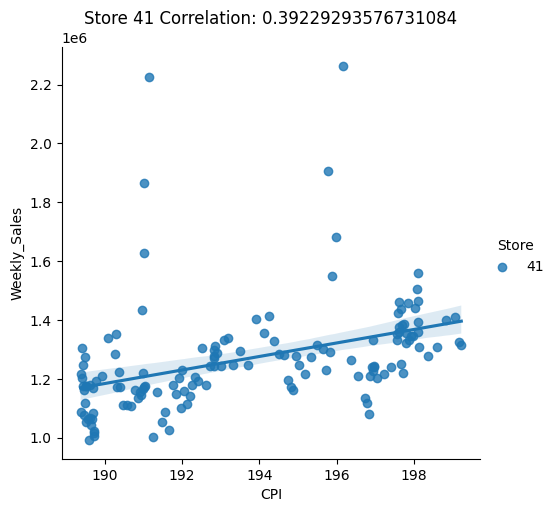

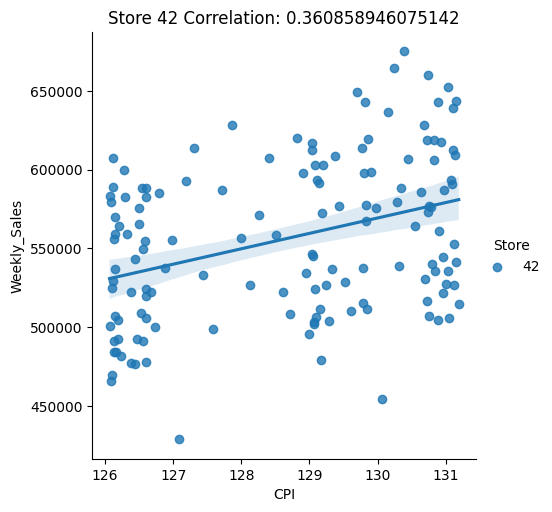

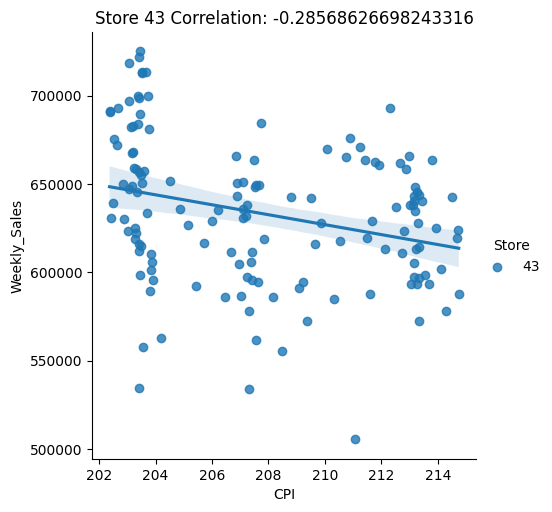

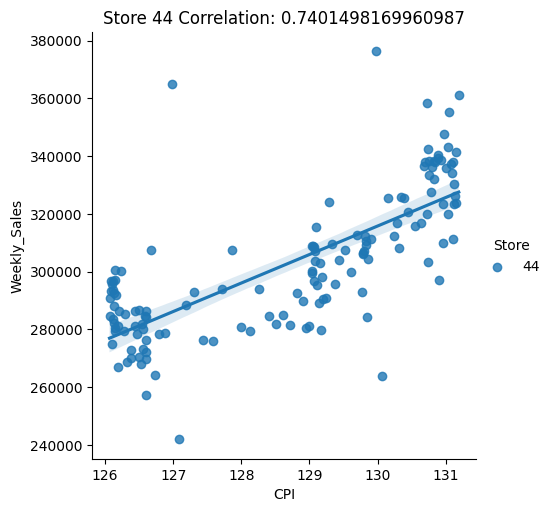

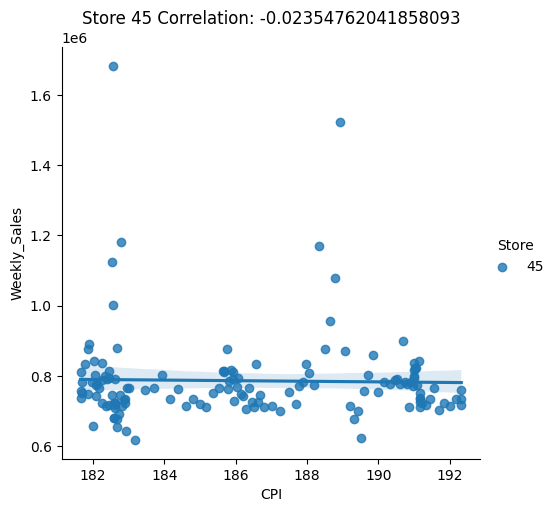

In [113]:
for i in df['Store'].unique():
  store_data = df[df['Store'] == i]
  correlation = store_data['Weekly_Sales'].corr(store_data['CPI'])
  sns.lmplot(x='CPI', y= 'Weekly_Sales', hue='Store', data=store_data)
  plt.title(f'Store {i} Correlation: {correlation}')
  plt.show()

In [114]:
x = df['CPI'].values.reshape(-1, 1)
y = df['Weekly_Sales']
# x = store_data['CPI'].values.reshape(-1, 1)
# y = store_data['Weekly_Sales']

model = LinearRegression()
model.fit(x, y)
r2 = model.score(x, y)  # R-squared value
print("R² Score:", r2)
print("Slope (m):", model.coef_[0])
print("Intercept (c):", model.intercept_)

R² Score: 0.005275721495278551
Slope (m): -1041.557952513
Intercept (c): 1225673.7181543761


* Here Based on low R2 Score and high Slope, there is no fit or relationship between Weekly Sales and CPI

### Top performing stores according to the historical data.

Top 10 Performing Stores : Store
20    3.013978e+08
4     2.995440e+08
14    2.889999e+08
13    2.865177e+08
2     2.753824e+08
10    2.716177e+08
27    2.538559e+08
6     2.237561e+08
1     2.224028e+08
39    2.074455e+08
Name: Weekly_Sales, dtype: float64


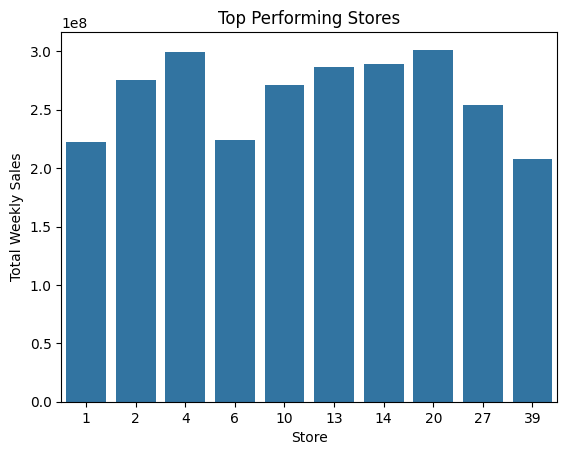

In [115]:
top_stores = df.groupby('Store')['Weekly_Sales'].sum().sort_values(ascending=False).head(10)
print(f'Top 10 Performing Stores : {top_stores}')
sns.barplot(x=top_stores.index, y=top_stores.values)
plt.title('Top Performing Stores')
plt.xlabel('Store')
plt.ylabel('Total Weekly Sales')
plt.show()

### The worst performing store, and how significant is the difference between the highest and lowest performing stores.


Worst 10 Performing Stores : Store
33    37160221.96
44    43293087.84
5     45475688.90
36    53412214.97
38    55159626.42
3     57586735.07
30    62716885.12
37    74202740.32
16    74252425.40
29    77141554.31
Name: Weekly_Sales, dtype: float64


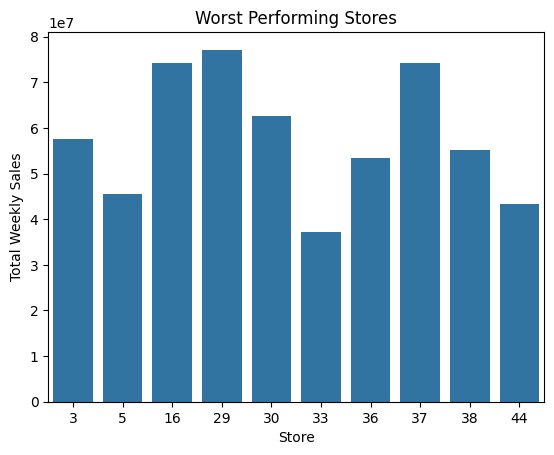

In [116]:
worst_stores = df.groupby('Store')['Weekly_Sales'].sum().sort_values(ascending=True).head(10)
print(f'Worst 10 Performing Stores : {worst_stores}')
sns.barplot(x=worst_stores.index, y=worst_stores.values)
plt.title('Worst Performing Stores')
plt.xlabel('Store')
plt.ylabel('Total Weekly Sales')
plt.show()

### Use predictive modeling techniques to forecast the sales for each store for the next 12 weeks.

In [117]:
# dfp = df.drop(columns=['Temperature', 'Fuel_Price', 'CPI', 'Unemployment'])
# dfp
for i in df1.index.get_level_values('Store').unique():
  storeData = df1.loc[i]
  print(store_data['Weekly_Sales'])

6292    890689.51
6293    656988.64
6294    841264.04
6295    741891.65
6296    777951.22
          ...    
6430    713173.95
6431    733455.07
6432    734464.36
6433    718125.53
6434    760281.43
Name: Weekly_Sales, Length: 143, dtype: float64
6292    890689.51
6293    656988.64
6294    841264.04
6295    741891.65
6296    777951.22
          ...    
6430    713173.95
6431    733455.07
6432    734464.36
6433    718125.53
6434    760281.43
Name: Weekly_Sales, Length: 143, dtype: float64
6292    890689.51
6293    656988.64
6294    841264.04
6295    741891.65
6296    777951.22
          ...    
6430    713173.95
6431    733455.07
6432    734464.36
6433    718125.53
6434    760281.43
Name: Weekly_Sales, Length: 143, dtype: float64
6292    890689.51
6293    656988.64
6294    841264.04
6295    741891.65
6296    777951.22
          ...    
6430    713173.95
6431    733455.07
6432    734464.36
6433    718125.53
6434    760281.43
Name: Weekly_Sales, Length: 143, dtype: float64
6292    890689.5

In [118]:
from statsmodels.tsa.stattools import adfuller
non_stationary = []
for i in df1.index.get_level_values('Store').unique():
  storeData = df1.loc[i]
  result = adfuller(storeData['Weekly_Sales'])
  if result[1] <= 0.05:
    print(f'Store {i} is stationary')
  else:
    non_stationary.append(i)
    print(f'Store {i} is not stationary')
  # print(f'Store {i} Stats Values: {result[0]}')
  # print(f'Store {i} p-value: {result[1]}')
print(f'Non Stationary Stores: {non_stationary}')

Store 1 is stationary
Store 2 is stationary
Store 3 is stationary
Store 4 is stationary
Store 5 is stationary
Store 6 is stationary
Store 7 is stationary
Store 8 is stationary
Store 9 is stationary
Store 10 is stationary
Store 11 is stationary
Store 12 is stationary
Store 13 is stationary
Store 14 is not stationary
Store 15 is stationary
Store 16 is stationary
Store 17 is stationary
Store 18 is stationary
Store 19 is stationary
Store 20 is stationary
Store 21 is stationary
Store 22 is stationary
Store 23 is stationary
Store 24 is stationary
Store 25 is stationary
Store 26 is stationary
Store 27 is stationary
Store 28 is stationary
Store 29 is stationary
Store 30 is not stationary
Store 31 is stationary
Store 32 is stationary
Store 33 is stationary
Store 34 is stationary
Store 35 is stationary
Store 36 is not stationary
Store 37 is stationary
Store 38 is not stationary
Store 39 is stationary
Store 40 is stationary
Store 41 is stationary
Store 42 is not stationary
Store 43 is not station

* p -value is <  0.05 , So our data is stationary

* Stores `[14, 30, 36, 38, 42, 43, 44]` are non stationary so we have to apply constant variance and constant mean to make it stationary

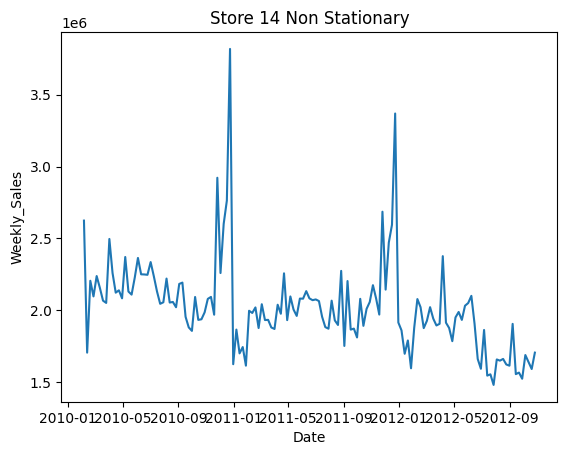

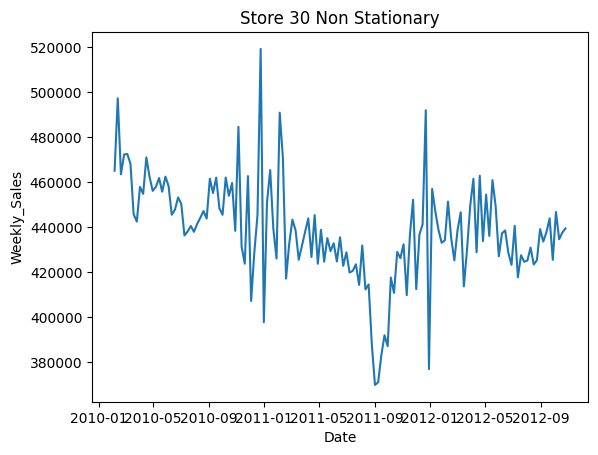

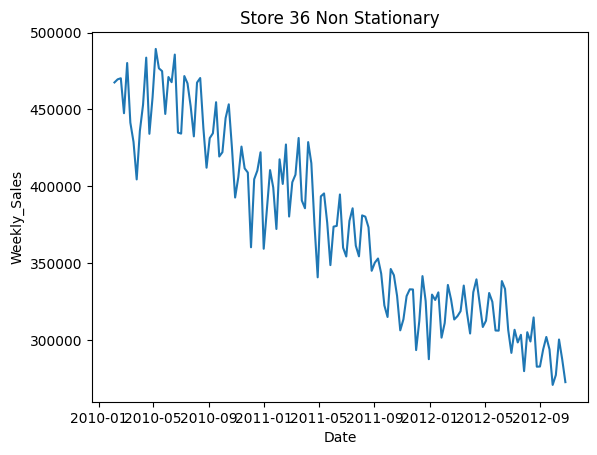

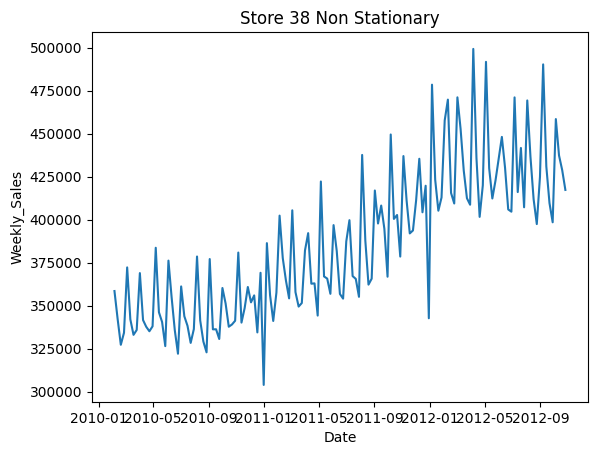

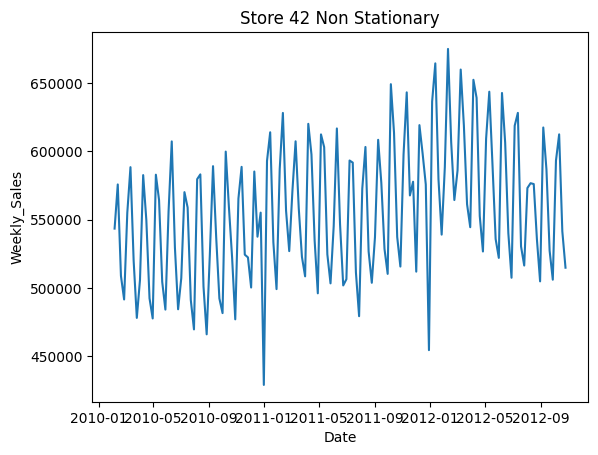

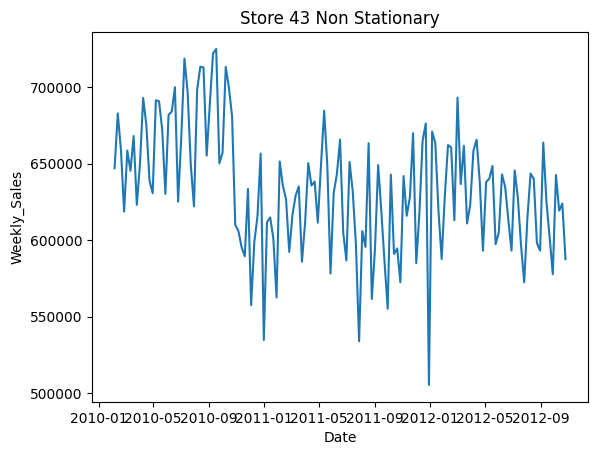

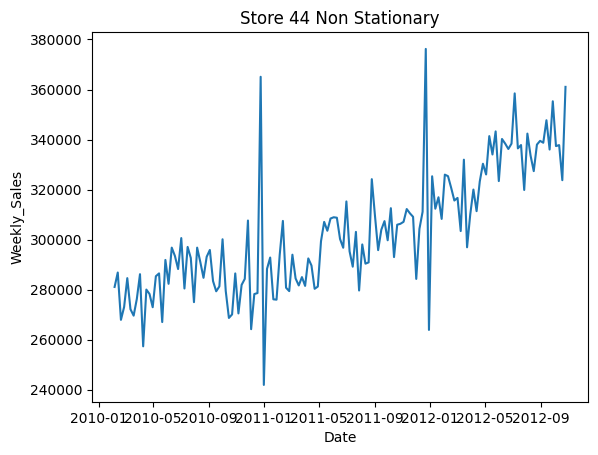

In [119]:
for i in non_stationary:
  storeData = df1.loc[i]
  sns.lineplot(x=storeData.index, y=storeData['Weekly_Sales'])
  plt.title(f'Store {i} Non Stationary')
  plt.show()

In [120]:
# Removing all other columns
df2 = df1['Weekly_Sales']
print(type(df2))
print(type(df1))

<class 'pandas.core.series.Series'>
<class 'pandas.core.frame.DataFrame'>


Store 1 -> Train: 131 weeks, Test: 12 weeks


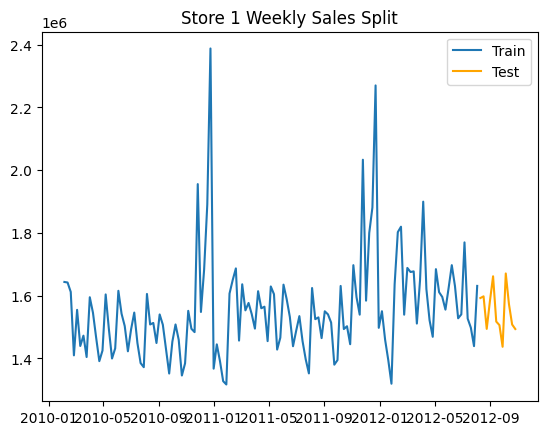

Store 2 -> Train: 131 weeks, Test: 12 weeks


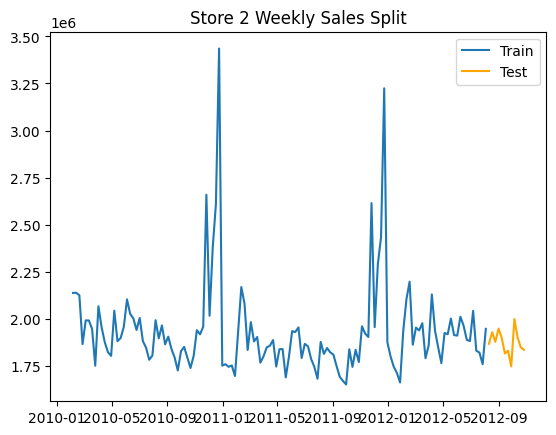

Store 3 -> Train: 131 weeks, Test: 12 weeks


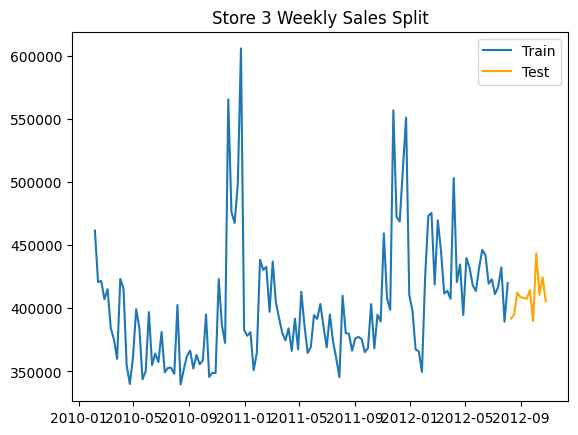

Store 4 -> Train: 131 weeks, Test: 12 weeks


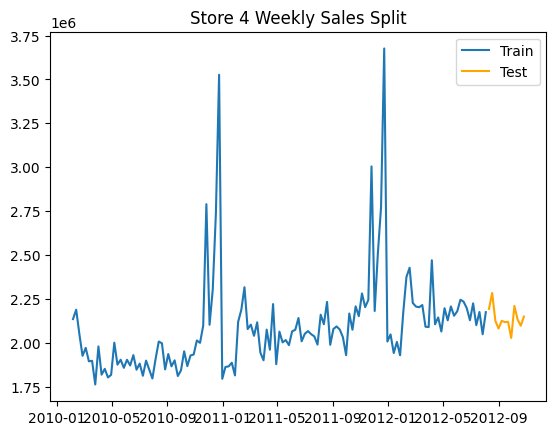

Store 5 -> Train: 131 weeks, Test: 12 weeks


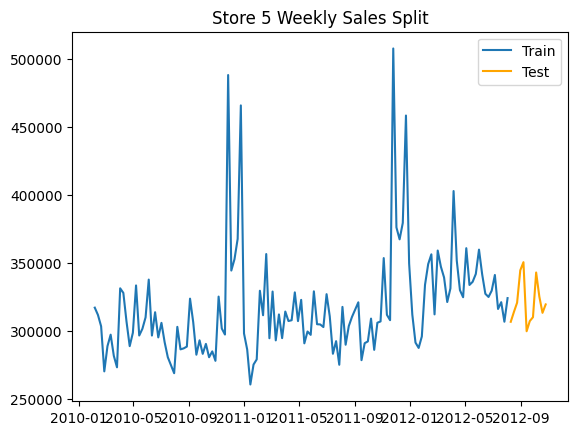

Store 6 -> Train: 131 weeks, Test: 12 weeks


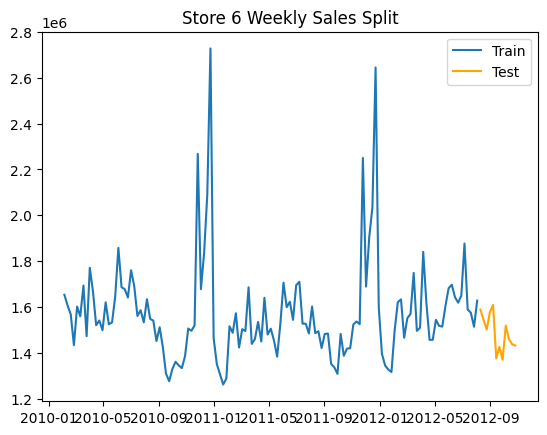

Store 7 -> Train: 131 weeks, Test: 12 weeks


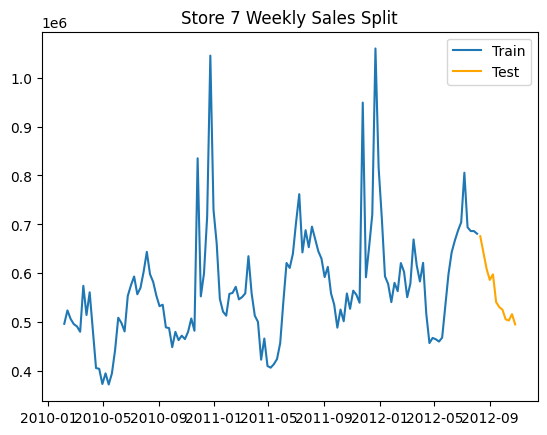

Store 8 -> Train: 131 weeks, Test: 12 weeks


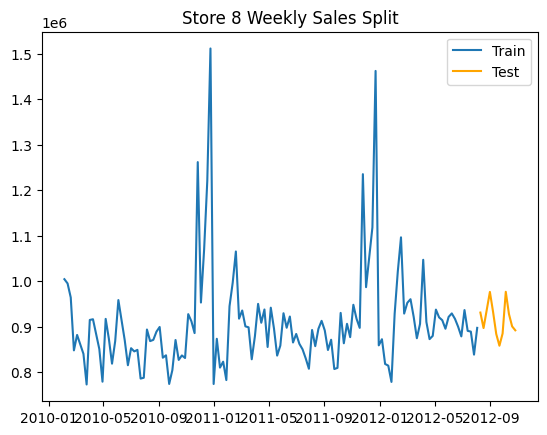

Store 9 -> Train: 131 weeks, Test: 12 weeks


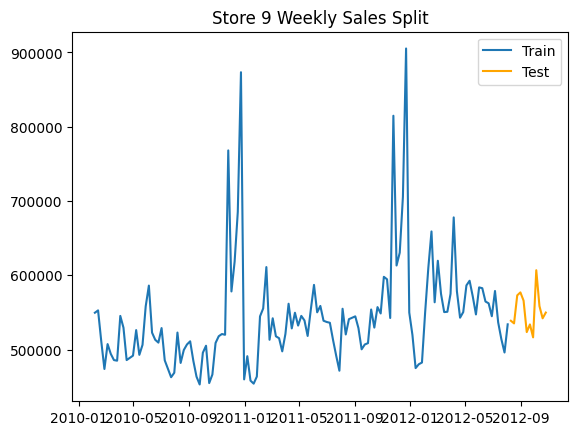

Store 10 -> Train: 131 weeks, Test: 12 weeks


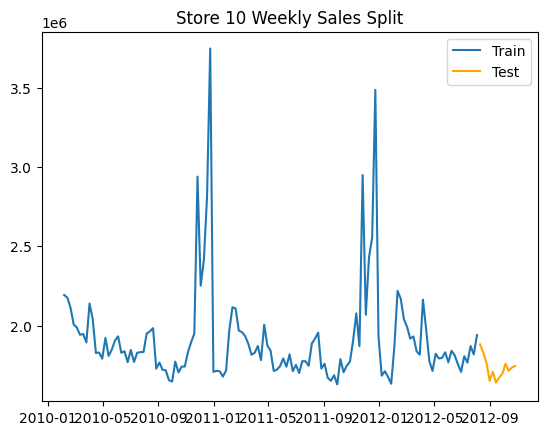

Store 11 -> Train: 131 weeks, Test: 12 weeks


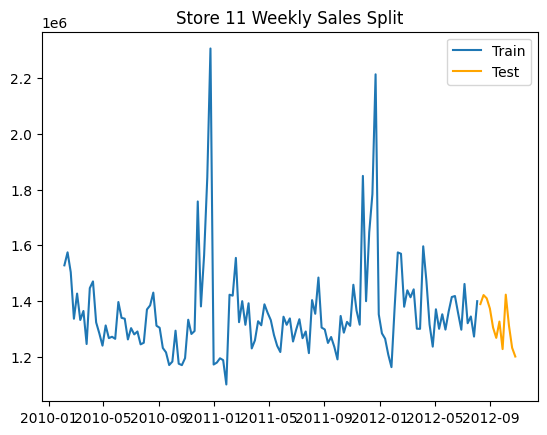

Store 12 -> Train: 131 weeks, Test: 12 weeks


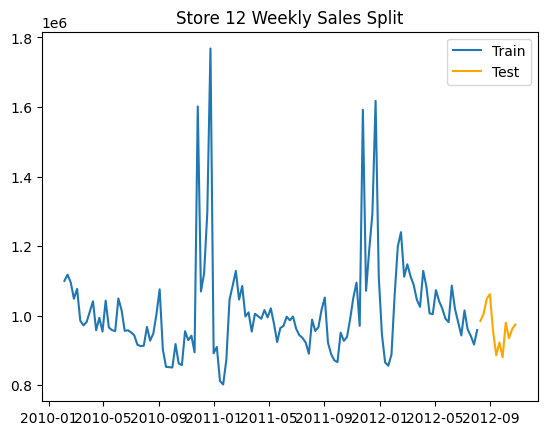

Store 13 -> Train: 131 weeks, Test: 12 weeks


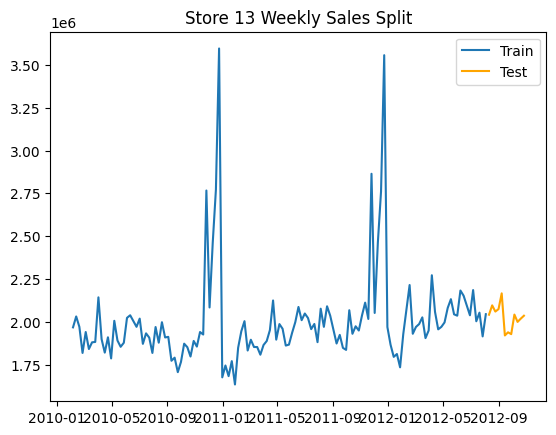

Store 14 -> Train: 131 weeks, Test: 12 weeks


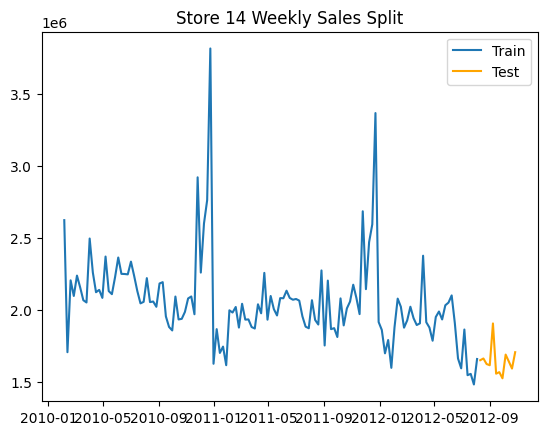

Store 15 -> Train: 131 weeks, Test: 12 weeks


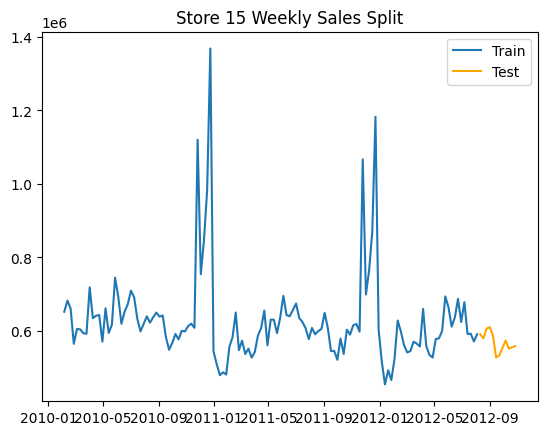

Store 16 -> Train: 131 weeks, Test: 12 weeks


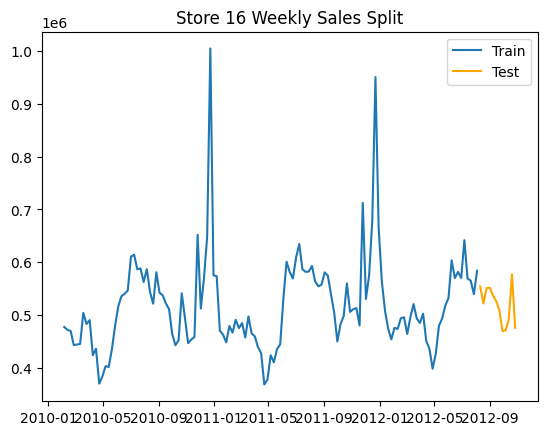

Store 17 -> Train: 131 weeks, Test: 12 weeks


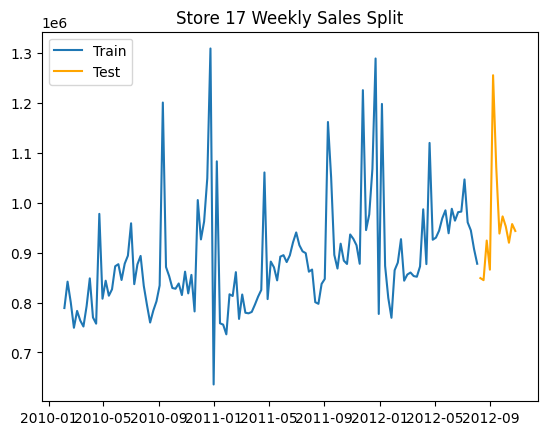

Store 18 -> Train: 131 weeks, Test: 12 weeks


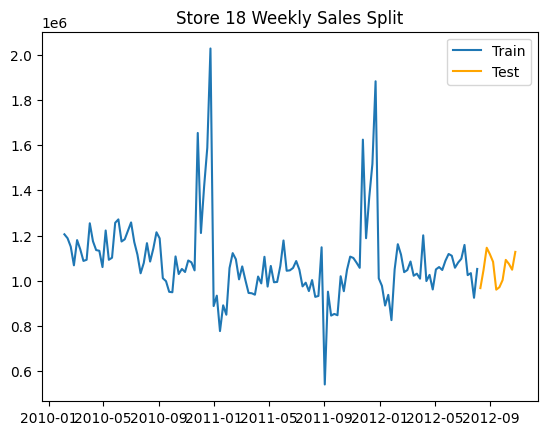

Store 19 -> Train: 131 weeks, Test: 12 weeks


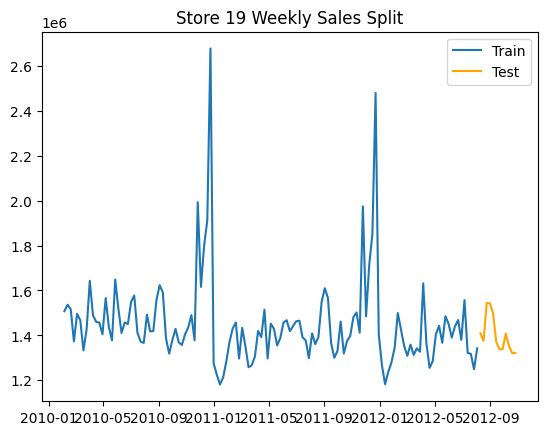

Store 20 -> Train: 131 weeks, Test: 12 weeks


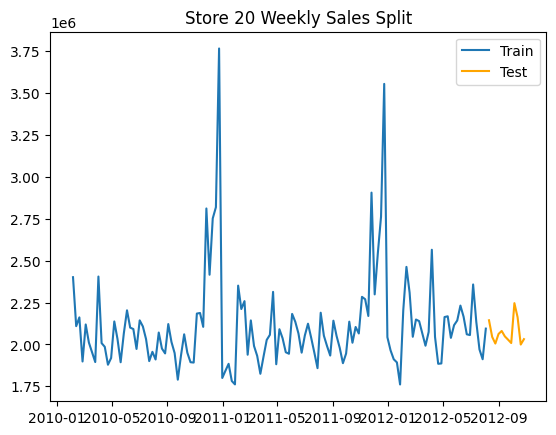

Store 21 -> Train: 131 weeks, Test: 12 weeks


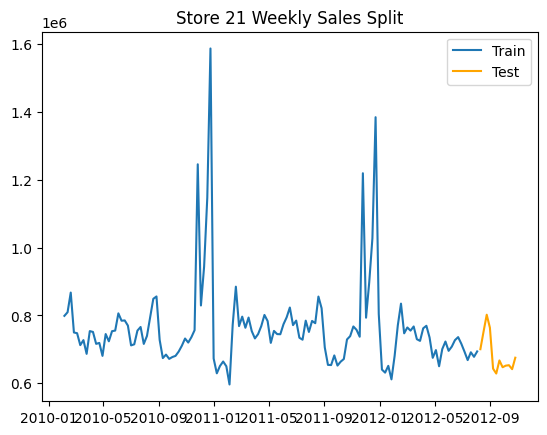

Store 22 -> Train: 131 weeks, Test: 12 weeks


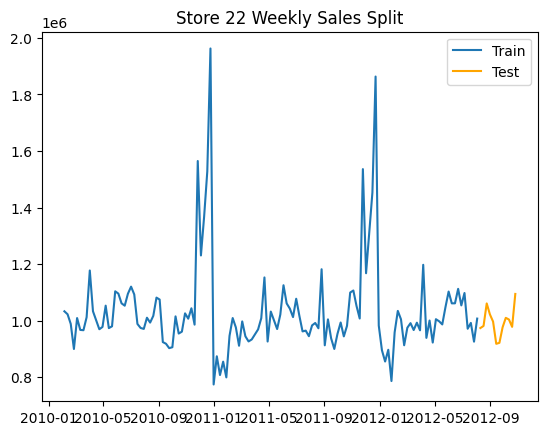

Store 23 -> Train: 131 weeks, Test: 12 weeks


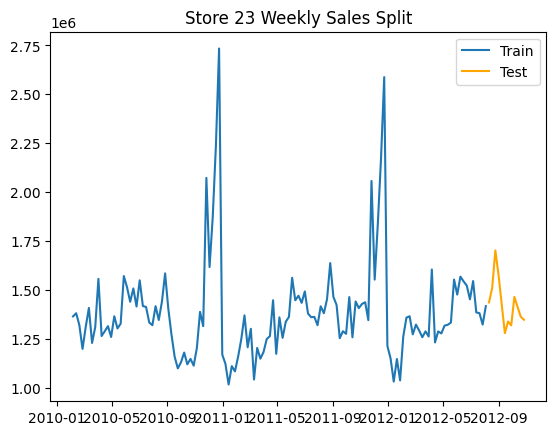

Store 24 -> Train: 131 weeks, Test: 12 weeks


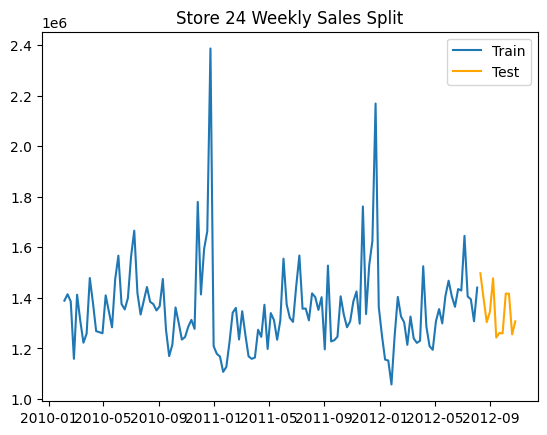

Store 25 -> Train: 131 weeks, Test: 12 weeks


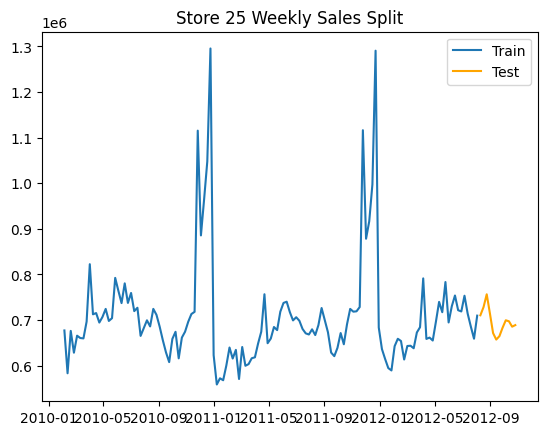

Store 26 -> Train: 131 weeks, Test: 12 weeks


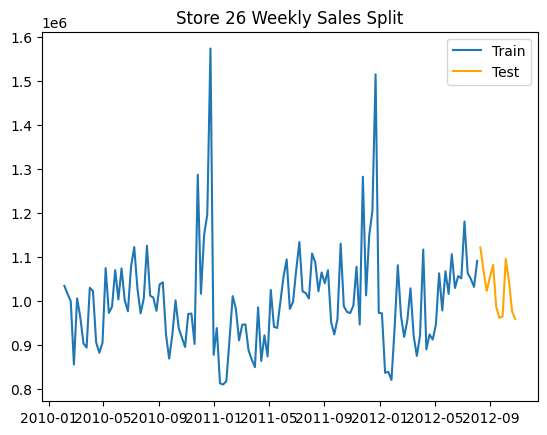

Store 27 -> Train: 131 weeks, Test: 12 weeks


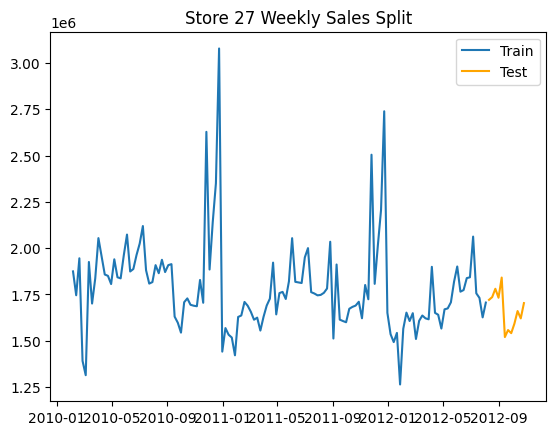

Store 28 -> Train: 131 weeks, Test: 12 weeks


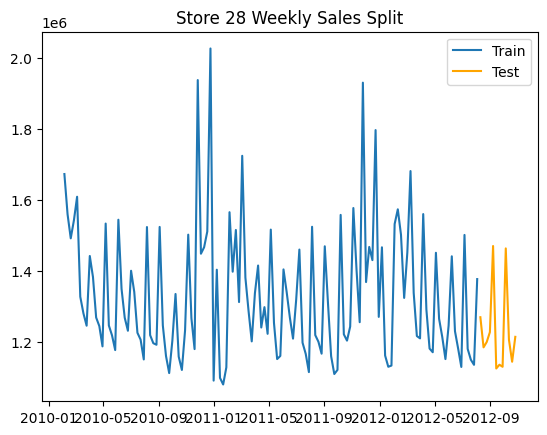

Store 29 -> Train: 131 weeks, Test: 12 weeks


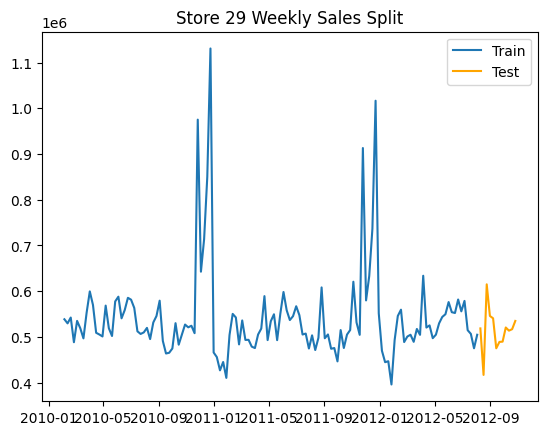

Store 30 -> Train: 131 weeks, Test: 12 weeks


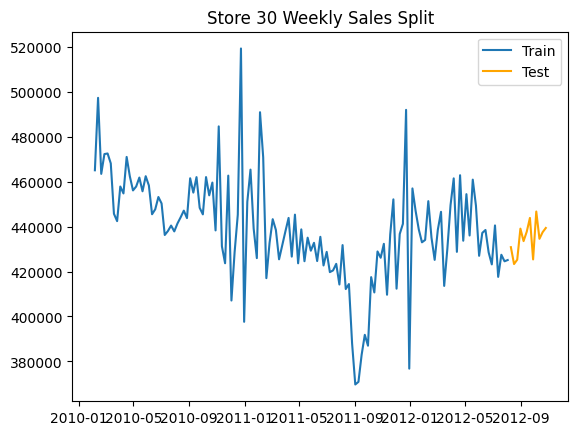

Store 31 -> Train: 131 weeks, Test: 12 weeks


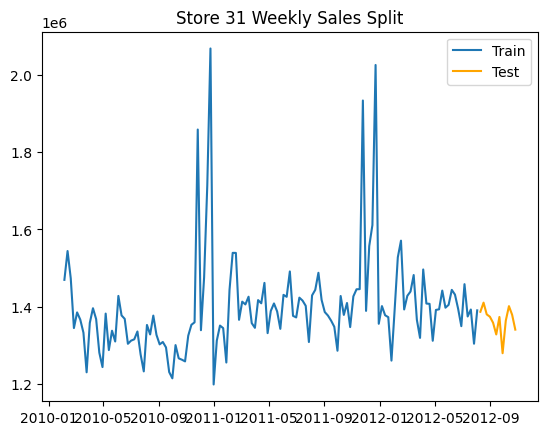

Store 32 -> Train: 131 weeks, Test: 12 weeks


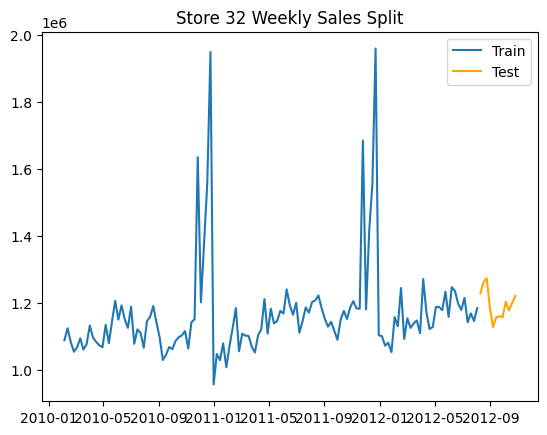

Store 33 -> Train: 131 weeks, Test: 12 weeks


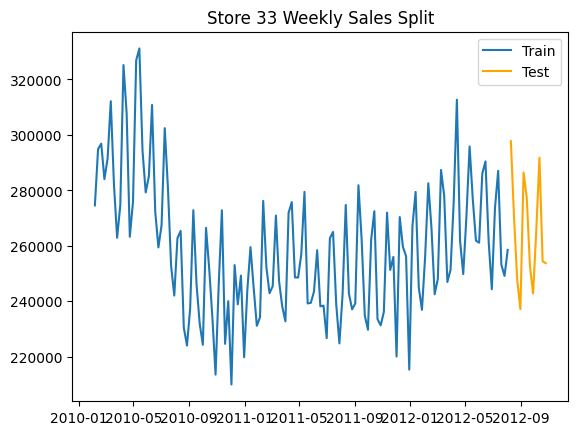

Store 34 -> Train: 131 weeks, Test: 12 weeks


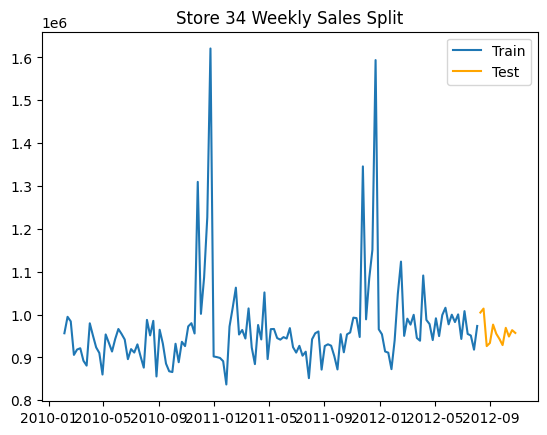

Store 35 -> Train: 131 weeks, Test: 12 weeks


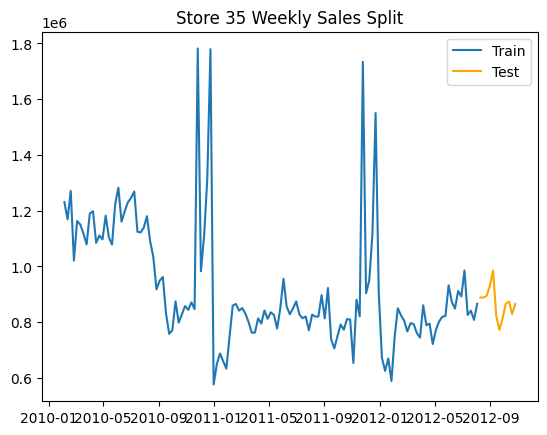

Store 36 -> Train: 131 weeks, Test: 12 weeks


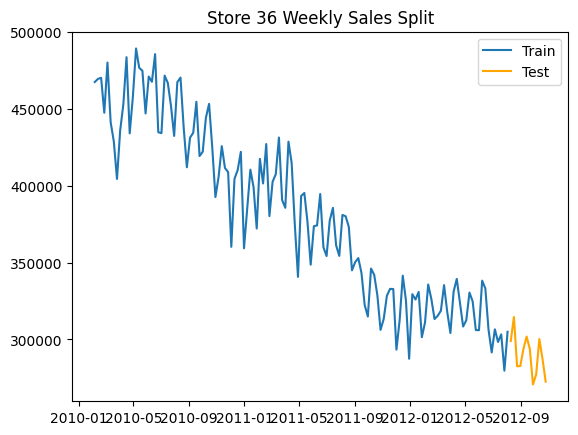

Store 37 -> Train: 131 weeks, Test: 12 weeks


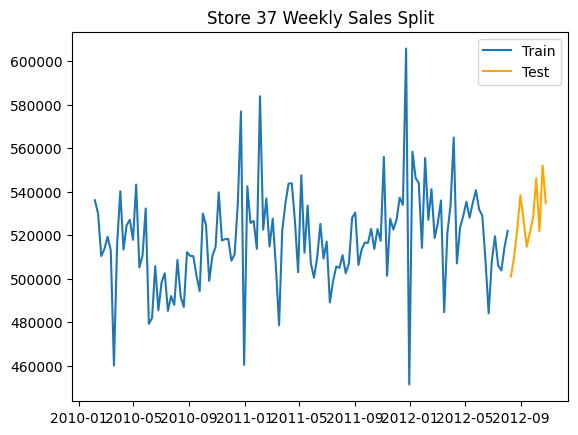

Store 38 -> Train: 131 weeks, Test: 12 weeks


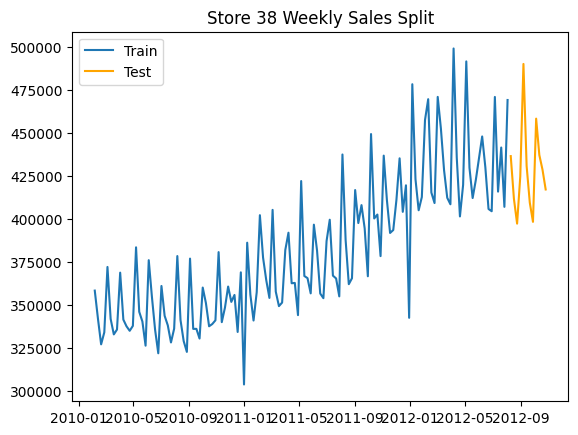

Store 39 -> Train: 131 weeks, Test: 12 weeks


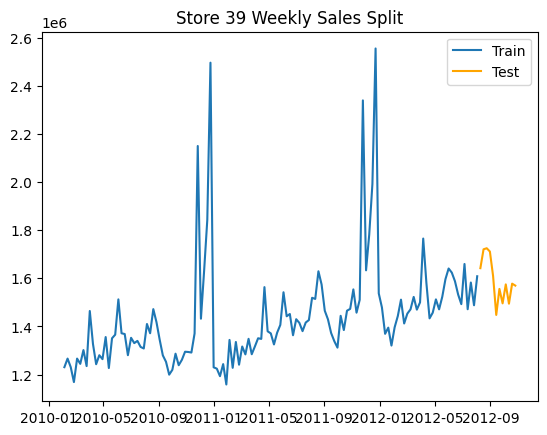

Store 40 -> Train: 131 weeks, Test: 12 weeks


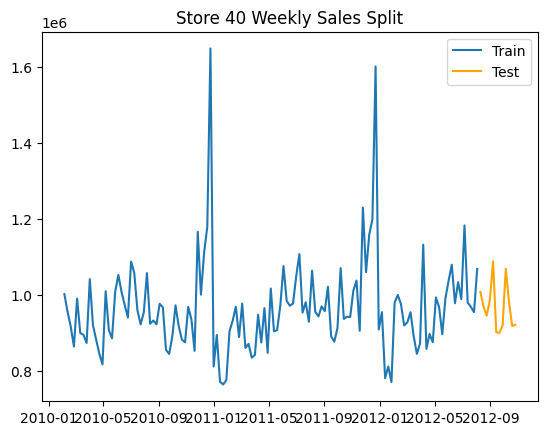

Store 41 -> Train: 131 weeks, Test: 12 weeks


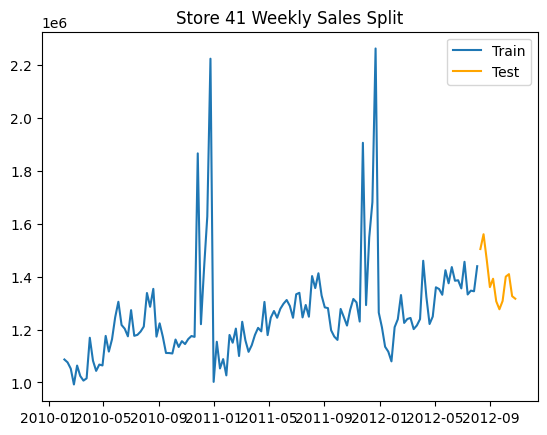

Store 42 -> Train: 131 weeks, Test: 12 weeks


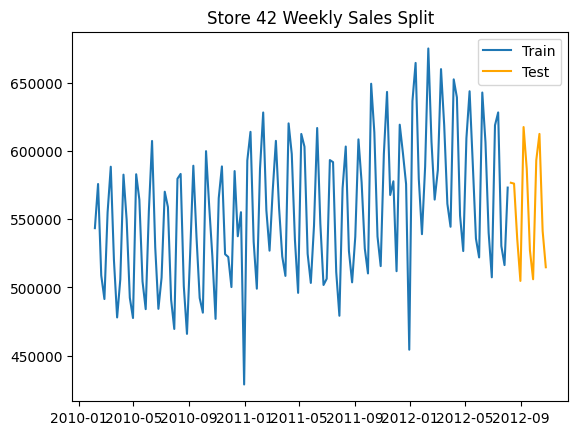

Store 43 -> Train: 131 weeks, Test: 12 weeks


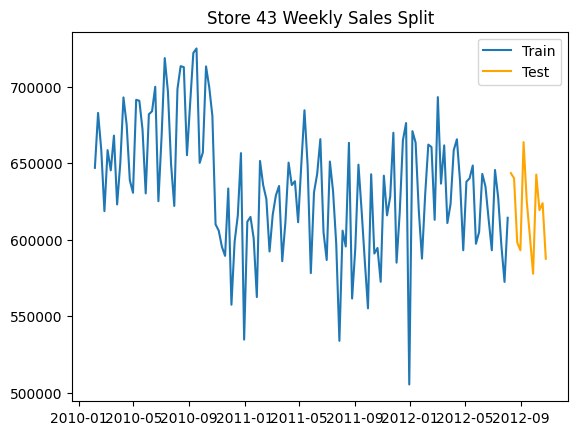

Store 44 -> Train: 131 weeks, Test: 12 weeks


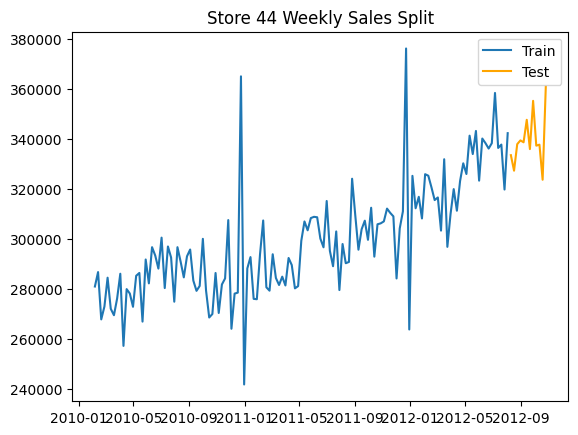

Store 45 -> Train: 131 weeks, Test: 12 weeks


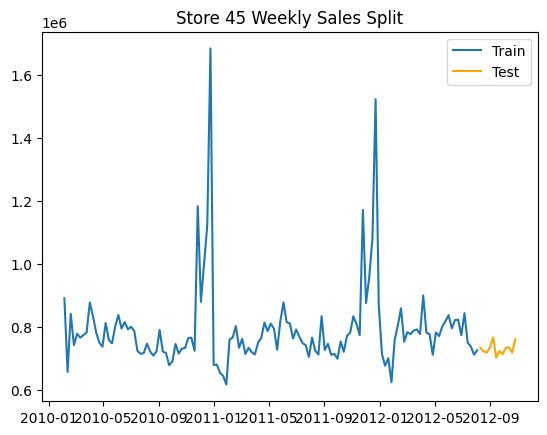

In [121]:
forecast_weeks = 12

for store_id in df2.index.get_level_values('Store').unique():

    store_data = df2[store_id]

    store_data = store_data.sort_index()

    train = store_data[:-forecast_weeks]
    test = store_data[-forecast_weeks:]

    print(f"Store {store_id} -> Train: {train.shape[0]} weeks, Test: {test.shape[0]} weeks")

    plt.plot(train.index, train, label='Train')
    plt.plot(test.index, test, label='Test', color='orange')
    plt.title(f'Store {store_id} Weekly Sales Split')
    plt.legend()
    plt.show()


* First we perform Boxcox to make variance constant

In [122]:
from statsmodels.tsa.stattools import adfuller
#Helper function for seasonality check
def is_stationary(x):
  result = adfuller(x)
  if result[1] <= 0.05:
    return True
  else:
    return False

In [123]:
from scipy.stats import boxcox
# def apply_boxcox(x, index, lamda=0):
#   return pd.Series(boxcox(x, lmbda=lamda), index=index)

def apply_boxcox(x, index):
    transformed, fitted_lambda = boxcox(x)
    return pd.Series(transformed, index=index), fitted_lambda


#Helper function for ARIMA model to inverse to original data
def inverse_boxcox_ARIMA(x,pred):
  x_reverse = pd.concat([x, pred])
  x_boxcox_pred = x_reverse.cumsum()
  x_boxcox_pred = x_boxcox_pred.add(x[0])
  return np.exp(x_boxcox_pred)


# Helper Function for SARIMA model to inverse to original data
# def inverse_boxcox_SARIMA(x, pred):
#   x_reverse = pd.concat([x, pred])
#   return np.exp(x_reverse)

from scipy.special import inv_boxcox

def inverse_boxcox_SARIMA(boxcox_series, pred_series, fitted_lambda):
    full_series = pd.concat([boxcox_series, pred_series])
    return pd.Series(inv_boxcox(full_series, fitted_lambda), index=full_series.index)



In [124]:
from statsmodels.tsa.statespace.sarimax import SARIMAX
from statsmodels.tsa.arima.model import ARIMA
from scipy.stats import boxcox
from sklearn.metrics import mean_absolute_error, mean_absolute_percentage_error, mean_squared_error, root_mean_squared_error, r2_score

def seasonal_prediction(train, test, i):
  # Select only the 'Weekly_Sales' column for modeling and evaluation
  train_sales = train['Weekly_Sales'].asfreq('W-FRI')
  test_sales = test['Weekly_Sales'].asfreq('W-FRI')

  # is_stationary(train_sales) # This helper function expects a Series

  # Apply Box-Cox transformation to the training sales data
  # We use lmbda=0 which is equivalent to log transformation
  df_boxcox = pd.Series(boxcox(train['Weekly_Sales'], lmbda = 0), index = train.index)


  # ar_model = ARIMA(df_boxcox, order = (1, 0, 1))
  # ar_model = ar_model.fit()

  sarimax_model = SARIMAX(df_boxcox, order=(1,0,1), seasonal_order=(1,0,1,52))
  sarimax_model = sarimax_model.fit()

  # Predict on the test set (in the boxcox transformed space)
  start = test_sales.index[0]
  end = test_sales.index[-1]
  # sarimax_pred = ar_model.predict(start=start, end=end)
  sarimax_pred_boxcox = sarimax_model.predict(start=start, end=end)
  print(f'Predicted Boxcox Values are : {sarimax_pred_boxcox}')

  # Inverse Box-Cox transformation to get predictions in the original scale
  sarimax_boxcox_preds = pd.concat([df_boxcox, sarimax_pred_boxcox])
  sarimax_preds = np.exp(sarimax_boxcox_preds)


  print(f'summary of the model is : {sarimax_model.summary()}')

  # Evaluate performance using the original test data and inverse-transformed predictions
  # print(f'Predicted Values are : {sarimax_preds}')
  # print(f'Mean Absolute Error: {mean_absolute_error(test_sales, sarimax_preds[131:])}')
  # print(f'Mean Absolute Percentage Error: {mean_absolute_percentage_error(test_sales, sarimax_preds[131:])}')
  # print(f'Mean Squared Error: {mean_squared_error(test_sales, sarimax_preds[131:])}')
  # print(f'Root Mean Squared Error: {root_mean_squared_error(test_sales, sarimax_preds[131:])}')
  # print(f'R2 Score: {r2_score(test_sales, sarimax_preds[131:])}')
  metrics = {
    'Store': i,
    'MAE': mean_absolute_error(test_sales, sarimax_preds[131:]),
    'MAPE': mean_absolute_percentage_error(test_sales, sarimax_preds[131:]),
    'MSE': mean_squared_error(test_sales, sarimax_preds[131:]),
    'RMSE': root_mean_squared_error(test_sales, sarimax_preds[131:]),
    'R2': r2_score(test_sales, sarimax_preds[131:])
  }

  # Forecast future values (in the boxcox transformed space)
  future_dates = pd.date_range(start=test_sales.index[-1] + pd.Timedelta(weeks=1), periods=12, freq='W-FRI')
  forecast_future_boxcox = sarimax_model.forecast(steps=12)
  forecast_future_boxcox.index = future_dates

  # Inverse Box-Cox transformation for future forecast
  forecast_future = np.exp(forecast_future_boxcox)


  # Plotting
  plt.figure(figsize=(12, 6)) # Add a figure size for better visualization
  plt.plot(train_sales.index, train_sales, label='Train')
  plt.plot(test_sales.index, test_sales, label='Test', color='orange')
  plt.plot(sarimax_preds.index, sarimax_preds, label='Predicted', color='red')
  plt.plot(forecast_future.index, forecast_future, label='Forecast Future 12 Weeks', color='red', linestyle='--')
  plt.title(f'Store {i} Weekly Sales Split and Forecast') # Use store_id from the calling scope
  plt.xlabel('Date') # Add x-axis label
  plt.ylabel('Weekly Sales') # Add y-axis label
  plt.legend()
  plt.xticks(rotation=45) # Rotate x-axis labels for better readability
  plt.tight_layout() # Adjust layout to prevent labels overlapping
  plt.show()
  return sarimax_preds, metrics # Return the predictions on the test set in original scale

Store 1 -> Train: 131 weeks, Test: 12 weeks
Predicted Boxcox Values are : 2012-08-10    14.291630
2012-08-17    14.294909
2012-08-24    14.253495
2012-08-31    14.308901
2012-09-07    14.296829
2012-09-14    14.266383
2012-09-21    14.193044
2012-09-28    14.227826
2012-10-05    14.328137
2012-10-12    14.266880
2012-10-19    14.237519
2012-10-26    14.227692
Freq: W-FRI, Name: predicted_mean, dtype: float64
summary of the model is :                                      SARIMAX Results                                      
Dep. Variable:                                  y   No. Observations:                  131
Model:             SARIMAX(1, 0, 1)x(1, 0, 1, 52)   Log Likelihood                 180.065
Date:                            Thu, 15 May 2025   AIC                           -350.130
Time:                                    10:08:24   BIC                           -335.754
Sample:                                02-05-2010   HQIC                          -344.288
                

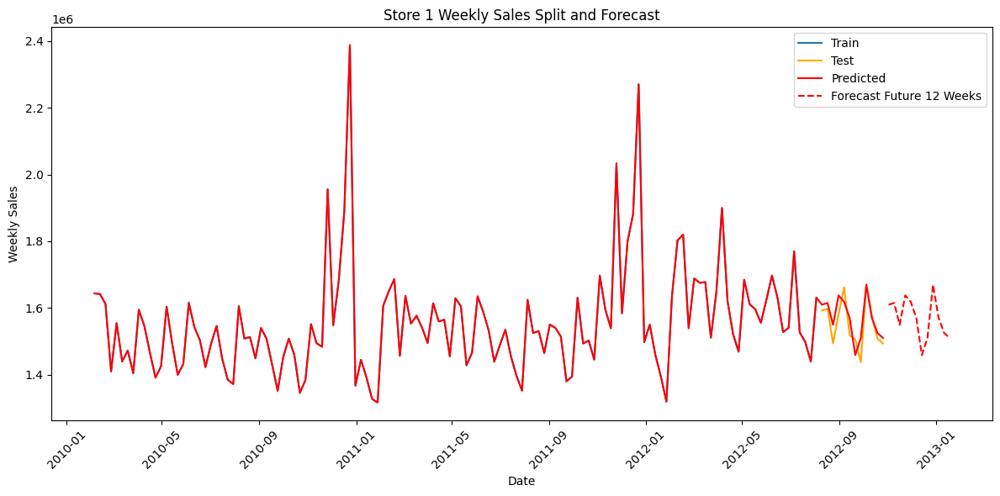

Store 2 -> Train: 131 weeks, Test: 12 weeks
Predicted Boxcox Values are : 2012-08-10    14.449528
2012-08-17    14.471478
2012-08-24    14.447209
2012-08-31    14.449575
2012-09-07    14.416657
2012-09-14    14.387795
2012-09-21    14.367141
2012-09-28    14.377622
2012-10-05    14.450437
2012-10-12    14.407355
2012-10-19    14.430123
2012-10-26    14.418021
Freq: W-FRI, Name: predicted_mean, dtype: float64
summary of the model is :                                      SARIMAX Results                                      
Dep. Variable:                                  y   No. Observations:                  131
Model:             SARIMAX(1, 0, 1)x(1, 0, 1, 52)   Log Likelihood                 169.445
Date:                            Thu, 15 May 2025   AIC                           -328.891
Time:                                    10:08:29   BIC                           -314.515
Sample:                                02-05-2010   HQIC                          -323.049
                

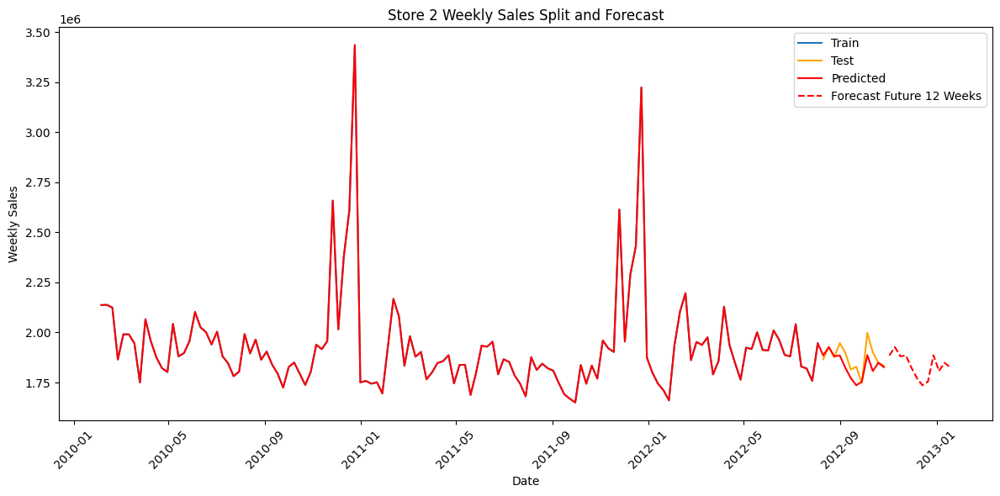

Store 3 -> Train: 131 weeks, Test: 12 weeks
Predicted Boxcox Values are : 2012-08-10    12.932453
2012-08-17    12.934525
2012-08-24    12.910521
2012-08-31    12.931047
2012-09-07    12.929858
2012-09-14    12.929337
2012-09-21    12.906298
2012-09-28    12.913706
2012-10-05    12.990735
2012-10-12    12.909578
2012-10-19    12.962858
2012-10-26    12.952355
Freq: W-FRI, Name: predicted_mean, dtype: float64
summary of the model is :                                      SARIMAX Results                                      
Dep. Variable:                                  y   No. Observations:                  131
Model:             SARIMAX(1, 0, 1)x(1, 0, 1, 52)   Log Likelihood                 155.501
Date:                            Thu, 15 May 2025   AIC                           -301.001
Time:                                    10:08:33   BIC                           -286.625
Sample:                                02-05-2010   HQIC                          -295.160
                

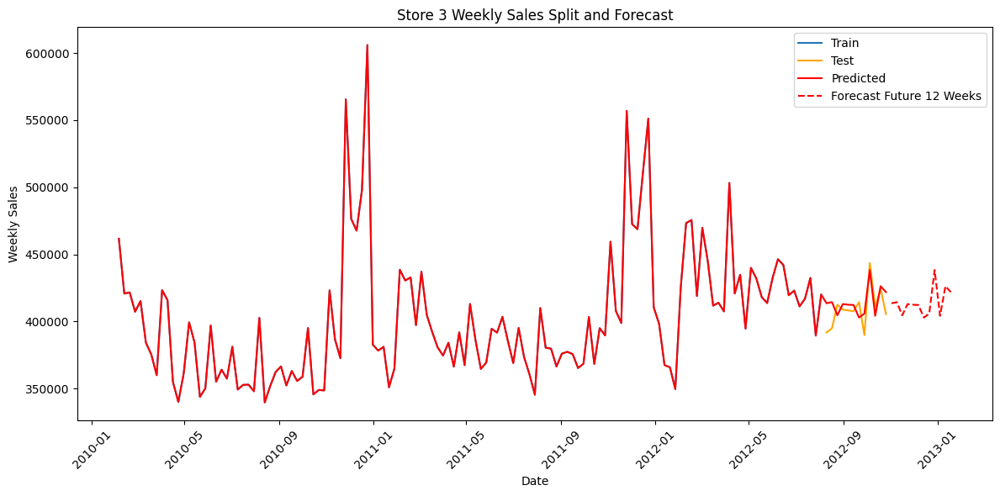

Store 4 -> Train: 131 weeks, Test: 12 weeks
Predicted Boxcox Values are : 2012-08-10    14.627594
2012-08-17    14.654536
2012-08-24    14.561005
2012-08-31    14.604061
2012-09-07    14.590604
2012-09-14    14.594479
2012-09-21    14.561575
2012-09-28    14.543653
2012-10-05    14.627673
2012-10-12    14.585618
2012-10-19    14.631084
2012-10-26    14.619377
Freq: W-FRI, Name: predicted_mean, dtype: float64
summary of the model is :                                      SARIMAX Results                                      
Dep. Variable:                                  y   No. Observations:                  131
Model:             SARIMAX(1, 0, 1)x(1, 0, 1, 52)   Log Likelihood                 173.490
Date:                            Thu, 15 May 2025   AIC                           -336.981
Time:                                    10:08:42   BIC                           -322.605
Sample:                                02-05-2010   HQIC                          -331.139
                

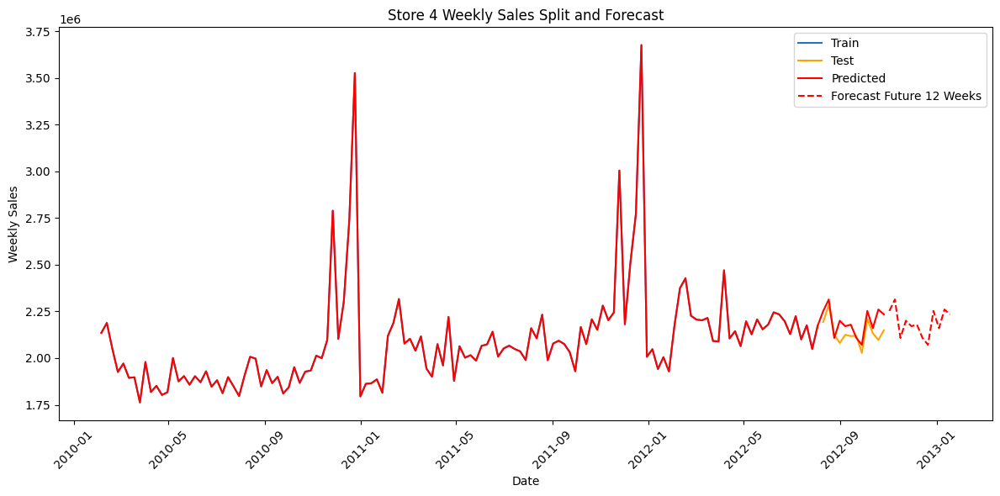

Store 5 -> Train: 131 weeks, Test: 12 weeks
Predicted Boxcox Values are : 2012-08-10    12.663020
2012-08-17    12.686353
2012-08-24    12.698668
2012-08-31    12.758375
2012-09-07    12.741782
2012-09-14    12.635796
2012-09-21    12.673280
2012-09-28    12.659592
2012-10-05    12.697856
2012-10-12    12.644557
2012-10-19    12.683809
2012-10-26    12.673919
Freq: W-FRI, Name: predicted_mean, dtype: float64
summary of the model is :                                      SARIMAX Results                                      
Dep. Variable:                                  y   No. Observations:                  131
Model:             SARIMAX(1, 0, 1)x(1, 0, 1, 52)   Log Likelihood                 158.931
Date:                            Thu, 15 May 2025   AIC                           -307.862
Time:                                    10:08:55   BIC                           -293.487
Sample:                                02-05-2010   HQIC                          -302.021
                

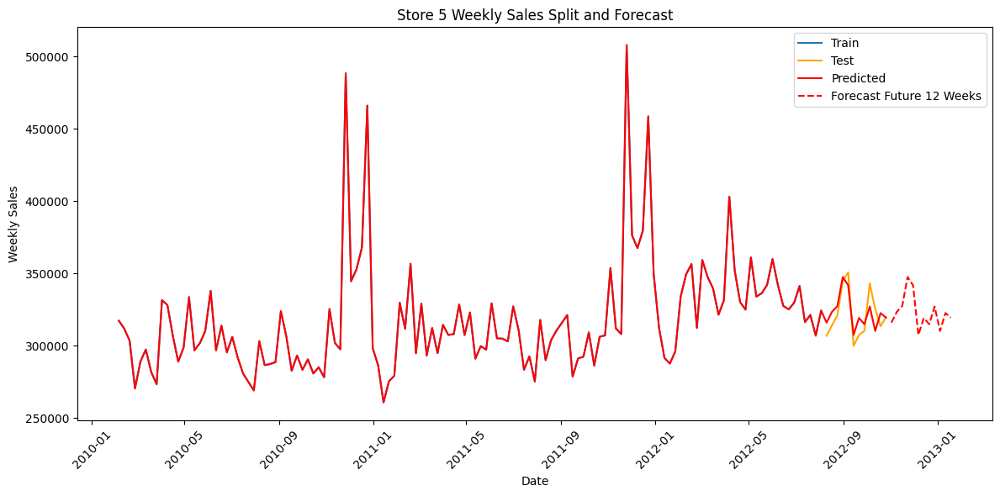

Store 6 -> Train: 131 weeks, Test: 12 weeks
Predicted Boxcox Values are : 2012-08-10    14.244948
2012-08-17    14.247987
2012-08-24    14.198545
2012-08-31    14.237991
2012-09-07    14.225895
2012-09-14    14.139783
2012-09-21    14.125891
2012-09-28    14.119281
2012-10-05    14.214852
2012-10-12    14.164298
2012-10-19    14.178516
2012-10-26    14.187835
Freq: W-FRI, Name: predicted_mean, dtype: float64
summary of the model is :                                      SARIMAX Results                                      
Dep. Variable:                                  y   No. Observations:                  131
Model:             SARIMAX(1, 0, 1)x(1, 0, 1, 52)   Log Likelihood                 153.092
Date:                            Thu, 15 May 2025   AIC                           -296.184
Time:                                    10:09:04   BIC                           -281.808
Sample:                                02-05-2010   HQIC                          -290.342
                

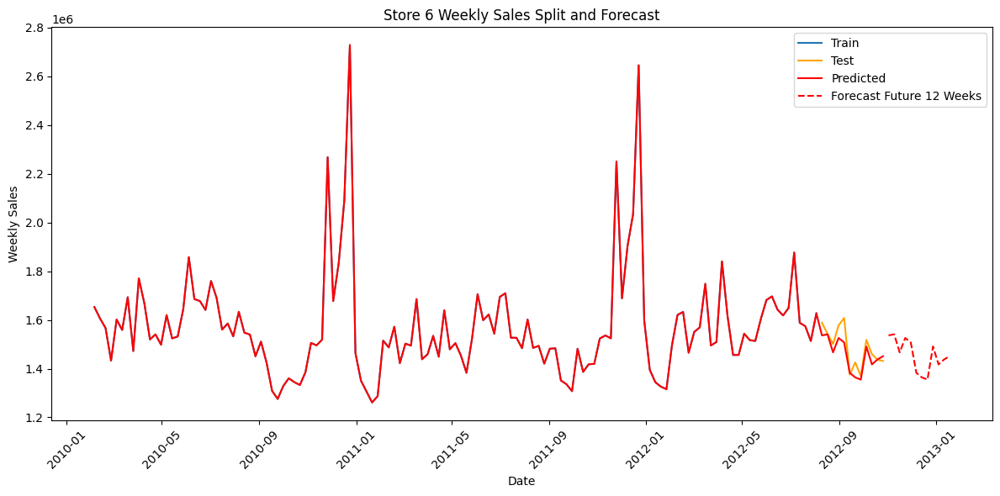

Store 7 -> Train: 131 weeks, Test: 12 weeks
Predicted Boxcox Values are : 2012-08-10    13.419942
2012-08-17    13.386505
2012-08-24    13.358215
2012-08-31    13.305891
2012-09-07    13.331048
2012-09-14    13.245305
2012-09-21    13.215458
2012-09-28    13.131532
2012-10-05    13.197916
2012-10-12    13.156993
2012-10-19    13.235898
2012-10-26    13.192080
Freq: W-FRI, Name: predicted_mean, dtype: float64
summary of the model is :                                      SARIMAX Results                                      
Dep. Variable:                                  y   No. Observations:                  131
Model:             SARIMAX(1, 0, 1)x(1, 0, 1, 52)   Log Likelihood                 138.946
Date:                            Thu, 15 May 2025   AIC                           -267.892
Time:                                    10:09:11   BIC                           -253.516
Sample:                                02-05-2010   HQIC                          -262.051
                

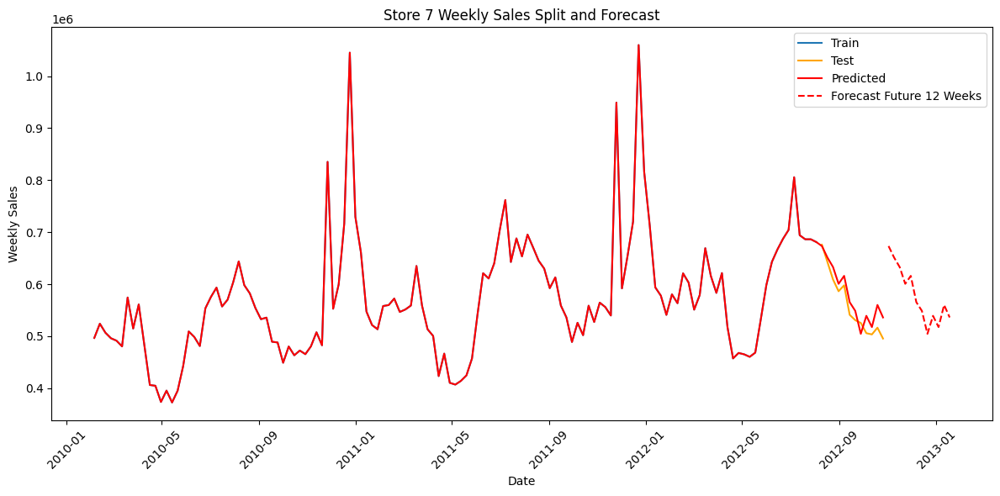

Store 8 -> Train: 131 weeks, Test: 12 weeks
Predicted Boxcox Values are : 2012-08-10    13.678296
2012-08-17    13.736067
2012-08-24    13.752538
2012-08-31    13.715235
2012-09-07    13.684832
2012-09-14    13.717499
2012-09-21    13.649794
2012-09-28    13.635957
2012-10-05    13.787723
2012-10-12    13.710799
2012-10-19    13.770839
2012-10-26    13.729379
Freq: W-FRI, Name: predicted_mean, dtype: float64
summary of the model is :                                      SARIMAX Results                                      
Dep. Variable:                                  y   No. Observations:                  131
Model:             SARIMAX(1, 0, 1)x(1, 0, 1, 52)   Log Likelihood                 169.938
Date:                            Thu, 15 May 2025   AIC                           -329.877
Time:                                    10:09:16   BIC                           -315.501
Sample:                                02-05-2010   HQIC                          -324.035
                

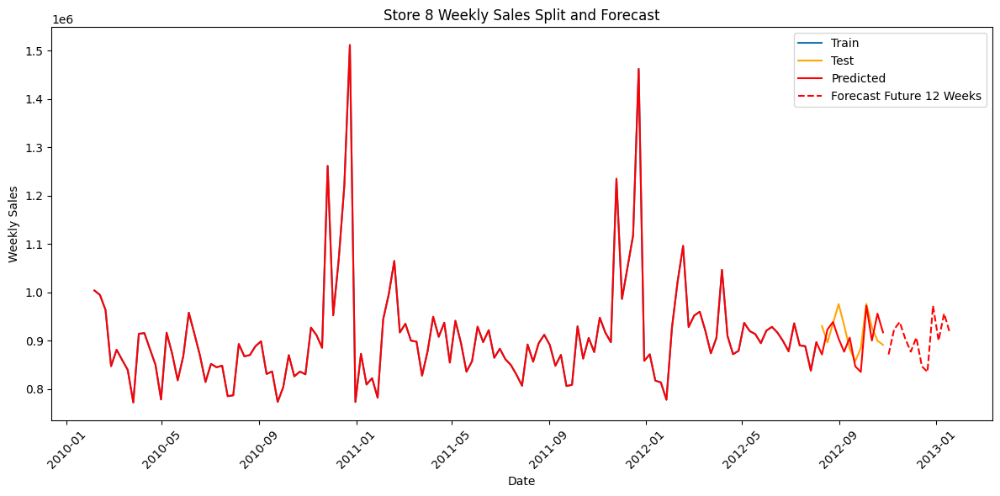

Store 9 -> Train: 131 weeks, Test: 12 weeks
Predicted Boxcox Values are : 2012-08-10    13.198308
2012-08-17    13.233395
2012-08-24    13.234773
2012-08-31    13.237341
2012-09-07    13.214274
2012-09-14    13.163195
2012-09-21    13.179909
2012-09-28    13.170499
2012-10-05    13.256459
2012-10-12    13.225027
2012-10-19    13.274144
2012-10-26    13.245365
Freq: W-FRI, Name: predicted_mean, dtype: float64
summary of the model is :                                      SARIMAX Results                                      
Dep. Variable:                                  y   No. Observations:                  131
Model:             SARIMAX(1, 0, 1)x(1, 0, 1, 52)   Log Likelihood                 158.312
Date:                            Thu, 15 May 2025   AIC                           -306.624
Time:                                    10:09:22   BIC                           -292.248
Sample:                                02-05-2010   HQIC                          -300.783
                

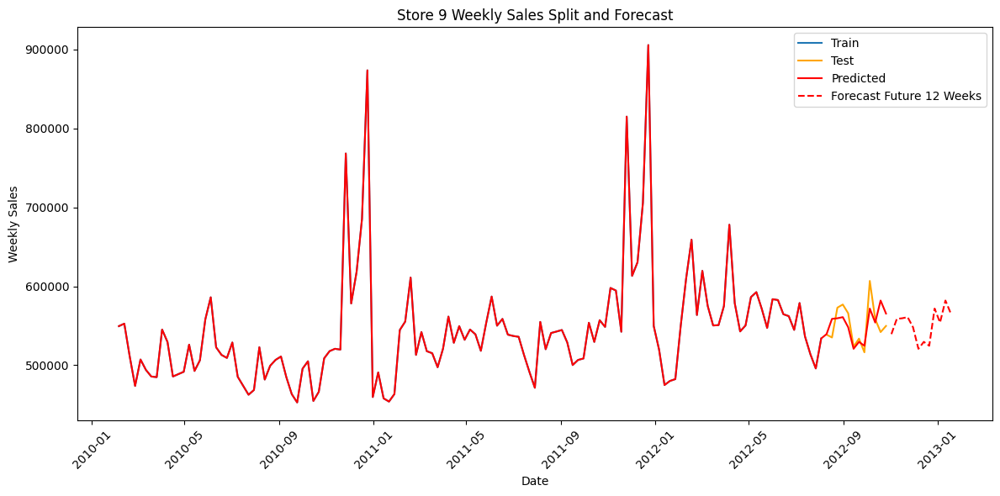

Store 10 -> Train: 131 weeks, Test: 12 weeks
Predicted Boxcox Values are : 2012-08-10    14.481400
2012-08-17    14.496544
2012-08-24    14.373343
2012-08-31    14.391661
2012-09-07    14.351712
2012-09-14    14.343885
2012-09-21    14.342863
2012-09-28    14.320067
2012-10-05    14.402627
2012-10-12    14.359989
2012-10-19    14.381788
2012-10-26    14.390674
Freq: W-FRI, Name: predicted_mean, dtype: float64
summary of the model is :                                      SARIMAX Results                                      
Dep. Variable:                                  y   No. Observations:                  131
Model:             SARIMAX(1, 0, 1)x(1, 0, 1, 52)   Log Likelihood                 145.811
Date:                            Thu, 15 May 2025   AIC                           -281.621
Time:                                    10:09:30   BIC                           -267.245
Sample:                                02-05-2010   HQIC                          -275.780
               

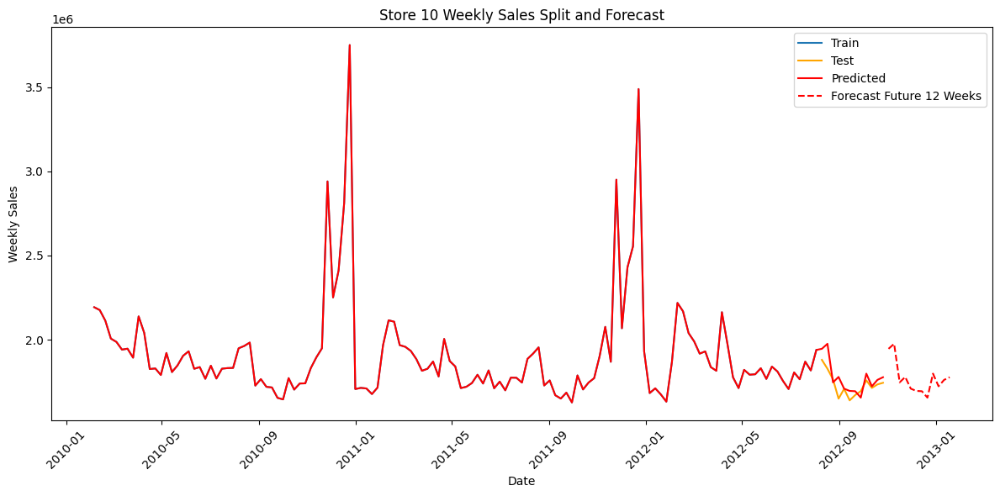

Store 11 -> Train: 131 weeks, Test: 12 weeks
Predicted Boxcox Values are : 2012-08-10    14.166546
2012-08-17    14.226241
2012-08-24    14.123680
2012-08-31    14.118512
2012-09-07    14.073951
2012-09-14    14.076417
2012-09-21    14.045371
2012-09-28    14.031837
2012-10-05    14.132773
2012-10-12    14.066902
2012-10-19    14.079426
2012-10-26    14.083709
Freq: W-FRI, Name: predicted_mean, dtype: float64
summary of the model is :                                      SARIMAX Results                                      
Dep. Variable:                                  y   No. Observations:                  131
Model:             SARIMAX(1, 0, 1)x(1, 0, 1, 52)   Log Likelihood                 155.861
Date:                            Thu, 15 May 2025   AIC                           -301.723
Time:                                    10:09:36   BIC                           -287.347
Sample:                                02-05-2010   HQIC                          -295.881
               

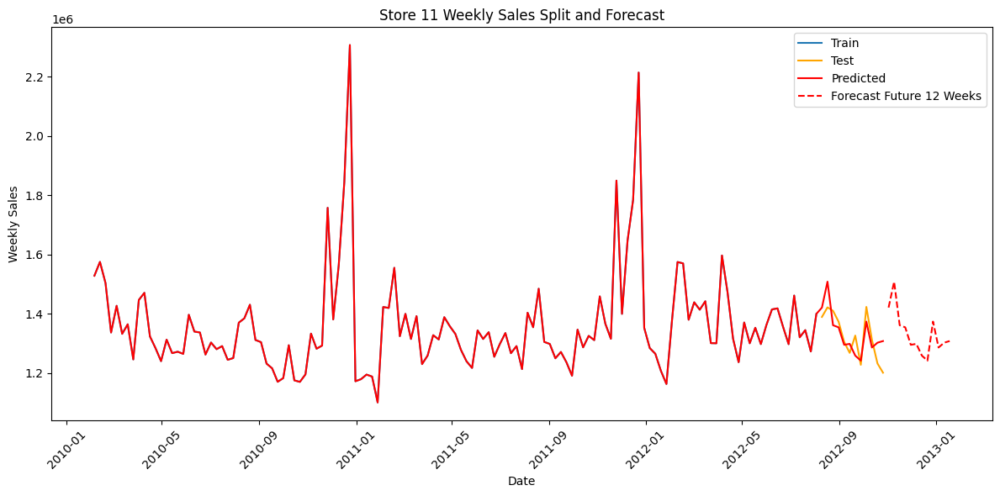

Store 12 -> Train: 131 weeks, Test: 12 weeks
Predicted Boxcox Values are : 2012-08-10    13.782553
2012-08-17    13.797091
2012-08-24    13.848352
2012-08-31    13.893061
2012-09-07    13.751534
2012-09-14    13.708659
2012-09-21    13.696369
2012-09-28    13.692305
2012-10-05    13.775453
2012-10-12    13.737574
2012-10-19    13.742604
2012-10-26    13.813970
Freq: W-FRI, Name: predicted_mean, dtype: float64
summary of the model is :                                      SARIMAX Results                                      
Dep. Variable:                                  y   No. Observations:                  131
Model:             SARIMAX(1, 0, 1)x(1, 0, 1, 52)   Log Likelihood                 155.905
Date:                            Thu, 15 May 2025   AIC                           -301.810
Time:                                    10:09:45   BIC                           -287.434
Sample:                                02-05-2010   HQIC                          -295.968
               

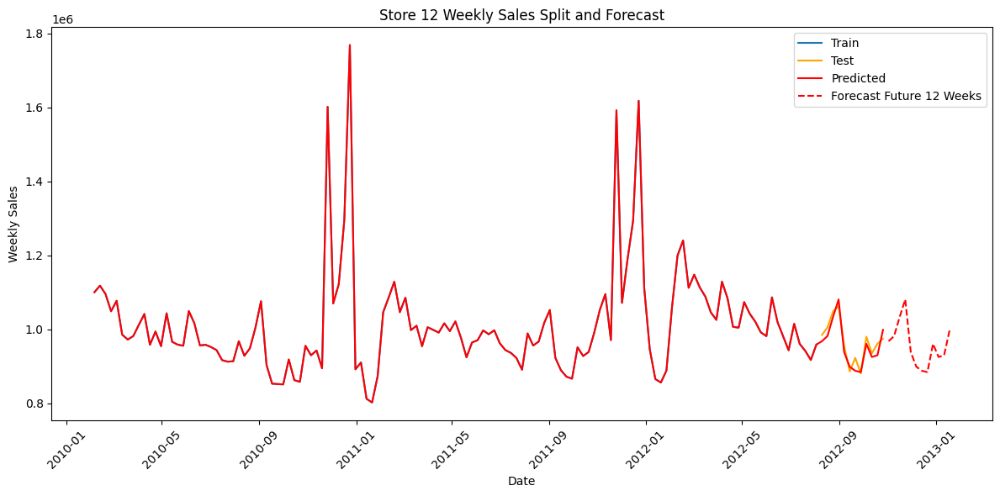

Store 13 -> Train: 131 weeks, Test: 12 weeks
Predicted Boxcox Values are : 2012-08-10    14.511121
2012-08-17    14.568812
2012-08-24    14.534419
2012-08-31    14.514923
2012-09-07    14.458915
2012-09-14    14.476619
2012-09-21    14.434266
2012-09-28    14.446934
2012-10-05    14.532602
2012-10-12    14.493338
2012-10-19    14.490570
2012-10-26    14.506990
Freq: W-FRI, Name: predicted_mean, dtype: float64
summary of the model is :                                      SARIMAX Results                                      
Dep. Variable:                                  y   No. Observations:                  131
Model:             SARIMAX(1, 0, 1)x(1, 0, 1, 52)   Log Likelihood                 156.246
Date:                            Thu, 15 May 2025   AIC                           -302.492
Time:                                    10:09:59   BIC                           -288.116
Sample:                                02-05-2010   HQIC                          -296.651
               

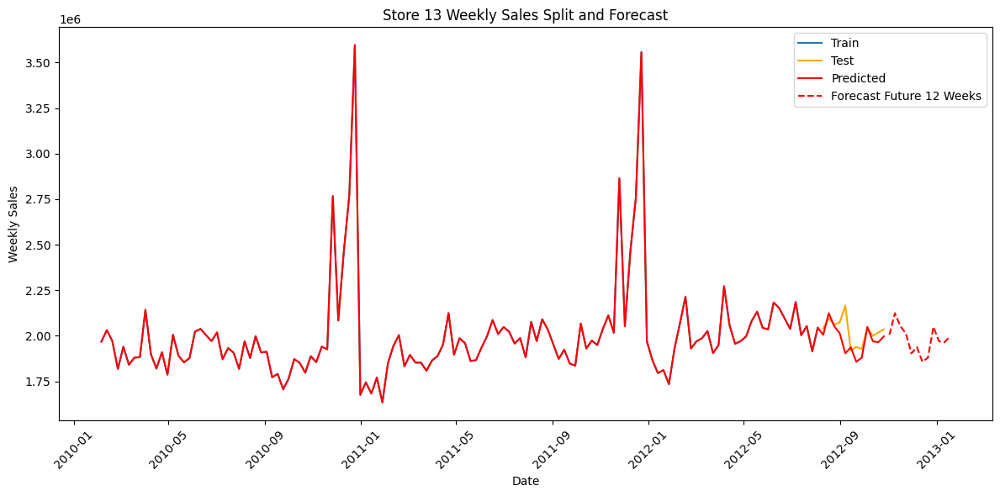

Store 14 -> Train: 131 weeks, Test: 12 weeks
Predicted Boxcox Values are : 2012-08-10    14.285740
2012-08-17    14.271835
2012-08-24    14.421802
2012-08-31    14.203322
2012-09-07    14.392386
2012-09-14    14.259439
2012-09-21    14.263932
2012-09-28    14.236786
2012-10-05    14.346175
2012-10-12    14.271095
2012-10-19    14.320900
2012-10-26    14.339265
Freq: W-FRI, Name: predicted_mean, dtype: float64
summary of the model is :                                      SARIMAX Results                                      
Dep. Variable:                                  y   No. Observations:                  131
Model:             SARIMAX(1, 0, 1)x(1, 0, 1, 52)   Log Likelihood                 112.087
Date:                            Thu, 15 May 2025   AIC                           -214.174
Time:                                    10:10:05   BIC                           -199.798
Sample:                                02-05-2010   HQIC                          -208.332
               

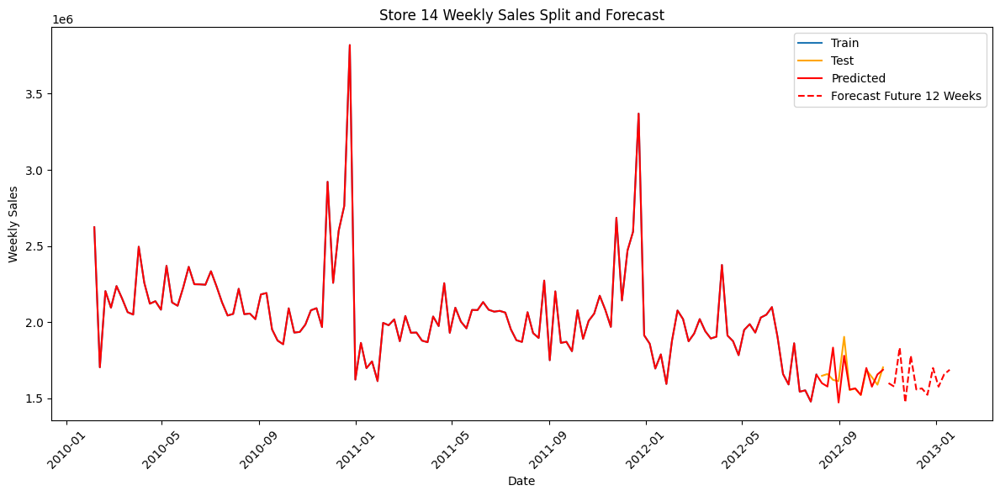

Store 15 -> Train: 131 weeks, Test: 12 weeks
Predicted Boxcox Values are : 2012-08-10    13.274666
2012-08-17    13.292400
2012-08-24    13.306120
2012-08-31    13.335616
2012-09-07    13.302813
2012-09-14    13.203928
2012-09-21    13.178025
2012-09-28    13.168152
2012-10-05    13.242163
2012-10-12    13.191760
2012-10-19    13.270257
2012-10-26    13.256794
Freq: W-FRI, Name: predicted_mean, dtype: float64
summary of the model is :                                      SARIMAX Results                                      
Dep. Variable:                                  y   No. Observations:                  131
Model:             SARIMAX(1, 0, 1)x(1, 0, 1, 52)   Log Likelihood                 116.559
Date:                            Thu, 15 May 2025   AIC                           -223.117
Time:                                    10:10:14   BIC                           -208.741
Sample:                                02-05-2010   HQIC                          -217.276
               

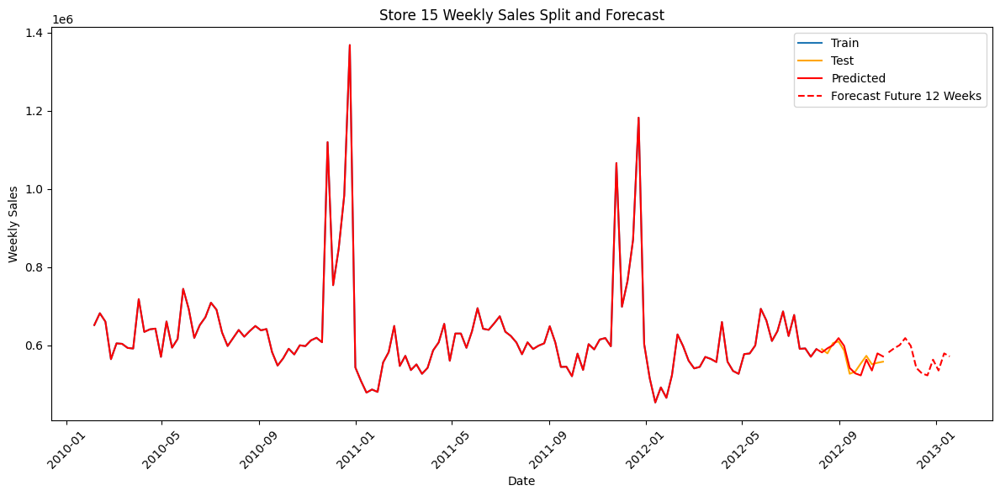

Store 16 -> Train: 131 weeks, Test: 12 weeks
Predicted Boxcox Values are : 2012-08-10    13.209367
2012-08-17    13.189586
2012-08-24    13.211768
2012-08-31    13.230098
2012-09-07    13.220458
2012-09-14    13.167768
2012-09-21    13.115258
2012-09-28    13.012868
2012-10-05    13.056816
2012-10-12    13.083370
2012-10-19    13.201323
2012-10-26    13.110050
Freq: W-FRI, Name: predicted_mean, dtype: float64
summary of the model is :                                      SARIMAX Results                                      
Dep. Variable:                                  y   No. Observations:                  131
Model:             SARIMAX(1, 0, 1)x(1, 0, 1, 52)   Log Likelihood                 146.009
Date:                            Thu, 15 May 2025   AIC                           -282.018
Time:                                    10:10:24   BIC                           -267.642
Sample:                                02-05-2010   HQIC                          -276.177
               

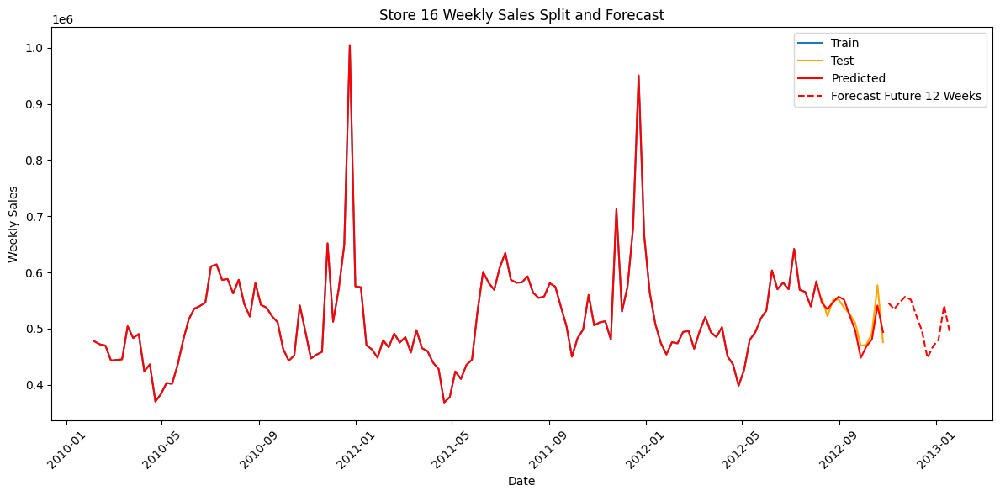

Store 17 -> Train: 131 weeks, Test: 12 weeks
Predicted Boxcox Values are : 2012-08-10    13.684989
2012-08-17    13.664803
2012-08-24    13.718496
2012-08-31    13.715845
2012-09-07    13.962955
2012-09-14    13.981751
2012-09-21    13.778896
2012-09-28    13.750993
2012-10-05    13.825992
2012-10-12    13.769857
2012-10-19    13.773087
2012-10-26    13.833298
Freq: W-FRI, Name: predicted_mean, dtype: float64
summary of the model is :                                      SARIMAX Results                                      
Dep. Variable:                                  y   No. Observations:                  131
Model:             SARIMAX(1, 0, 1)x(1, 0, 1, 52)   Log Likelihood                 158.565
Date:                            Thu, 15 May 2025   AIC                           -307.129
Time:                                    10:10:30   BIC                           -292.753
Sample:                                02-05-2010   HQIC                          -301.288
               

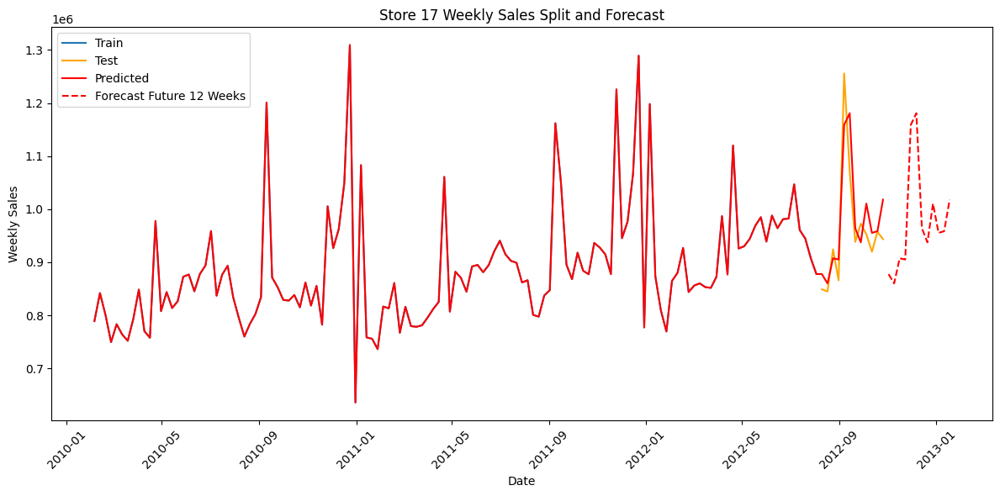

Store 18 -> Train: 131 weeks, Test: 12 weeks
Predicted Boxcox Values are : 2012-08-10    13.777959
2012-08-17    13.760320
2012-08-24    13.963771
2012-08-31    13.137819
2012-09-07    13.834720
2012-09-14    13.709252
2012-09-21    13.739691
2012-09-28    13.732803
2012-10-05    13.870826
2012-10-12    13.827781
2012-10-19    13.923192
2012-10-26    13.988796
Freq: W-FRI, Name: predicted_mean, dtype: float64
summary of the model is :                                      SARIMAX Results                                      
Dep. Variable:                                  y   No. Observations:                  131
Model:             SARIMAX(1, 0, 1)x(1, 0, 1, 52)   Log Likelihood                  89.674
Date:                            Thu, 15 May 2025   AIC                           -169.349
Time:                                    10:10:39   BIC                           -154.973
Sample:                                02-05-2010   HQIC                          -163.507
               

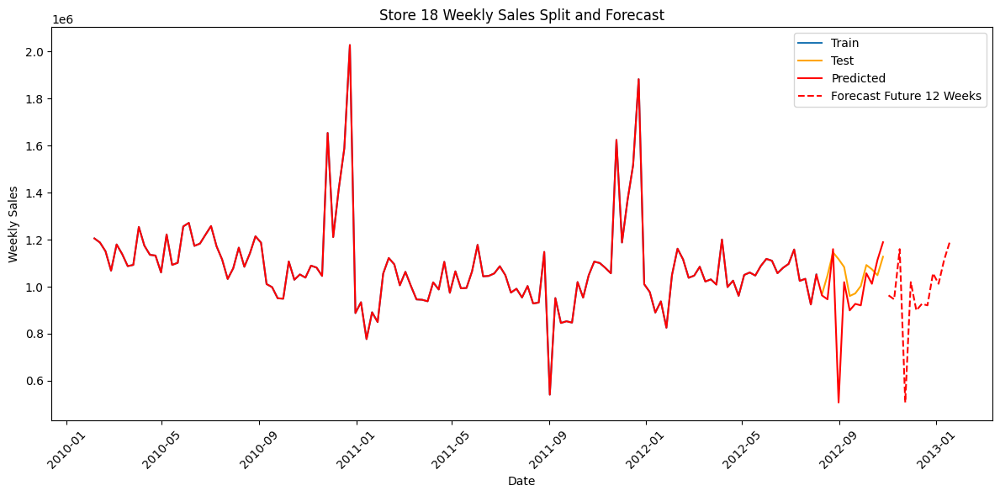

Store 19 -> Train: 131 weeks, Test: 12 weeks
Predicted Boxcox Values are : 2012-08-10    14.107924
2012-08-17    14.119872
2012-08-24    14.214914
2012-08-31    14.253099
2012-09-07    14.230437
2012-09-14    14.100041
2012-09-21    14.052890
2012-09-28    14.084427
2012-10-05    14.148042
2012-10-12    14.076628
2012-10-19    14.094156
2012-10-26    14.117129
Freq: W-FRI, Name: predicted_mean, dtype: float64
summary of the model is :                                      SARIMAX Results                                      
Dep. Variable:                                  y   No. Observations:                  131
Model:             SARIMAX(1, 0, 1)x(1, 0, 1, 52)   Log Likelihood                 148.003
Date:                            Thu, 15 May 2025   AIC                           -286.005
Time:                                    10:10:45   BIC                           -271.629
Sample:                                02-05-2010   HQIC                          -280.164
               

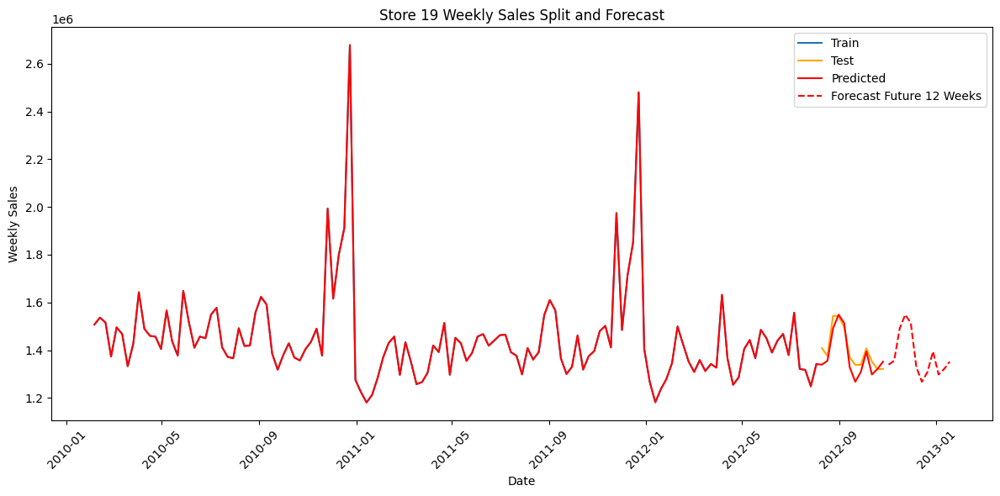

Store 20 -> Train: 131 weeks, Test: 12 weeks
Predicted Boxcox Values are : 2012-08-10    14.570550
2012-08-17    14.534794
2012-08-24    14.514381
2012-08-31    14.601726
2012-09-07    14.557949
2012-09-14    14.525970
2012-09-21    14.465745
2012-09-28    14.514455
2012-10-05    14.587406
2012-10-12    14.533941
2012-10-19    14.542914
2012-10-26    14.533431
Freq: W-FRI, Name: predicted_mean, dtype: float64
summary of the model is :                                      SARIMAX Results                                      
Dep. Variable:                                  y   No. Observations:                  131
Model:             SARIMAX(1, 0, 1)x(1, 0, 1, 52)   Log Likelihood                 133.900
Date:                            Thu, 15 May 2025   AIC                           -257.800
Time:                                    10:10:57   BIC                           -243.424
Sample:                                02-05-2010   HQIC                          -251.958
               

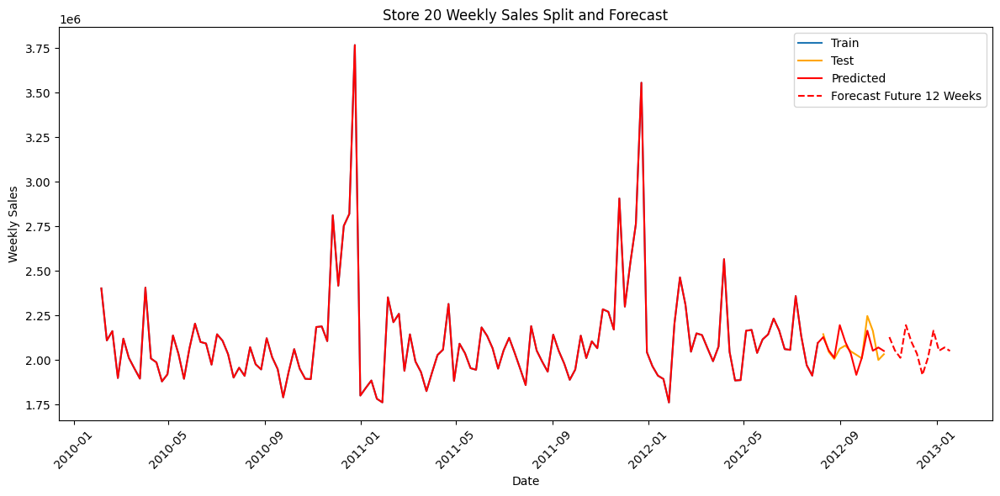

Store 21 -> Train: 131 weeks, Test: 12 weeks
Predicted Boxcox Values are : 2012-08-10    13.480697
2012-08-17    13.558273
2012-08-24    13.542118
2012-08-31    13.394902
2012-09-07    13.323320
2012-09-14    13.329955
2012-09-21    13.342333
2012-09-28    13.324257
2012-10-05    13.335164
2012-10-12    13.349532
2012-10-19    13.400919
2012-10-26    13.420774
Freq: W-FRI, Name: predicted_mean, dtype: float64
summary of the model is :                                      SARIMAX Results                                      
Dep. Variable:                                  y   No. Observations:                  131
Model:             SARIMAX(1, 0, 1)x(1, 0, 1, 52)   Log Likelihood                 127.305
Date:                            Thu, 15 May 2025   AIC                           -244.609
Time:                                    10:11:06   BIC                           -230.233
Sample:                                02-05-2010   HQIC                          -238.768
               

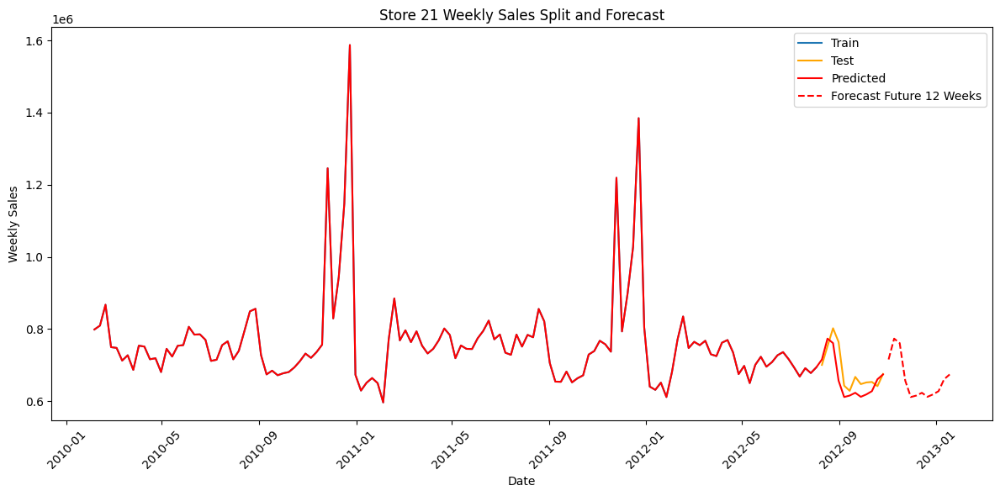

Store 22 -> Train: 131 weeks, Test: 12 weeks
Predicted Boxcox Values are : 2012-08-10    13.809019
2012-08-17    13.810064
2012-08-24    13.934751
2012-08-31    13.802555
2012-09-07    13.783317
2012-09-14    13.745894
2012-09-21    13.717816
2012-09-28    13.748301
2012-10-05    13.819582
2012-10-12    13.766753
2012-10-19    13.789181
2012-10-26    13.874978
Freq: W-FRI, Name: predicted_mean, dtype: float64
summary of the model is :                                      SARIMAX Results                                      
Dep. Variable:                                  y   No. Observations:                  131
Model:             SARIMAX(1, 0, 1)x(1, 0, 1, 52)   Log Likelihood                 124.553
Date:                            Thu, 15 May 2025   AIC                           -239.106
Time:                                    10:11:13   BIC                           -224.730
Sample:                                02-05-2010   HQIC                          -233.265
               

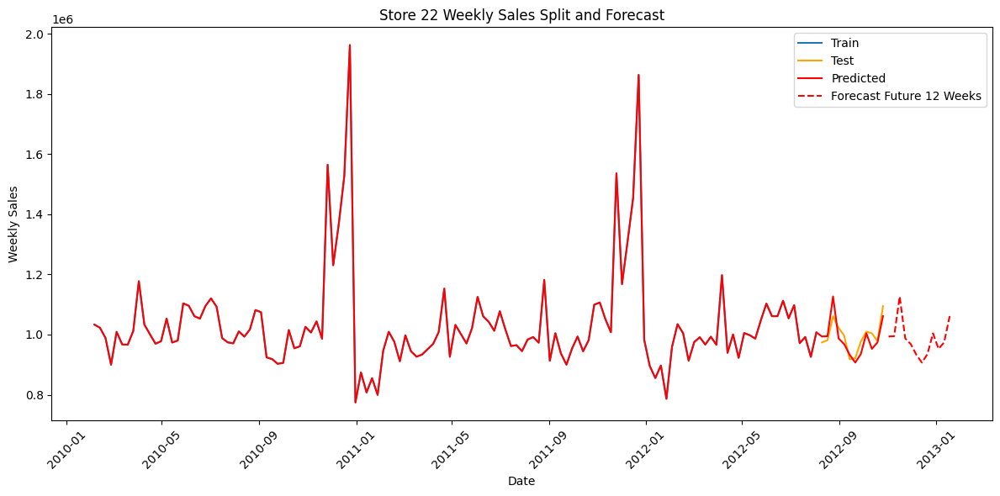

Store 23 -> Train: 131 weeks, Test: 12 weeks
Predicted Boxcox Values are : 2012-08-10    14.136667
2012-08-17    14.190268
2012-08-24    14.289521
2012-08-31    14.183399
2012-09-07    14.127405
2012-09-14    14.024916
2012-09-21    14.016156
2012-09-28    14.022602
2012-10-05    14.108641
2012-10-12    14.011670
2012-10-19    14.089044
2012-10-26    14.064243
Freq: W-FRI, Name: predicted_mean, dtype: float64
summary of the model is :                                      SARIMAX Results                                      
Dep. Variable:                                  y   No. Observations:                  131
Model:             SARIMAX(1, 0, 1)x(1, 0, 1, 52)   Log Likelihood                 104.562
Date:                            Thu, 15 May 2025   AIC                           -199.124
Time:                                    10:11:23   BIC                           -184.748
Sample:                                02-05-2010   HQIC                          -193.283
               

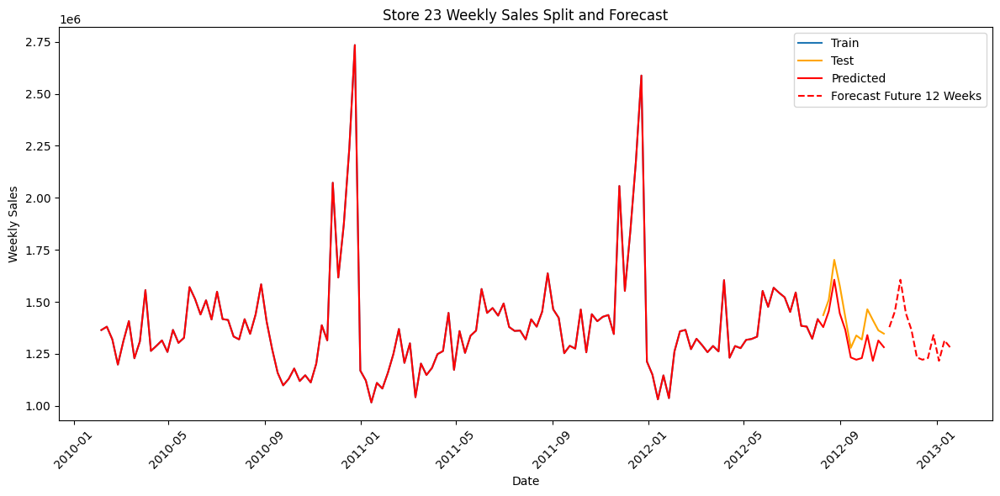

Store 24 -> Train: 131 weeks, Test: 12 weeks
Predicted Boxcox Values are : 2012-08-10    14.155754
2012-08-17    14.131357
2012-08-24    14.148068
2012-08-31    14.054766
2012-09-07    14.226463
2012-09-14    14.049445
2012-09-21    14.026378
2012-09-28    14.044692
2012-10-05    14.152190
2012-10-12    14.106156
2012-10-19    14.067431
2012-10-26    14.080936
Freq: W-FRI, Name: predicted_mean, dtype: float64
summary of the model is :                                      SARIMAX Results                                      
Dep. Variable:                                  y   No. Observations:                  131
Model:             SARIMAX(1, 0, 1)x(1, 0, 1, 52)   Log Likelihood                 140.096
Date:                            Thu, 15 May 2025   AIC                           -270.191
Time:                                    10:11:29   BIC                           -255.815
Sample:                                02-05-2010   HQIC                          -264.350
               

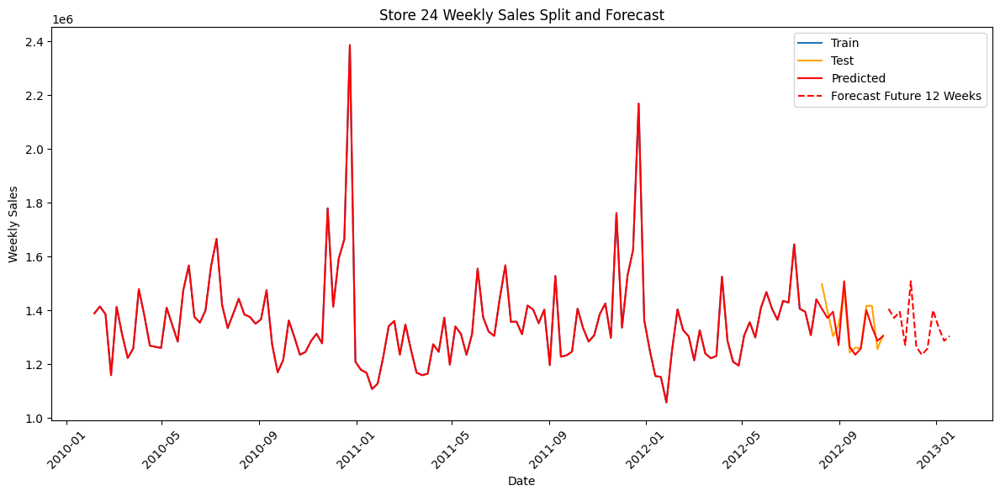

Store 25 -> Train: 131 weeks, Test: 12 weeks
Predicted Boxcox Values are : 2012-08-10    13.439464
2012-08-17    13.475702
2012-08-24    13.503004
2012-08-31    13.468843
2012-09-07    13.431587
2012-09-14    13.376757
2012-09-21    13.358742
2012-09-28    13.400740
2012-10-05    13.438317
2012-10-12    13.388186
2012-10-19    13.450034
2012-10-26    13.485299
Freq: W-FRI, Name: predicted_mean, dtype: float64
summary of the model is :                                      SARIMAX Results                                      
Dep. Variable:                                  y   No. Observations:                  131
Model:             SARIMAX(1, 0, 1)x(1, 0, 1, 52)   Log Likelihood                 134.785
Date:                            Thu, 15 May 2025   AIC                           -259.570
Time:                                    10:11:39   BIC                           -245.194
Sample:                                02-05-2010   HQIC                          -253.728
               

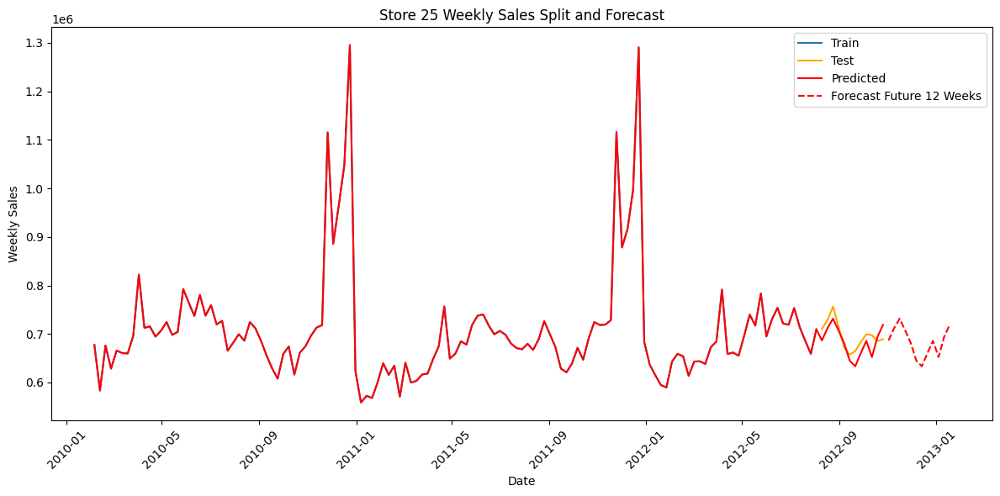

Store 26 -> Train: 131 weeks, Test: 12 weeks
Predicted Boxcox Values are : 2012-08-10    13.883889
2012-08-17    13.851513
2012-08-24    13.857468
2012-08-31    13.873647
2012-09-07    13.889265
2012-09-14    13.776944
2012-09-21    13.734353
2012-09-28    13.780700
2012-10-05    13.897210
2012-10-12    13.802125
2012-10-19    13.785065
2012-10-26    13.772834
Freq: W-FRI, Name: predicted_mean, dtype: float64
summary of the model is :                                      SARIMAX Results                                      
Dep. Variable:                                  y   No. Observations:                  131
Model:             SARIMAX(1, 0, 1)x(1, 0, 1, 52)   Log Likelihood                 161.287
Date:                            Thu, 15 May 2025   AIC                           -312.573
Time:                                    10:11:50   BIC                           -298.197
Sample:                                02-05-2010   HQIC                          -306.731
               

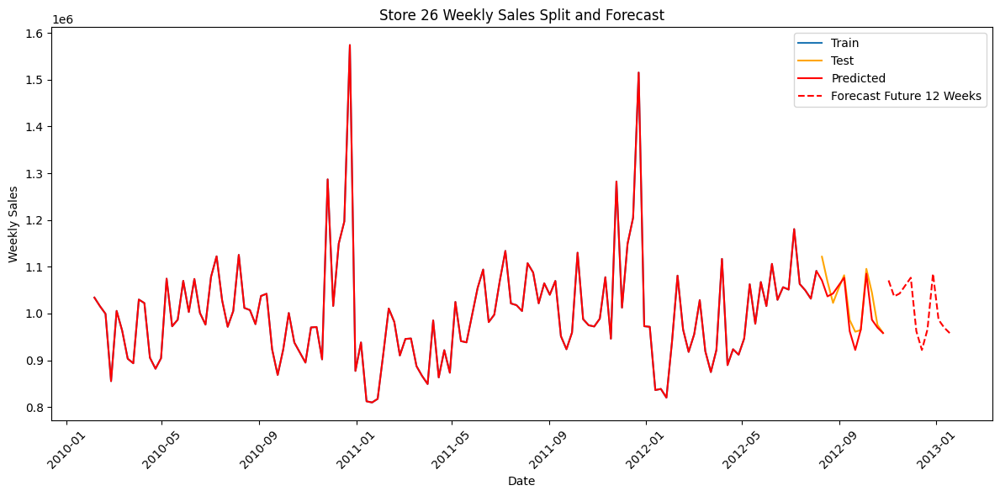

Store 27 -> Train: 131 weeks, Test: 12 weeks
Predicted Boxcox Values are : 2012-08-10    14.357049
2012-08-17    14.380024
2012-08-24    14.426560
2012-08-31    14.296859
2012-09-07    14.407524
2012-09-14    14.258138
2012-09-21    14.247002
2012-09-28    14.230155
2012-10-05    14.295340
2012-10-12    14.303548
2012-10-19    14.296654
2012-10-26    14.301097
Freq: W-FRI, Name: predicted_mean, dtype: float64
summary of the model is :                                      SARIMAX Results                                      
Dep. Variable:                                  y   No. Observations:                  131
Model:             SARIMAX(1, 0, 1)x(1, 0, 1, 52)   Log Likelihood                 118.825
Date:                            Thu, 15 May 2025   AIC                           -227.650
Time:                                    10:12:00   BIC                           -213.274
Sample:                                02-05-2010   HQIC                          -221.808
               

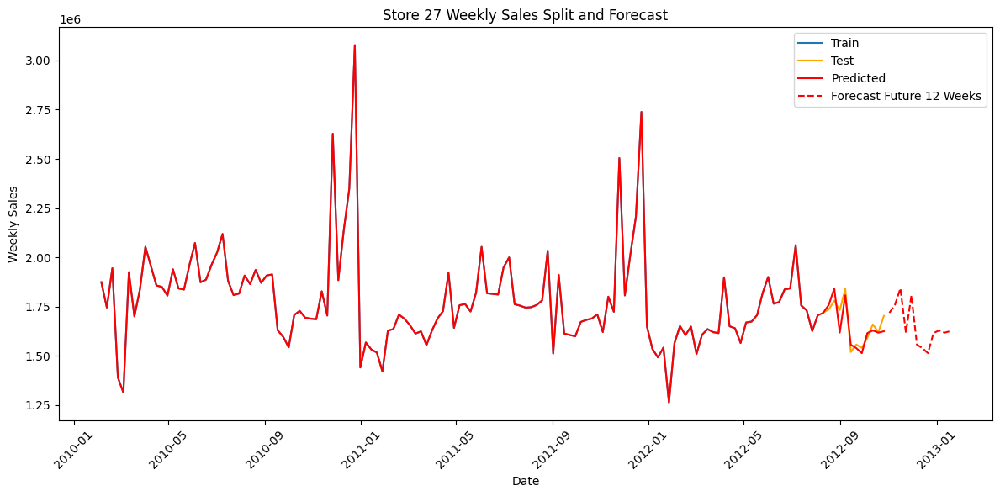

Store 28 -> Train: 131 weeks, Test: 12 weeks
Predicted Boxcox Values are : 2012-08-10    13.989522
2012-08-17    13.975570
2012-08-24    13.950561
2012-08-31    14.154859
2012-09-07    14.052278
2012-09-14    13.944256
2012-09-21    13.904942
2012-09-28    13.914812
2012-10-05    14.203574
2012-10-12    13.988948
2012-10-19    13.975536
2012-10-26    14.004772
Freq: W-FRI, Name: predicted_mean, dtype: float64
summary of the model is :                                      SARIMAX Results                                      
Dep. Variable:                                  y   No. Observations:                  131
Model:             SARIMAX(1, 0, 1)x(1, 0, 1, 52)   Log Likelihood                 121.127
Date:                            Thu, 15 May 2025   AIC                           -232.254
Time:                                    10:12:06   BIC                           -217.878
Sample:                                02-05-2010   HQIC                          -226.412
               

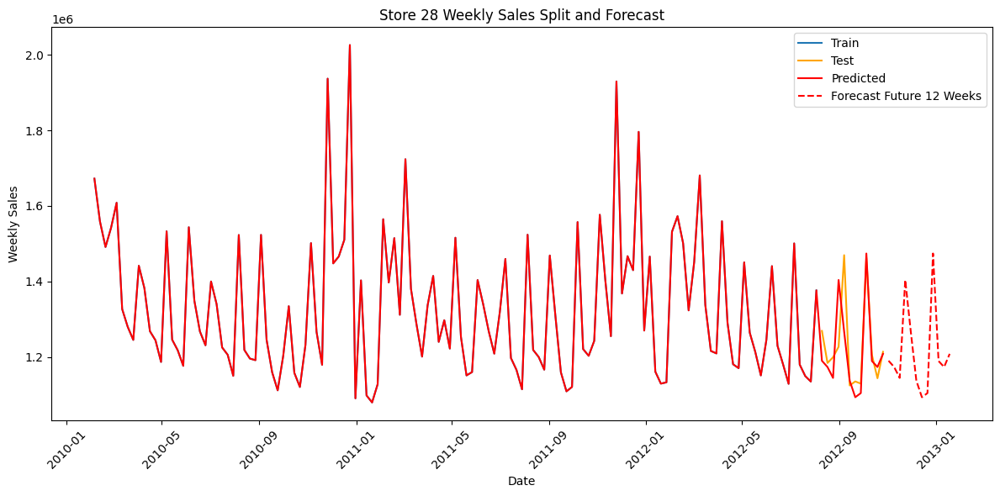

Store 29 -> Train: 131 weeks, Test: 12 weeks
Predicted Boxcox Values are : 2012-08-10    13.085782
2012-08-17    13.145470
2012-08-24    13.256126
2012-08-31    13.183810
2012-09-07    13.116555
2012-09-14    13.058622
2012-09-21    13.061816
2012-09-28    13.039708
2012-10-05    13.160620
2012-10-12    13.078978
2012-10-19    13.129044
2012-10-26    13.158148
Freq: W-FRI, Name: predicted_mean, dtype: float64
summary of the model is :                                      SARIMAX Results                                      
Dep. Variable:                                  y   No. Observations:                  131
Model:             SARIMAX(1, 0, 1)x(1, 0, 1, 52)   Log Likelihood                 112.881
Date:                            Thu, 15 May 2025   AIC                           -215.762
Time:                                    10:12:18   BIC                           -201.387
Sample:                                02-05-2010   HQIC                          -209.921
               

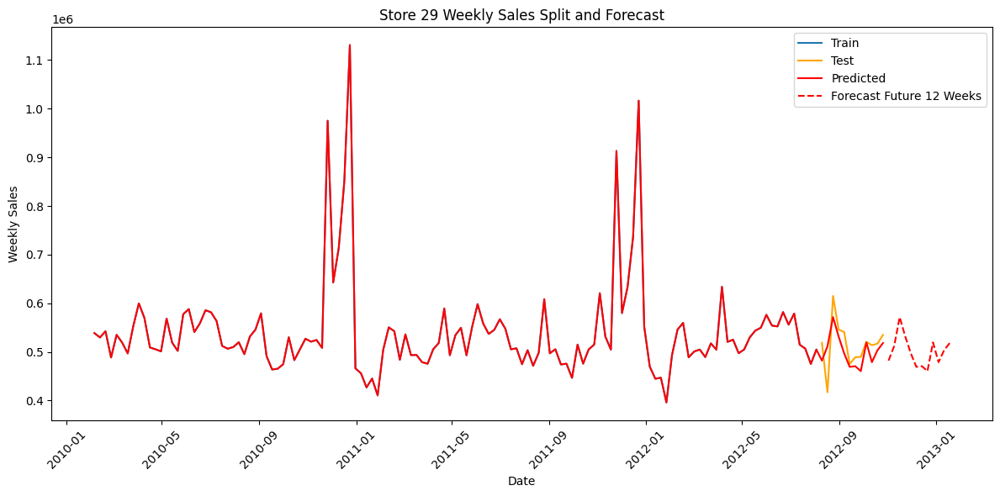

Store 30 -> Train: 131 weeks, Test: 12 weeks
Predicted Boxcox Values are : 2012-08-10    12.954901
2012-08-17    12.959342
2012-08-24    12.931906
2012-08-31    12.928025
2012-09-07    12.924206
2012-09-14    12.941583
2012-09-21    12.939402
2012-09-28    12.932411
2012-10-05    12.974057
2012-10-12    12.961501
2012-10-19    12.982285
2012-10-26    12.962737
Freq: W-FRI, Name: predicted_mean, dtype: float64
summary of the model is :                                      SARIMAX Results                                      
Dep. Variable:                                  y   No. Observations:                  131
Model:             SARIMAX(1, 0, 1)x(1, 0, 1, 52)   Log Likelihood                 228.385
Date:                            Thu, 15 May 2025   AIC                           -446.771
Time:                                    10:12:27   BIC                           -432.395
Sample:                                02-05-2010   HQIC                          -440.929
               

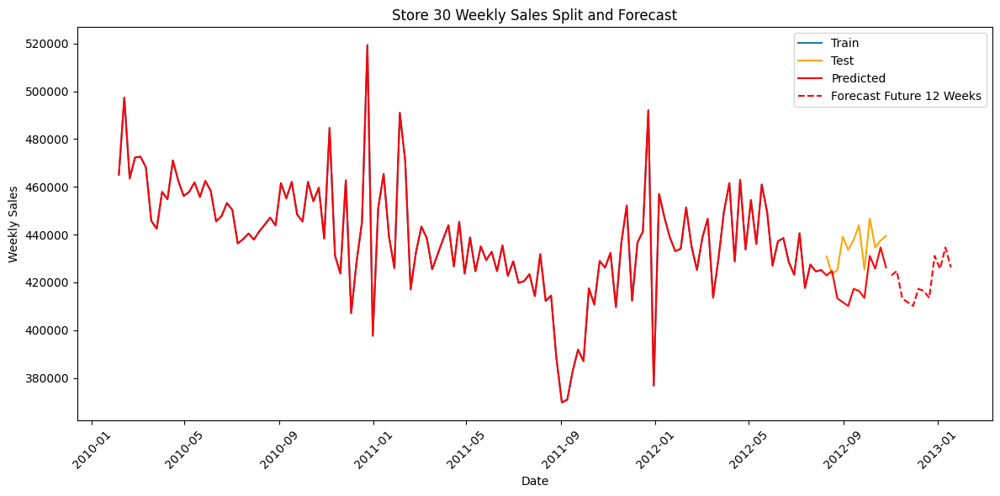

Store 31 -> Train: 131 weeks, Test: 12 weeks
Predicted Boxcox Values are : 2012-08-10    14.167350
2012-08-17    14.196418
2012-08-24    14.152910
2012-08-31    14.132450
2012-09-07    14.127977
2012-09-14    14.118750
2012-09-21    14.101846
2012-09-28    14.062916
2012-10-05    14.155149
2012-10-12    14.123703
2012-10-19    14.140601
2012-10-26    14.104606
Freq: W-FRI, Name: predicted_mean, dtype: float64
summary of the model is :                                      SARIMAX Results                                      
Dep. Variable:                                  y   No. Observations:                  131
Model:             SARIMAX(1, 0, 1)x(1, 0, 1, 52)   Log Likelihood                 199.413
Date:                            Thu, 15 May 2025   AIC                           -388.826
Time:                                    10:12:33   BIC                           -374.450
Sample:                                02-05-2010   HQIC                          -382.985
               

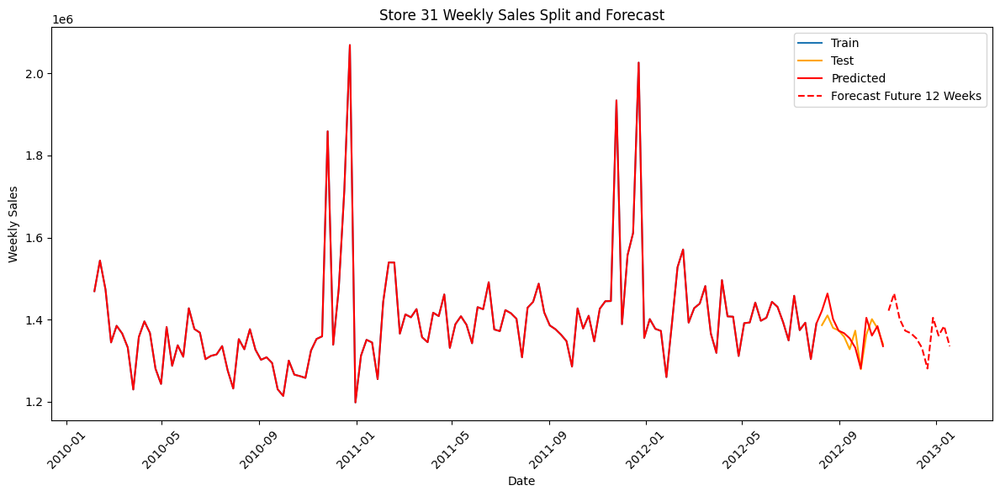

Store 32 -> Train: 131 weeks, Test: 12 weeks
Predicted Boxcox Values are : 2012-08-10    14.013121
2012-08-17    14.031366
2012-08-24    13.996247
2012-08-31    13.964429
2012-09-07    13.925430
2012-09-14    13.938510
2012-09-21    13.936092
2012-09-28    13.920520
2012-10-05    13.958831
2012-10-12    13.975034
2012-10-19    13.966344
2012-10-26    13.986767
Freq: W-FRI, Name: predicted_mean, dtype: float64
summary of the model is :                                      SARIMAX Results                                      
Dep. Variable:                                  y   No. Observations:                  131
Model:             SARIMAX(1, 0, 1)x(1, 0, 1, 52)   Log Likelihood                 178.987
Date:                            Thu, 15 May 2025   AIC                           -347.974
Time:                                    10:12:44   BIC                           -333.598
Sample:                                02-05-2010   HQIC                          -342.133
               

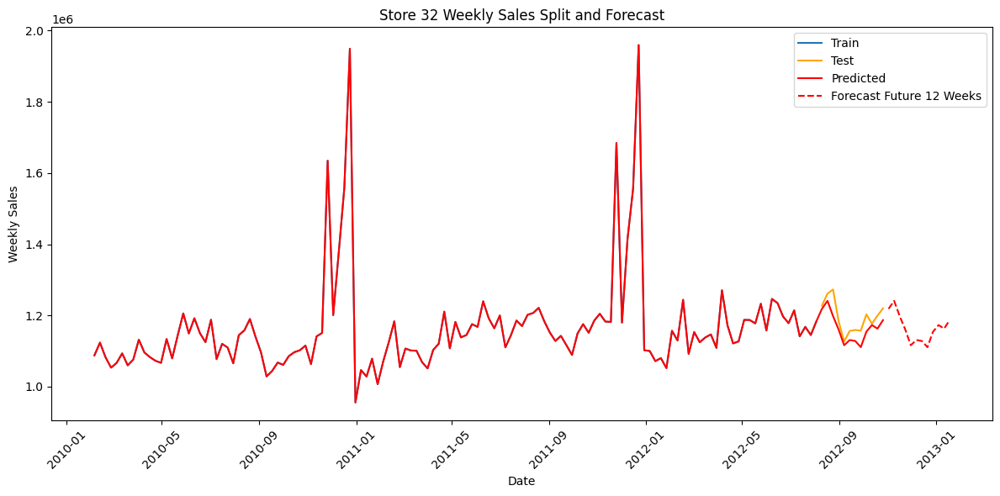

Store 33 -> Train: 131 weeks, Test: 12 weeks
Predicted Boxcox Values are : 2012-08-10    12.554136
2012-08-17    12.444875
2012-08-24    12.423481
2012-08-31    12.441560
2012-09-07    12.575733
2012-09-14    12.507928
2012-09-21    12.424220
2012-09-28    12.402889
2012-10-05    12.524024
2012-10-12    12.535924
2012-10-19    12.422217
2012-10-26    12.395856
Freq: W-FRI, Name: predicted_mean, dtype: float64
summary of the model is :                                      SARIMAX Results                                      
Dep. Variable:                                  y   No. Observations:                  131
Model:             SARIMAX(1, 0, 1)x(1, 0, 1, 52)   Log Likelihood                 177.543
Date:                            Thu, 15 May 2025   AIC                           -345.085
Time:                                    10:12:47   BIC                           -330.709
Sample:                                02-05-2010   HQIC                          -339.243
               

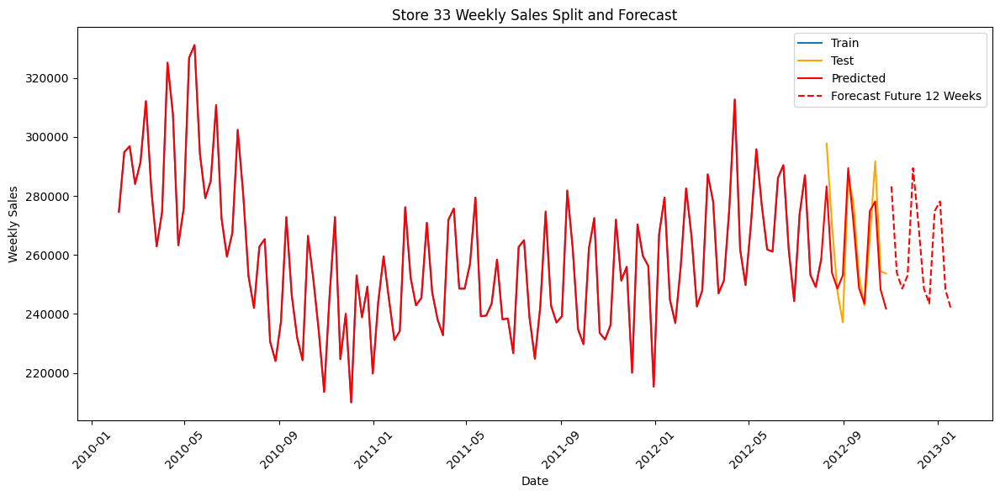

Store 34 -> Train: 131 weeks, Test: 12 weeks
Predicted Boxcox Values are : 2012-08-10    13.813424
2012-08-17    13.828498
2012-08-24    13.720329
2012-08-31    13.799468
2012-09-07    13.789975
2012-09-14    13.769519
2012-09-21    13.746375
2012-09-28    13.724838
2012-10-05    13.804594
2012-10-12    13.760789
2012-10-19    13.806087
2012-10-26    13.804965
Freq: W-FRI, Name: predicted_mean, dtype: float64
summary of the model is :                                      SARIMAX Results                                      
Dep. Variable:                                  y   No. Observations:                  131
Model:             SARIMAX(1, 0, 1)x(1, 0, 1, 52)   Log Likelihood                 183.314
Date:                            Thu, 15 May 2025   AIC                           -356.628
Time:                                    10:12:55   BIC                           -342.252
Sample:                                02-05-2010   HQIC                          -350.786
               

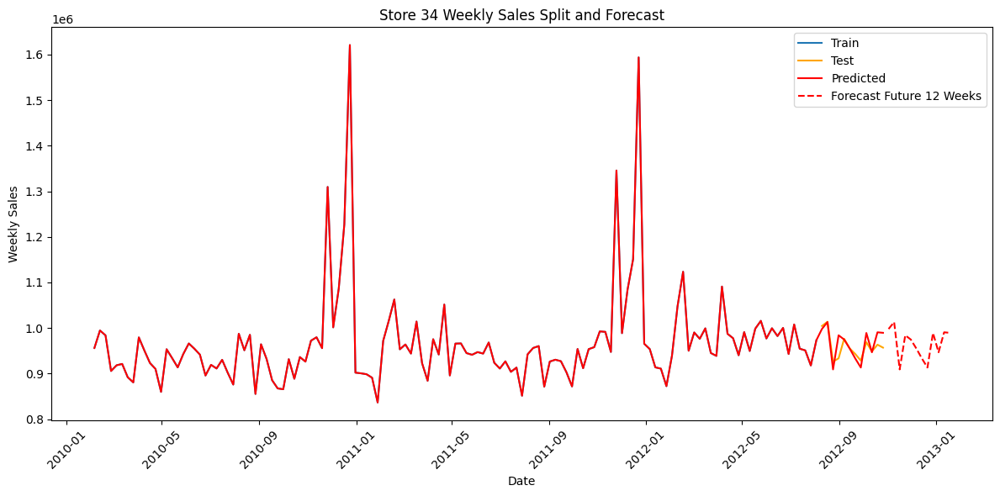

Store 35 -> Train: 131 weeks, Test: 12 weeks
Predicted Boxcox Values are : 2012-08-10    13.631694
2012-08-17    13.608711
2012-08-24    13.598520
2012-08-31    13.567819
2012-09-07    13.633544
2012-09-14    13.465129
2012-09-21    13.403217
2012-09-28    13.439680
2012-10-05    13.521755
2012-10-12    13.470563
2012-10-19    13.509974
2012-10-26    13.524919
Freq: W-FRI, Name: predicted_mean, dtype: float64
summary of the model is :                                      SARIMAX Results                                      
Dep. Variable:                                  y   No. Observations:                  131
Model:             SARIMAX(1, 0, 1)x(1, 0, 1, 52)   Log Likelihood                  84.329
Date:                            Thu, 15 May 2025   AIC                           -158.659
Time:                                    10:13:02   BIC                           -144.283
Sample:                                02-05-2010   HQIC                          -152.817
               

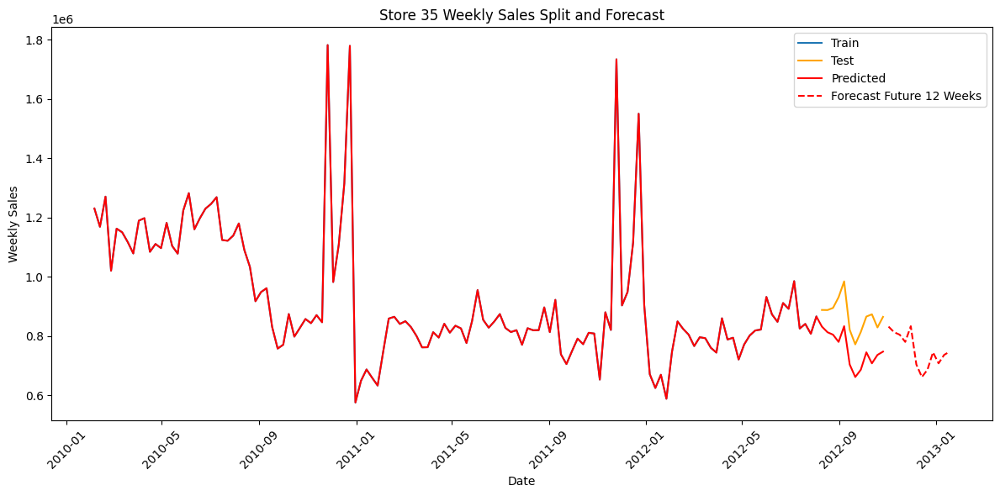

Store 36 -> Train: 131 weeks, Test: 12 weeks
Predicted Boxcox Values are : 2012-08-10    12.629540
2012-08-17    12.595401
2012-08-24    12.540931
2012-08-31    12.565114
2012-09-07    12.571587
2012-09-14    12.578141
2012-09-21    12.522746
2012-09-28    12.516419
2012-10-05    12.574679
2012-10-12    12.578137
2012-10-19    12.537907
2012-10-26    12.479804
Freq: W-FRI, Name: predicted_mean, dtype: float64
summary of the model is :                                      SARIMAX Results                                      
Dep. Variable:                                  y   No. Observations:                  131
Model:             SARIMAX(1, 0, 1)x(1, 0, 1, 52)   Log Likelihood                 208.552
Date:                            Thu, 15 May 2025   AIC                           -407.104
Time:                                    10:13:11   BIC                           -392.728
Sample:                                02-05-2010   HQIC                          -401.263
               

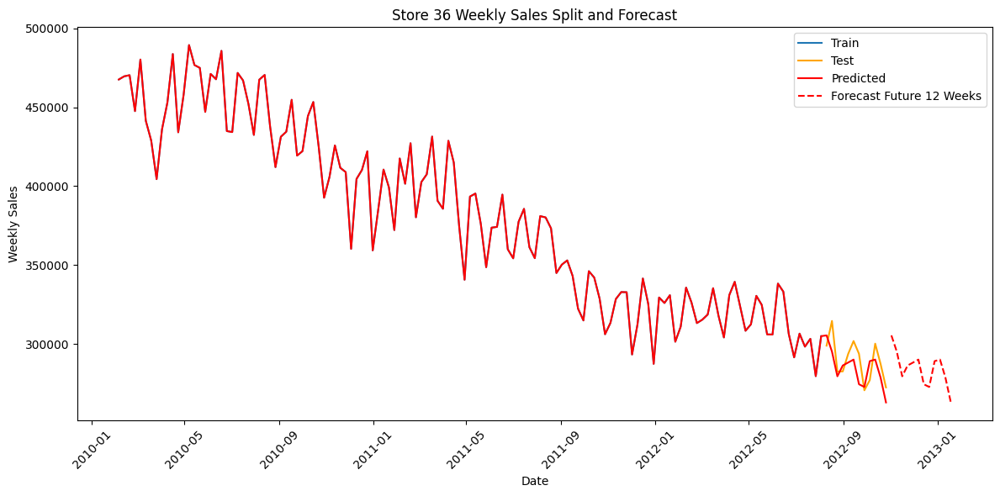

Store 37 -> Train: 131 weeks, Test: 12 weeks
Predicted Boxcox Values are : 2012-08-10    13.139736
2012-08-17    13.139169
2012-08-24    13.179555
2012-08-31    13.180021
2012-09-07    13.158832
2012-09-14    13.157126
2012-09-21    13.153672
2012-09-28    13.183941
2012-10-05    13.184907
2012-10-12    13.154894
2012-10-19    13.172736
2012-10-26    13.171393
Freq: W-FRI, Name: predicted_mean, dtype: float64
summary of the model is :                                      SARIMAX Results                                      
Dep. Variable:                                  y   No. Observations:                  131
Model:             SARIMAX(1, 0, 1)x(1, 0, 1, 52)   Log Likelihood                 237.673
Date:                            Thu, 15 May 2025   AIC                           -465.346
Time:                                    10:13:23   BIC                           -450.970
Sample:                                02-05-2010   HQIC                          -459.504
               

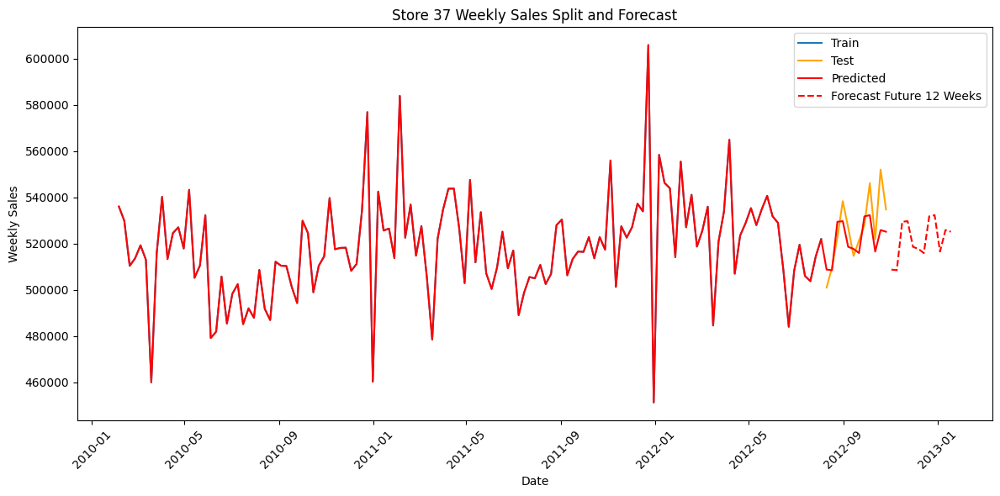

Store 38 -> Train: 131 weeks, Test: 12 weeks
Predicted Boxcox Values are : 2012-08-10    12.981904
2012-08-17    12.940430
2012-08-24    12.937169
2012-08-31    13.047401
2012-09-07    12.986162
2012-09-14    12.996651
2012-09-21    12.976534
2012-09-28    12.977708
2012-10-05    13.051701
2012-10-12    12.989860
2012-10-19    12.993450
2012-10-26    12.970279
Freq: W-FRI, Name: predicted_mean, dtype: float64
summary of the model is :                                      SARIMAX Results                                      
Dep. Variable:                                  y   No. Observations:                  131
Model:             SARIMAX(1, 0, 1)x(1, 0, 1, 52)   Log Likelihood                 190.891
Date:                            Thu, 15 May 2025   AIC                           -371.781
Time:                                    10:13:34   BIC                           -357.405
Sample:                                02-05-2010   HQIC                          -365.940
               

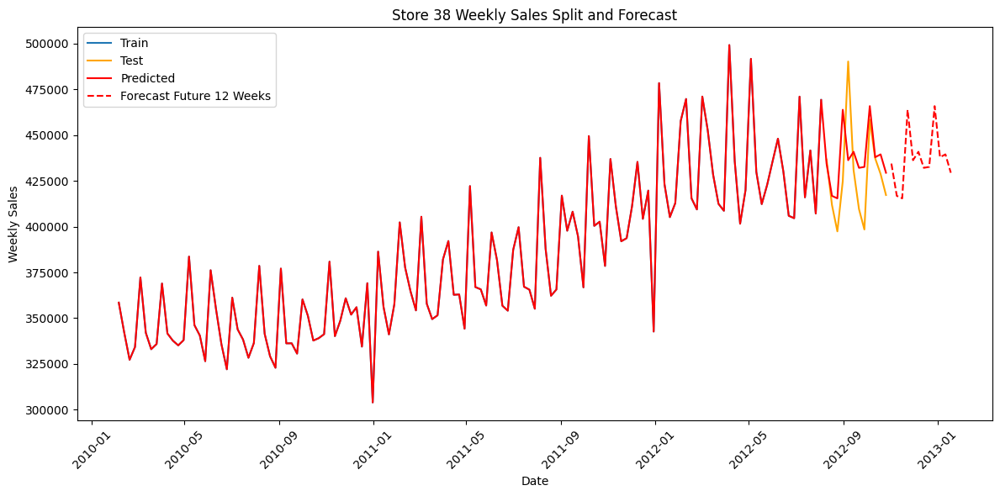

Store 39 -> Train: 131 weeks, Test: 12 weeks
Predicted Boxcox Values are : 2012-08-10    14.288261
2012-08-17    14.355788
2012-08-24    14.321571
2012-08-31    14.262277
2012-09-07    14.227409
2012-09-14    14.197487
2012-09-21    14.165299
2012-09-28    14.162304
2012-10-05    14.233497
2012-10-12    14.195471
2012-10-19    14.231212
2012-10-26    14.245116
Freq: W-FRI, Name: predicted_mean, dtype: float64
summary of the model is :                                      SARIMAX Results                                      
Dep. Variable:                                  y   No. Observations:                  131
Model:             SARIMAX(1, 0, 1)x(1, 0, 1, 52)   Log Likelihood                 149.028
Date:                            Thu, 15 May 2025   AIC                           -288.056
Time:                                    10:13:41   BIC                           -273.680
Sample:                                02-05-2010   HQIC                          -282.215
               

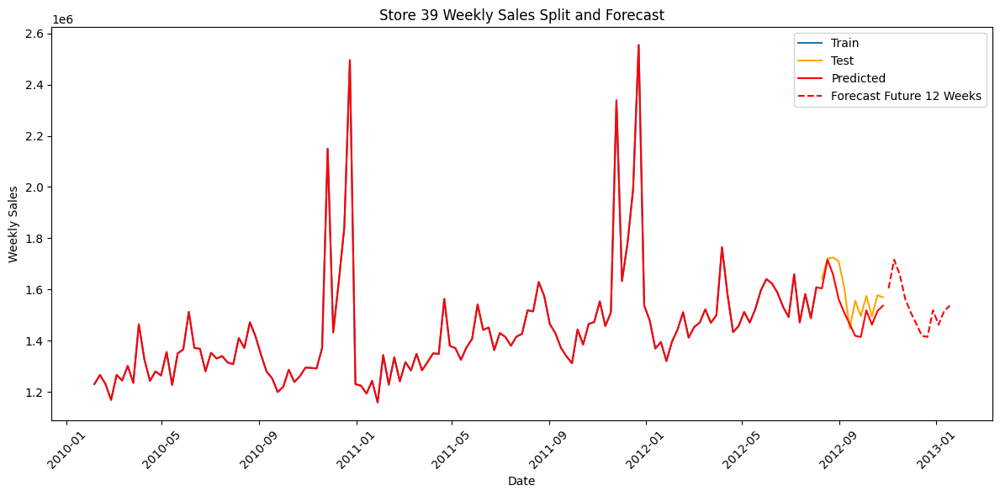

Store 40 -> Train: 131 weeks, Test: 12 weeks
Predicted Boxcox Values are : 2012-08-10    13.775711
2012-08-17    13.773391
2012-08-24    13.781997
2012-08-31    13.801458
2012-09-07    13.829036
2012-09-14    13.705806
2012-09-21    13.692237
2012-09-28    13.736528
2012-10-05    13.854270
2012-10-12    13.762512
2012-10-19    13.747433
2012-10-26    13.743371
Freq: W-FRI, Name: predicted_mean, dtype: float64
summary of the model is :                                      SARIMAX Results                                      
Dep. Variable:                                  y   No. Observations:                  131
Model:             SARIMAX(1, 0, 1)x(1, 0, 1, 52)   Log Likelihood                 146.272
Date:                            Thu, 15 May 2025   AIC                           -282.544
Time:                                    10:13:53   BIC                           -268.168
Sample:                                02-05-2010   HQIC                          -276.702
               

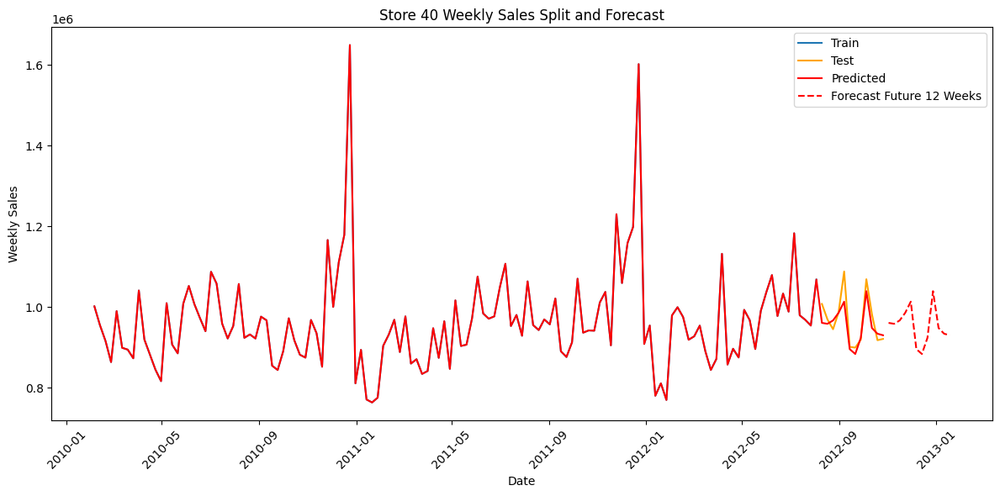

Store 41 -> Train: 131 weeks, Test: 12 weeks
Predicted Boxcox Values are : 2012-08-10    14.168395
2012-08-17    14.198012
2012-08-24    14.183972
2012-08-31    14.118124
2012-09-07    14.135068
2012-09-14    14.070168
2012-09-21    14.043178
2012-09-28    14.029567
2012-10-05    14.135635
2012-10-12    14.114661
2012-10-19    14.070513
2012-10-26    14.138723
Freq: W-FRI, Name: predicted_mean, dtype: float64
summary of the model is :                                      SARIMAX Results                                      
Dep. Variable:                                  y   No. Observations:                  131
Model:             SARIMAX(1, 0, 1)x(1, 0, 1, 52)   Log Likelihood                 148.155
Date:                            Thu, 15 May 2025   AIC                           -286.310
Time:                                    10:14:03   BIC                           -271.934
Sample:                                02-05-2010   HQIC                          -280.468
               

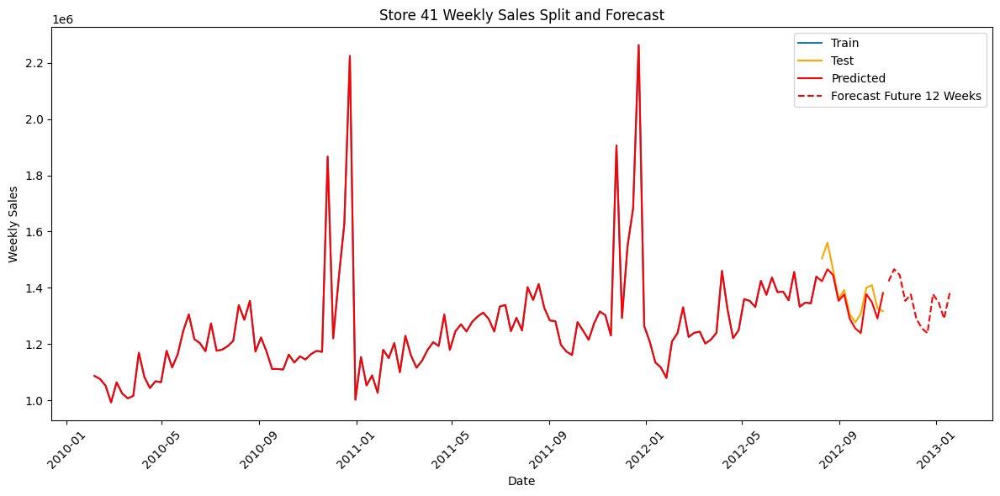

Store 42 -> Train: 131 weeks, Test: 12 weeks
Predicted Boxcox Values are : 2012-08-10    13.348561
2012-08-17    13.210171
2012-08-24    13.154869
2012-08-31    13.240475
2012-09-07    13.357012
2012-09-14    13.288129
2012-09-21    13.203651
2012-09-28    13.175209
2012-10-05    13.398673
2012-10-12    13.338122
2012-10-19    13.237726
2012-10-26    13.176012
Freq: W-FRI, Name: predicted_mean, dtype: float64
summary of the model is :                                      SARIMAX Results                                      
Dep. Variable:                                  y   No. Observations:                  131
Model:             SARIMAX(1, 0, 1)x(1, 0, 1, 52)   Log Likelihood                 190.623
Date:                            Thu, 15 May 2025   AIC                           -371.246
Time:                                    10:14:13   BIC                           -356.870
Sample:                                02-05-2010   HQIC                          -365.404
               

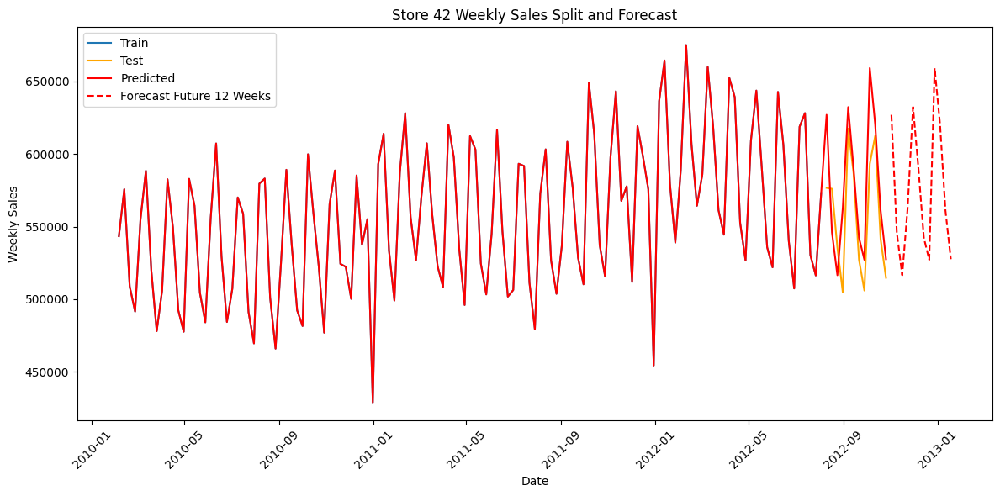

Store 43 -> Train: 131 weeks, Test: 12 weeks
Predicted Boxcox Values are : 2012-08-10    13.339500
2012-08-17    13.386454
2012-08-24    13.279556
2012-08-31    13.324652
2012-09-07    13.382061
2012-09-14    13.362725
2012-09-21    13.295225
2012-09-28    13.275622
2012-10-05    13.372854
2012-10-12    13.328294
2012-10-19    13.320010
2012-10-26    13.259341
Freq: W-FRI, Name: predicted_mean, dtype: float64
summary of the model is :                                      SARIMAX Results                                      
Dep. Variable:                                  y   No. Observations:                  131
Model:             SARIMAX(1, 0, 1)x(1, 0, 1, 52)   Log Likelihood                 205.099
Date:                            Thu, 15 May 2025   AIC                           -400.198
Time:                                    10:14:18   BIC                           -385.822
Sample:                                02-05-2010   HQIC                          -394.356
               

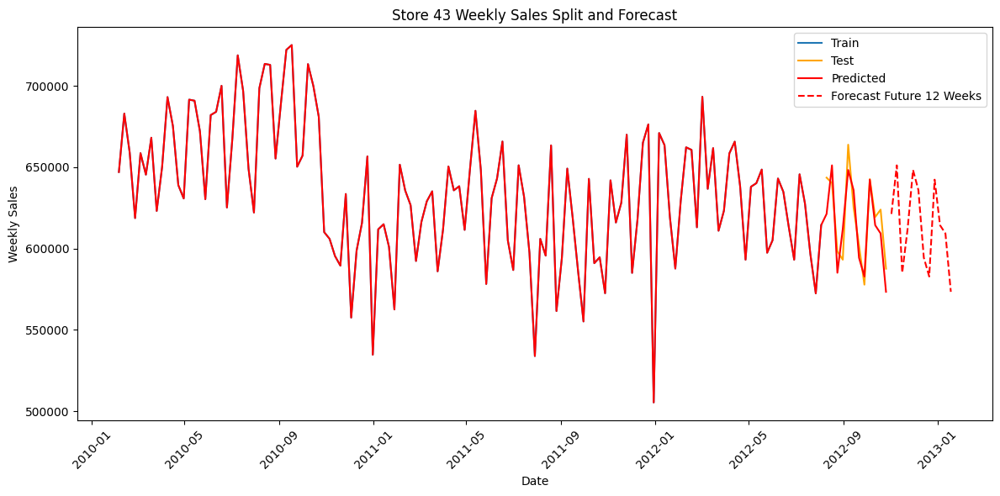

Store 44 -> Train: 131 weeks, Test: 12 weeks
Predicted Boxcox Values are : 2012-08-10    12.706712
2012-08-17    12.717952
2012-08-24    12.827254
2012-08-31    12.770589
2012-09-07    12.737782
2012-09-14    12.774615
2012-09-21    12.783912
2012-09-28    12.726531
2012-10-05    12.804872
2012-10-12    12.748841
2012-10-19    12.795070
2012-10-26    12.770158
Freq: W-FRI, Name: predicted_mean, dtype: float64
summary of the model is :                                      SARIMAX Results                                      
Dep. Variable:                                  y   No. Observations:                  131
Model:             SARIMAX(1, 0, 1)x(1, 0, 1, 52)   Log Likelihood                 203.843
Date:                            Thu, 15 May 2025   AIC                           -397.686
Time:                                    10:14:29   BIC                           -383.310
Sample:                                02-05-2010   HQIC                          -391.844
               

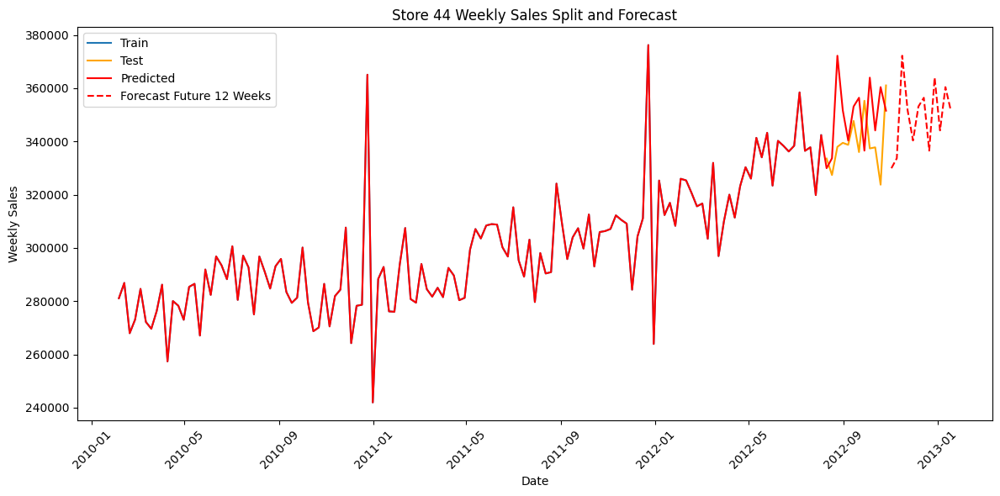

Store 45 -> Train: 131 weeks, Test: 12 weeks
Predicted Boxcox Values are : 2012-08-10    13.506384
2012-08-17    13.489626
2012-08-24    13.574271
2012-08-31    13.549167
2012-09-07    13.520269
2012-09-14    13.494341
2012-09-21    13.470652
2012-09-28    13.468211
2012-10-05    13.540185
2012-10-12    13.499664
2012-10-19    13.542466
2012-10-26    13.549916
Freq: W-FRI, Name: predicted_mean, dtype: float64
summary of the model is :                                      SARIMAX Results                                      
Dep. Variable:                                  y   No. Observations:                  131
Model:             SARIMAX(1, 0, 1)x(1, 0, 1, 52)   Log Likelihood                 122.615
Date:                            Thu, 15 May 2025   AIC                           -235.229
Time:                                    10:14:35   BIC                           -220.853
Sample:                                02-05-2010   HQIC                          -229.388
               

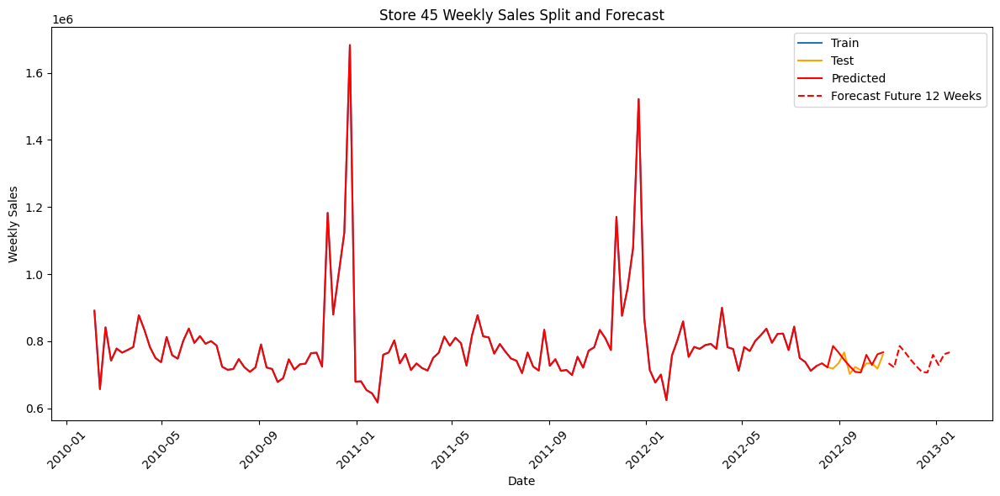

In [125]:
forecast_weeks = 12
result = []

for store_id in df1.index.get_level_values('Store').unique():

  store_data = df1.loc[store_id].sort_index()
# print(type(store_data))

  store_data = store_data.sort_index()

  train = store_data[0:-forecast_weeks]
  test = store_data[-forecast_weeks:]

# print(type(test))
  print(f"Store {store_id} -> Train: {train.shape[0]} weeks, Test: {test.shape[0]} weeks")

  _, metrics = seasonal_prediction(train, test, store_id)
  result.append(metrics)

In [126]:
df_metrics = pd.DataFrame(result)
df_metrics

,Store,MAE,MAPE,MSE,RMSE,R2
0,1,33292.899066,0.021816,1.633124e+09,40411.931239,0.652712
1,2,43097.800829,0.022683,3.460648e+09,58827.268450,0.154217
2,3,9968.395108,0.024757,1.418077e+08,11908.303367,0.277332
3,4,58807.153372,0.027686,5.262854e+09,72545.528414,-0.323612
4,5,8435.041936,0.026251,9.074425e+07,9525.977739,0.638103
5,6,34518.799384,0.022725,1.972047e+09,44407.732261,0.680000
6,7,21885.049337,0.040873,6.172580e+08,24844.677045,0.811770
7,8,34168.105563,0.037178,1.659480e+09,40736.720806,-0.334132
8,9,15118.620561,0.027026,3.735017e+08,19326.193033,0.383428
9,10,49074.249667,0.028195,4.320372e+09,65729.539985,0.043104


In [134]:
lower_performance_stores = df_metrics[(df_metrics['R2'] < 0.5) & (df_metrics['MAPE'] > 0.05)]
lower_performance_stores

,Store,MAE,MAPE,MSE,RMSE,R2
17,18,100421.589542,0.093024,3.429416e+10,185186.822912,-7.885582
22,23,90675.791709,0.063169,1.008334e+10,100415.833243,0.236665
28,29,29411.304578,0.059456,1.437738e+09,37917.509536,0.298710
34,35,114488.702813,0.131776,1.406712e+10,118604.884201,-3.828811


In [135]:
lower_performance_stores['Store'].unique()

array([18, 23, 29, 35])